In [1]:
import pandas as pd
import os
from collections import Counter
import networkx as nx
import matplotlib.pyplot as plt
import re
import seaborn as sns
import numpy as np
#import community as community_louvain
import community
#import Eva
#from cdlib import algorithms, viz, evaluation
'''
import heapq
import random
import warnings
import itertools
warnings.filterwarnings("ignore")
from sklearn.cluster import KMeans 
from sklearn.manifold import TSNE
from graph_tool.all import *
import graph_tool as gt
from graph_tool.inference import *
'''

pd.set_option('display.max_columns', 300)
pd.set_option('display.max_rows', 1000)
#pd.set_option("display.max_colwidth",300)
pd.set_option('display.width',300)

In [2]:
def is_in(full_str, sub_str):
    if re.findall(sub_str, full_str):
        return True
    else:
        return False
def list_con(l_list, rank, thres):
    importance_l = [j[0] for i in l_list for j in i[:rank]]
    return sorted([s for s, c in Counter(importance_l).items() if c>=thres])
def find_nei(G, node):
    nodes = list(nx.nodes(G))
    nei1_l = []
    nei2_l = []
    nei3_l = []
    for FNs in list(nx.neighbors(G, node)):  
        nei1_l.append(FNs)
    nei1_l = sorted(nei1_l)
    for n1 in nei1_l:
        for SNs in list(nx.neighbors(G, n1)):  
            nei2_l.append(SNs)
    nei2_l = sorted(list(set(nei2_l) - set(nei1_l)))
    if node in nei2_l:
        nei2_l.remove(node)
    for n2 in nei2_l:
        for TNs in nx.neighbors(G, n2):
            nei3_l.append(TNs)
    nei3_l = sorted(list(set(nei3_l) - set(nei2_l) - set(nei1_l)))
    if node in nei3_l:
        nei3_l.remove(node)
    return nei1_l, nei2_l, nei3_l

In [3]:
pro_seq = {}
with open('../whole_f.fasta') as f:
    for line in f:
        line = line.strip('\n')
        if line.startswith('>'):
            k = line.split(' ')[0][1: ]
            pro_seq[k] = ''
        else:
            pro_seq[k] += line
id_pro = {}
pro_id = {}
with open('../input/pro_id_t82_re_qf_b.txt') as f:
    for line in f:
        line = line.strip('\n')
        if line.split('\t')[-1] not in id_pro:
            id_pro[line.split('\t')[1]] = []
        id_pro[line.split('\t')[1]].append(line.split('\t')[0])
        pro_id[line.split('\t')[0]] = line.split('\t')[1]
print(len(pro_id))
print(len(id_pro))
id_pro_len = {id:len(pro_list) for id, pro_list in id_pro.items()}
sp_pro = {}
sp_name_list = [i for i in os.listdir('../faa/') if i.endswith('.faa')]
for sp_file in sp_name_list:
    sp_pro[sp_file.split('.')[0]] = []
    with open('../faa/'+ sp_file) as f:
        for line in f:
            if line.startswith('>'):
                sp_pro[sp_file.split('.')[0]].append(line.split(' ')[0][1:])
pro_sp = {pro:sp for sp, pro_list in sp_pro.items() for pro in pro_list }
sp_id = {}
id_sp = {}
for sp, pro_list in sp_pro.items():
    sp_id[sp] = list(set([pro_id[i] for i in pro_list]))
for sp, id_list in sp_id.items():
    for id in id_list:
        if id not in id_sp:
            id_sp[id] = []
        id_sp[id].append(sp)
id_sp = {k:list(set(v)) for k, v in id_sp.items()}
C_id = {}
id_C = {}
with open('../CD/AGE_100_tra_7.txt') as f:
    for line in f:
        line = line.strip('\n')
        id_C[line.split('\t')[0]] = line.split('\t')[1]
        if line.split('\t')[1] not in C_id:
            C_id[line.split('\t')[1]] = [] 
        C_id[line.split('\t')[1]].append(line.split('\t')[0])
        
C_sp = {}
for C, id_list in C_id.items():
    C_sp[C] = list(set([sp for id in id_list for sp in id_sp[id]]))
C_id_len = {C:len(id_list) for C, id_list in C_id.items()}

718579
39094


In [4]:
edge_proid = []
with open('../input/edge_t82_re_qf_b.txt') as f:
    for line in f:
        line = line.strip('\n')
        edge_proid.append([line.split('\t')[0], line.split('\t')[1], float(line.split('\t')[2])])
id_edge_df = pd.read_csv('../input/edge_t82_re_qf_b.txt', sep='\t', header=None)
proid_G = nx.Graph()
proid_G.add_nodes_from(list(id_pro.keys()))
for edge in edge_proid:
    proid_G.add_edge(edge[0], edge[1], weight = edge[2]) 

print('number of edges: ', proid_G.number_of_edges())
print('number of nodes: ', proid_G.number_of_nodes())
    
nx.set_node_attributes(proid_G, id_pro_len, 'gene_num')
nx.set_node_attributes(proid_G, id_C, 'C')


proid_connected_node = list()
for c in nx.connected_components(proid_G):
    nodeSet = proid_G.subgraph(c).nodes()
    proid_connected_node.append(nodeSet)
print('number of subgraph: ', len(proid_connected_node))

number of edges:  85610
number of nodes:  39094
number of subgraph:  1005


In [5]:
id_edge_df[0] = id_edge_df[0].astype('str')
id_edge_df[1] = id_edge_df[1].astype('str')

In [6]:
K_info = {}
with open('../../../KEGG_DATA/K_info.txt') as f:
    for line in f:
        line = line.strip('\n')
        K_info[line.split('\t')[0]] = line.split('\t')[1]
K_ko_dict = {}
with open('../../../KEGG_DATA/KO_ko.txt') as f:
    for line in f:
        line = line.strip('\n')
        K_ko_dict[line.split('\t')[0]] = line.split('\t')[1].split(' ')
ko_module = {}
with open('../../../KEGG_DATA/ko_module.txt') as f:
    for line in f:
        line = line.strip('\n')
        if line.split('\t')[0] not in ko_module:
            ko_module[line.split('\t')[0]] = {}
        ko_module[line.split('\t')[0]][line.split('\t')[1]] = line.split('\t')[2]          
ko_info = {}
with open('../../../KEGG_DATA/pathway_info.txt') as f:
    for line in f:
        line = line.strip('\n')
        ko_info[line.split('\t')[0]] = line.split('\t')[3]
M_info = {}
with open('../../../KEGG_DATA/pathway_module.txt') as f:
    for line in f:
        line = line.strip('\n')
        M_info[line.split('\t')[0][3:]] = line.split('\t')[1]
mis_func = {}
with open('../whole_f.fasta') as f:
    for line in f:
        if line.startswith('>'):
            mis_func[line.split(' ')[0][1:]] = ' '.join(line.split(' [')[0].split(' ')[1:])
pro_K = {}
with open('../Mis_K_ex_high.txt') as f:
    for line in f:
        if line.split('\t')[0] in pro_id:
            key = line.split('\t')[0]
            if (key not in pro_K):
                pro_K[key] = []
            pro_K[key].append(line.split('\t')[1])
id_K = {}
id_K_gene = {}
for id, pro_list in id_pro.items():
    for pro in pro_list:
        if pro in pro_K:
            if id not in id_K:
                id_K[id] = []
                id_K_gene[id] = []
            id_K[id] += pro_K[pro]
            id_K_gene[id] += pro_K[pro]
            id_K[id] = list(set(id_K[id]))
print(len([j for i in id_K_gene.values() for j in i]))
print(len([j for i in id_K.values() for j in i]))

id_ko = {}
id_ko_gene = {}
for  id, K_list in id_K.items():
    for K in K_list:
        if K in K_ko_dict:
            if id not in id_ko:
                id_ko[id] = []
                id_ko_gene[id] = []
            id_ko[id] += K_ko_dict[K]
            id_ko[id] = list(set(id_ko[id]))    
for  id, K_list in id_K_gene.items():
    for K in K_list:
        if K in K_ko_dict:
            if id not in id_ko_gene:
                id_ko_gene[id] = []
            id_ko_gene[id] += K_ko_dict[K]
            
print(len(set([j for i in id_ko_gene.values() for j in i])))
print(len([j for i in id_ko.values() for j in i]))

id_Mo = {}
id_Mo_gene = {}
for id, ko_list in id_ko.items():
    for ko in ko_list:
        if ko in ko_module:
            if id not in id_Mo:
                id_Mo[id] = []
            id_Mo[id] += ko_module[ko]
            id_Mo[id] = list(set(id_Mo[id]))
for  id, ko_list in id_ko_gene.items():
    for ko in ko_list:
        if ko in ko_module:
            if id not in id_Mo_gene:
                id_Mo_gene[id] = []
            id_Mo_gene[id] += ko_module[ko]
            
print(len(set([j for i in id_Mo_gene.values() for j in i])))
print(len([j for i in id_Mo.values() for j in i]))

317153
6139
288
4520
379
12305


In [7]:
C_K = {}
C_K_id = {}
C_K_gene = {}
for  C, id_list in C_id.items():
    for id in id_list:
        if id in id_K:
            if C not in C_K:
                C_K[C] = []
                C_K_id[C] = []
                C_K_gene[C] = []
            C_K[C] += id_K[id]
            C_K_id[C] += id_K[id]
            C_K_gene[C] += id_K_gene[id]
            C_K[C] = list(set(C_K[C]))
print(len(set([j for i in C_K_gene.values() for j in i])))
print(len([j for i in C_K_id.values() for j in i]))
print(len([j for i in C_K.values() for j in i]))
C_ko = {}
C_ko_id = {}
C_ko_gene = {}
for  C, K_list in C_K.items():
    for K in K_list:
        if K in K_ko_dict:
            if C not in C_ko:
                C_ko[C] = []
                C_ko_id[C] = []
                C_ko_gene[C] = []
            C_ko[C] += K_ko_dict[K]
            C_ko[C] = list(set(C_ko[C]))    
for  C, K_list in C_K_id.items():
    for K in K_list:
        if K in K_ko_dict:
            if C not in C_ko_id:
                C_ko_id[C] = []
            C_ko_id[C] += K_ko_dict[K]
for  C, K_list in C_K_gene.items():
    for K in K_list:
        if K in K_ko_dict:
            if C not in C_ko_gene:
                C_ko_gene[C] = []
            C_ko_gene[C] += K_ko_dict[K]
            
print(len(set([j for i in C_ko_gene.values() for j in i])))
print(len([j for i in C_ko_id.values() for j in i]))
print(len([j for i in C_ko.values() for j in i]))
C_Mo = {}
C_Mo_id = {}
C_Mo_gene = {}
for C, ko_list in C_ko.items():
    for ko in ko_list:
        if ko in ko_module:
            if C not in C_Mo:
                C_Mo[C] = []
            C_Mo[C] += ko_module[ko]
            C_Mo[C] = list(set(C_Mo[C]))
for  C, ko_list in C_ko_id.items():
    for ko in ko_list:
        if ko in ko_module:
            if C not in C_Mo_id:
                C_Mo_id[C] = []
            C_Mo_id[C] +=ko_module[ko]
for  C, ko_list in C_ko_gene.items():
    for ko in ko_list:
        if ko in ko_module:
            if C not in C_Mo_gene:
                C_Mo_gene[C] = []
            C_Mo_gene[C] += ko_module[ko]
            
print(len(set([j for i in C_Mo_gene.values() for j in i])))
print(len([j for i in C_Mo_id.values() for j in i]))
print(len([j for i in C_Mo.values() for j in i]))
C_pro = {C:[pro for id in id_list for pro in id_pro[id] ] for C, id_list in C_id.items()}
C_fun = {C:list(set([mis_func[pro] for pro in pro_list if 'hypothetical protein' not in mis_func[pro]])) for C, pro_list in C_pro.items()}

1932
6139
6004
288
4712
4267
379
13036
11309


In [8]:
PPI_id_df = pd.read_csv('../node_link_mis_multi_edge.txt', sep='\t', header=None)
PPI_id_df['node1'] = PPI_id_df.loc[:, [0,1]].min(axis=1).astype('str')
PPI_id_df['node2'] = PPI_id_df.loc[:, [0,1]].max(axis=1).astype('str')
PPI_id_df = PPI_id_df.loc[:, ['node1', 'node2', 2]].rename(columns={2:'weight'})
PPI_id_df['C_1'] = PPI_id_df['node1'].apply(lambda x: id_C[str(x)])
PPI_id_df['C_2'] = PPI_id_df['node2'].apply(lambda x: id_C[str(x)])
PPI_id_df['K_1'] = PPI_id_df['node1'].apply(lambda x: ','.join(id_K[str(x)]) if str(x) in id_K else '')
PPI_id_df['K_2'] = PPI_id_df['node2'].apply(lambda x: ','.join(id_K[str(x)]) if str(x) in id_K else '')
PPI_id_df['ko_1'] = PPI_id_df['node1'].apply(lambda x: ','.join(id_ko[str(x)]) if str(x) in id_ko else '')
PPI_id_df['ko_2'] = PPI_id_df['node2'].apply(lambda x: ','.join(id_ko[str(x)]) if str(x) in id_ko else '')
PPI_id_df['M_1'] = PPI_id_df['node1'].apply(lambda x: ','.join(id_Mo[str(x)]) if str(x) in id_Mo else '')
PPI_id_df['M_2'] = PPI_id_df['node2'].apply(lambda x: ','.join(id_Mo[str(x)]) if str(x) in id_Mo else '')
PPI_id_df = PPI_id_df[PPI_id_df['node1'] != PPI_id_df['node2']]
PPI_id_df = PPI_id_df.drop_duplicates(subset=['node1', 'node2']).reset_index(drop=True)
#PPI_id_df['label1'] =  PPI_id_df['node1'].apply(lambda x:','.join(label_dict[str(x)]) if str(x) in label_dict else '')
#PPI_id_df['label2'] =  PPI_id_df['node2'].apply(lambda x:','.join(label_dict[str(x)]) if str(x) in label_dict else '')

In [9]:
PPI_C_df = pd.read_csv('PPI_C_stat_d.csv', sep='\t')
PPI_C_df

,C_1,C_2,count,C_1_len,C_2_len,C_1_loop,C_2_loop,C_1_outer,C_2_outer
0,0,0,6,22,22,6,6,2890,2890
1,0,1,4,22,2,6,0,2890,446
2,0,2,2,22,5,6,2,2890,1414
3,0,3,8,22,18,6,42,2890,4496
4,0,4,10,22,85,6,2,2890,2664
...,...,...,...,...,...,...,...,...,...
558107,9741,3959,2,1,4,0,0,986,894
558108,9741,6822,2,1,3,0,0,986,596
558109,9741,7333,2,1,1,0,0,986,240
558110,9741,8253,2,1,2,0,2,986,1502


In [10]:
label_dict = {}
with open('label_dict.t.txt') as f:
    for line in f:
        line = line.strip('\n')
        label_dict[line.split('\t')[0]] = line.split('\t')[1].split(',')

### 芳香族代谢 XM

In [12]:
pro_XM_dict = {}
with open('../function/XM_mis.fasta') as f:
    for line in f:
        line = line.strip('\n')
        if line.startswith('>'):
            pro_XM_dict[line[1:]] = pro_K[line[1:]]

In [13]:
id_XM_dict = {}
for k, v in pro_XM_dict.items():
    if pro_id[k] not in id_XM_dict:
        id_XM_dict[pro_id[k]] = []
    id_XM_dict[pro_id[k]]  = list(set(v+id_XM_dict[pro_id[k]]))
id_XM_dict = {k:v if len(v) != 0 else ['XM?'] for k, v in id_XM_dict.items()}
XM_id_origin = list(id_XM_dict.keys())
C_XM_dict = {}
C_XM_value_dict = {}
C_XM_count_dict = {}
for k, v in id_XM_dict.items():
    if id_C[k] not in C_XM_dict:
        C_XM_dict[id_C[k]] = []
        C_XM_value_dict[id_C[k]] = []
    C_XM_dict[id_C[k]] = list(set(C_XM_dict[id_C[k]] + v))
    C_XM_value_dict[id_C[k]] = C_XM_value_dict[id_C[k]] + v
C_XM_count_dict = {k:dict(Counter(v)) for k, v in C_XM_value_dict.items()}
print('XM pro count: ', len(pro_XM_dict))
print('XM node count: ',len(id_XM_dict))
print('XM C count: ',len(C_XM_dict))

XM_pred_df = pd.read_csv('../function/XM_pred.txt', sep='\t', header=None)
XM_pred_df = XM_pred_df[XM_pred_df[1].isin(pro_XM_dict)]
XM_pred_df['id_1'] = XM_pred_df[0].apply(lambda x:pro_id[x])
XM_pred_df['id_2'] = XM_pred_df[1].apply(lambda x:pro_id[x])
XM_pred_df['func'] = XM_pred_df[1].apply(lambda x: pro_XM_dict[x])
XM_pred_f_df = XM_pred_df[~(XM_pred_df['id_1'].isin(XM_id_origin))].loc[:, ['id_1','id_2','func']].drop_duplicates(subset=['id_1','id_2'])
id_XM_pred_dict = XM_pred_f_df.set_index('id_1').to_dict()['func']
id_XM_pred_dict = {k:v if len(v) != 0 else ['XM?'] for k, v in id_XM_pred_dict.items()}
#id_XM_dict.update(id_XM_pred_dict)

XM_node_origin = XM_id_origin
XM_edge_origin = id_edge_df[(id_edge_df[0].isin(XM_node_origin))&(id_edge_df[1].isin(XM_node_origin))].set_index([0,1]).to_dict()[2]
XM_node_ex = list(id_XM_pred_dict.keys())
XM_node_t = list(id_XM_dict.keys()) + list(id_XM_pred_dict.keys())
XM_edge_t_df = id_edge_df[(id_edge_df[0].isin(XM_node_t))&(id_edge_df[1].isin(XM_node_t))]
XM_edge_t = XM_edge_t_df.set_index([0,1]).to_dict()[2]
XM_edge_pre = XM_edge_t_df[(XM_edge_t_df[0].isin(XM_node_ex))|(XM_edge_t_df[1].isin(XM_node_ex))].set_index([0,1]).to_dict()[2]

XM_C = list(C_XM_dict.keys())
XM_node_oC= [j for i in XM_C for j in C_id[i] if j not in XM_node_origin]
XM_node_tC = [j for i in XM_C for j in C_id[i] if j not in XM_node_t]
XM_edge_df = id_edge_df[(id_edge_df[0].isin(XM_node_origin+XM_node_oC))&(id_edge_df[1].isin(XM_node_origin+XM_node_oC))]
XM_edge = XM_edge_df[(XM_edge_df[0].isin(XM_node_oC))|(XM_edge_df[1].isin(XM_node_oC))].set_index([0,1]).to_dict()[2]
XM_edge_ex_df = id_edge_df[(id_edge_df[0].isin(XM_node_t+XM_node_tC))&(id_edge_df[1].isin(XM_node_t+XM_node_tC))]
XM_edge_ex = XM_edge_ex_df[(XM_edge_ex_df[0].isin(XM_node_tC))|(XM_edge_ex_df[1].isin(XM_node_tC))].set_index([0,1]).to_dict()[2]
XM_C_t = list(set([id_C[i] for i in XM_node_t]))
print('XM ex C count: ',len(XM_C_t))
print('origin node: ', len(XM_node_origin))
print('total node: ', len(XM_node_t))
print('origin edge: ', len(XM_edge_origin))
print('extend edge: ', len(XM_edge_pre))
print('total edge: ', len(XM_edge_t_df))
print('origin C nei node: ', len(XM_node_oC))
print('origin C nei edge: ', len(XM_edge_df))
print('total C nei node: ', len(XM_node_tC))
print('total C nei edge: ', len(XM_edge_ex_df))

XM_node_onei = list(set([nei for node in XM_node_origin for nei in find_nei(proid_G, node)[0]]) - set(XM_node_origin))
XM_node_tnei = list(set([nei for node in XM_node_t for nei in find_nei(proid_G, node)[0]]) - set(XM_node_t))
XM_edge_onei_df = id_edge_df[(id_edge_df[0].isin(XM_node_origin+XM_node_onei))&(id_edge_df[1].isin(XM_node_origin+XM_node_onei))]
#XM_edge_onei = XM_edge_onei_df[XM_edge_onei_df[0].isin(XM_node_onei) | XM_edge_onei_df[1].isin(XM_node_onei)].set_index([0,1]).to_dict()[2]
XM_edge_tnei_df = id_edge_df[(id_edge_df[0].isin(XM_node_t+XM_node_tnei))&(id_edge_df[1].isin(XM_node_t+XM_node_tnei))]
#XM_edge_tnei = XM_edge_tnei_df[XM_edge_tnei_df[0].isin(XM_node_tnei) | XM_edge_tnei_df[1].isin(XM_node_tnei)].set_index([0,1]).to_dict()[2]
XM_GC_t =list(set([id_C[i] for i in XM_node_t+XM_node_tnei]))
print('origin  nei node: ', len(XM_node_onei))
print('origin  nei edge: ', len(XM_edge_onei_df))
print('total  nei node: ', len(XM_node_tnei))
print('total  nei edge: ', len(XM_edge_tnei_df))

XM_PPI_o_df = PPI_id_df[(PPI_id_df['node1'].isin(XM_node_origin))&(PPI_id_df['node2'].isin(XM_node_origin))]
XM_PPI_t_df = PPI_id_df[(PPI_id_df['node1'].isin(XM_node_t))&(PPI_id_df['node2'].isin(XM_node_t))]
XM_node_o_PPI = list(set(XM_PPI_o_df['node1'].tolist() + XM_PPI_o_df['node2'].tolist()))
XM_node_t_PPI = list(set(XM_PPI_t_df['node1'].tolist() + XM_PPI_t_df['node2'].tolist()))
print('PPI orign node: ', len(XM_node_o_PPI))
print('PPI total node: ', len(XM_node_t_PPI))
print('PPI orign edge: ', len(XM_PPI_o_df))
print('PPI total edge: ', len(XM_PPI_t_df)) 
id_XM_t_dict = {k:id_XM_dict[k] if k in id_XM_dict else id_XM_pred_dict[k] for k in XM_node_t}
id_XM_dict_G = {k:','.join(v) + ' **' if int(k) in XM_node_t_PPI  else ','.join(v) for k, v in id_XM_t_dict.items()}

XM pro count:  2308
XM node count:  37
XM C count:  36
XM ex C count:  41
origin node:  37
total node:  42
origin edge:  1
extend edge:  1
total edge:  2
origin C nei node:  195
origin C nei edge:  139
total C nei node:  195
total C nei edge:  142
origin  nei node:  313
origin  nei edge:  652
total  nei node:  313
total  nei edge:  656
PPI orign node:  12
PPI total node:  12
PPI orign edge:  15
PPI total edge:  15


number of nodes:  42
number of edges:  2
number of subgraXM:  40


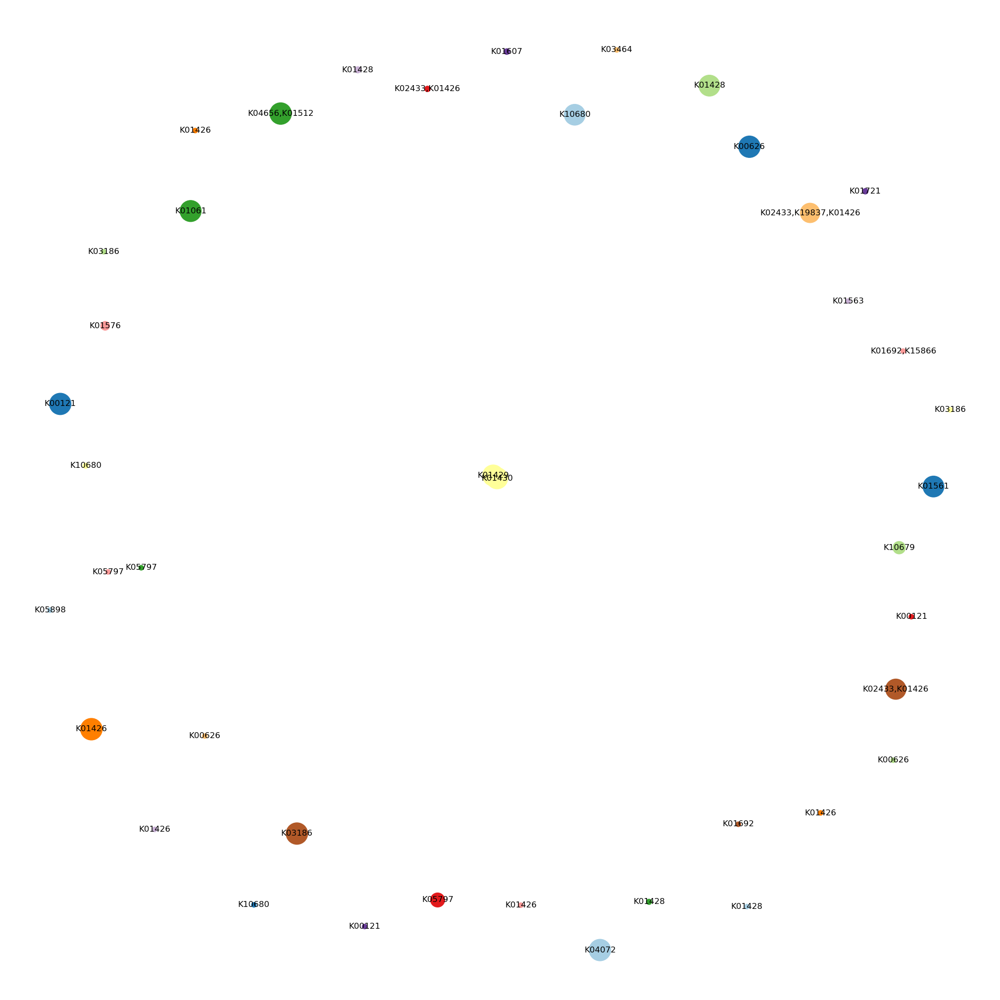

In [14]:
XM_G = nx.Graph()
XM_G.add_nodes_from(XM_node_t) 
#XM_G.add_nodes_from(XM_node_tnei) 
XM_weight_min = min(list(XM_edge_t.values()) + list(XM_edge_ex.values())) #list(XM_edge_tnei.values())
XM_weight_max = max(list(XM_edge_t.values()) + list(XM_edge_ex.values())) #+ list(XM_edge_tnei.values())
XM_node_min = min([id_pro_len[i] for i in (XM_node_t + XM_node_tC)]) #+ XM_node_tnei
XM_node_max = max([id_pro_len[i] for i in (XM_node_t + XM_node_tC)]) #+ XM_node_tnei
#XM_node_max = min(162, max([id_pro_len[i] for i in (XM_node_t + XM_node_tnei + XM_node_tC)]))
for edge, w in XM_edge_origin.items():
    XM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl='o') 
for edge, w in XM_edge_pre.items():
    XM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'e') 
#for edge, w in XM_edge_ex.items():
    #XM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'C') 
#for edge, w in XM_edge_tnei.items():
#    XM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'n') 
    
nx.set_node_attributes(XM_G, id_XM_dict_G, 'fun_name')
nx.set_node_attributes(XM_G, id_C, 'C')
nx.set_node_attributes(XM_G, id_pro_len, 'pro_len')
#nx.set_node_attributes(XM_G, id_type, 'C_type')
node_labels = nx.get_node_attributes(XM_G, 'fun_name')
print('number of nodes: ', XM_G.number_of_nodes())
print('number of edges: ', XM_G.number_of_edges())

eorigin=[(u,v) for (u,v,d) in XM_G.edges(data=True) if d['cl'] == 'o']
eex=[(u,v) for (u,v,d) in XM_G.edges(data=True) if d['cl'] == 'e']
eC=[(u,v) for (u,v,d) in XM_G.edges(data=True) if d['cl'] == 'C']
enei=[(u,v) for (u,v,d) in XM_G.edges(data=True) if d['cl'] == 'n']

XM_G_connected_node = list()
for c in nx.connected_components(XM_G):
    nodeSet = XM_G.subgraph(c).nodes()
    XM_G_connected_node.append(nodeSet)
print('number of subgraXM: ', len(XM_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(XM_C_t)) 
node_color = [color_palette[XM_C_t.index(node[1]['C'])] for node in XM_G.nodes()(data=True)]
node_size = [50 + 950*(node[1]['pro_len'] - XM_node_min)/(XM_node_max - XM_node_min)  for node in XM_G.nodes()(data=True)]
pos = nx.spring_layout(XM_G, k=0.2) #,iterations=50
#pos = nx.kamada_kawai_layout(XM_G)
width_normal = [1 + 5*(float(abs(d['weight'])) - XM_weight_min)/(XM_weight_max -XM_weight_min) for (u,v,d) in XM_G.edges()(data=True)]
nx.draw(XM_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        edgelist=eorigin,
        node_color=node_color,
        width=width_normal
       )
#nx.draw_networkx_edge_labels(XM_pred_G, pos, label_pos=0.5,  rotate=False, font_size=8)
#nx.draw_networkx_edges(XM_G,pos,edgelist=eex,style = ':',
#                      width= width_normal, alpha=1
#                      )
#nx.draw_networkx_edges(XM_G,pos,edgelist=eC,style = '--',
#                      width= width_normal, alpha=1
#                      )
#nx.draw_networkx_edges(XM_G,pos,edgelist=enei,style = '--',
 #                     width= width_normal, alpha=0.8
 #                     )

number of nodes:  59
number of edges:  120
number of PPI C:  16
number of subgraXM:  3


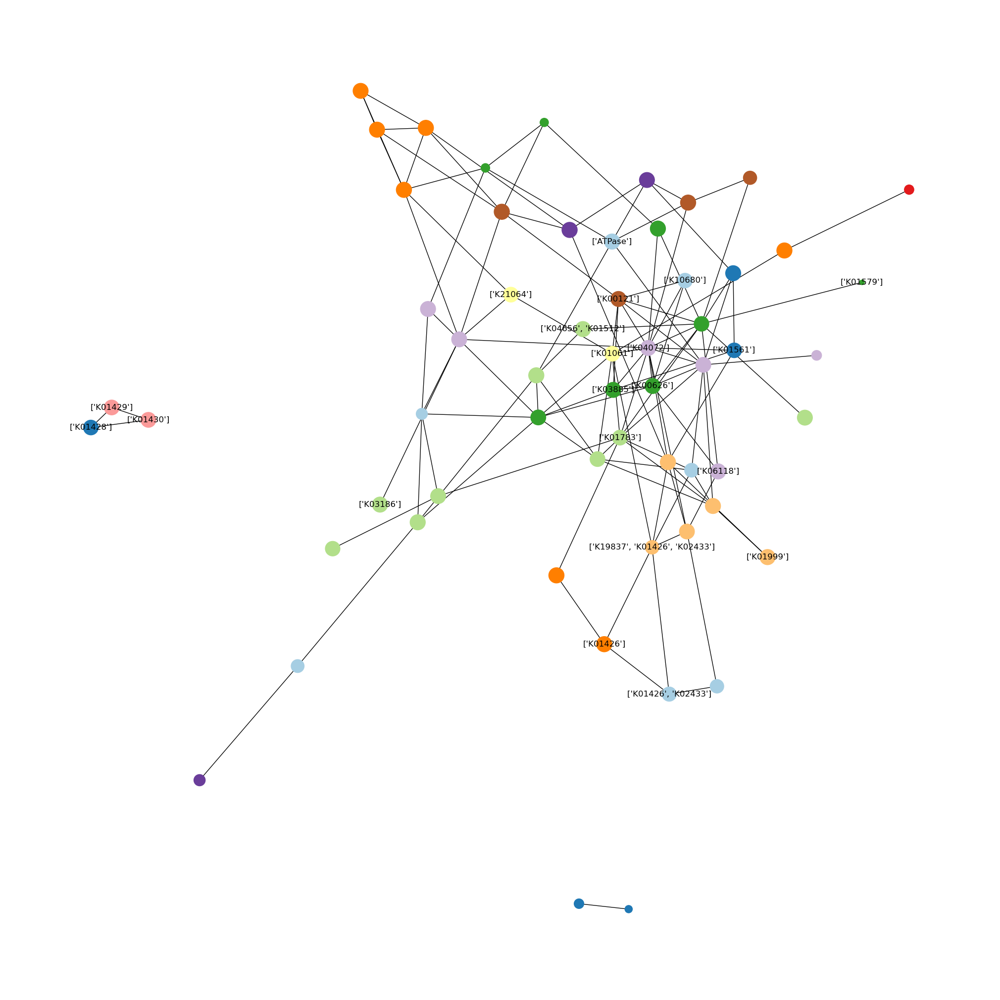

In [15]:
PPI_id_XM_df = PPI_id_df[(PPI_id_df['C_1'].isin(XM_C_t)) & (PPI_id_df['C_2'].isin(XM_C_t))].reset_index(drop=True)
XM_C_PPI_edge_t = PPI_id_XM_df.set_index(['node1','node2']).to_dict()['weight']
XM_C_PPI_node = list(set([str(i) for i in PPI_id_XM_df['node1'].tolist()] + [str(i) for i in PPI_id_XM_df['node2'].tolist()]))
XM_C_PPI_t = list(set([id_C[i] for i in XM_C_PPI_node]))
XM_PPI_G = nx.Graph()
#XM_PPI_G.add_nodes_from(XM_C_PPI_node) 
XM_PPI_node_min = min([id_pro_len[i] for i in (XM_C_PPI_node)])
XM_PPI_node_max = max([id_pro_len[i] for i in (XM_C_PPI_node)]) 
for edge, w in XM_C_PPI_edge_t.items():
    XM_PPI_G.add_edge(str(edge[0]), str(edge[1]), weight = w)   
nx.set_node_attributes(XM_PPI_G, label_dict, 'fun_name')
nx.set_node_attributes(XM_PPI_G, id_C, 'C')
nx.set_node_attributes(XM_PPI_G, id_pro_len, 'pro_len')
node_labels = nx.get_node_attributes(XM_PPI_G, 'fun_name')
print('number of nodes: ', XM_PPI_G.number_of_nodes())
print('number of edges: ', XM_PPI_G.number_of_edges())
print('number of PPI C: ', len(XM_C_PPI_t))


XM_PPI_G_connected_node = list()
for c in nx.connected_components(XM_PPI_G):
    nodeSet = XM_PPI_G.subgraph(c).nodes()
    XM_PPI_G_connected_node.append(nodeSet)
print('number of subgraXM: ', len(XM_PPI_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(XM_C_PPI_t)) 
node_color = [color_palette[XM_C_PPI_t.index(node[1]['C'])] for node in XM_PPI_G.nodes()(data=True)]
node_size = [50 + 450*(node[1]['pro_len'] - XM_PPI_node_min)/(XM_PPI_node_max - XM_PPI_node_min)  for node in XM_PPI_G.nodes()(data=True)]
pos = nx.spring_layout(XM_PPI_G, k=2) #,iterations=50
#pos = nx.kamada_kawai_layout(XM_PPI_G)
nx.draw(XM_PPI_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        node_color=node_color,
       )

### 脂肪酸代谢 FAM

In [16]:
pro_FAM_dict = {}
with open('../function/FAM_mis.fasta') as f:
    for line in f:
        line = line.strip('\n')
        if line.startswith('>'):
            pro_FAM_dict[line[1:]] = pro_K[line[1:]]
id_FAM_dict = {}
for k, v in pro_FAM_dict.items():
    if pro_id[k] not in id_FAM_dict:
        id_FAM_dict[pro_id[k]] = []
    id_FAM_dict[pro_id[k]]  = list(set(v+id_FAM_dict[pro_id[k]]))
id_FAM_dict = {k:v if len(v) != 0 else ['FAM?'] for k, v in id_FAM_dict.items()}
FAM_id_origin = list(id_FAM_dict.keys())
C_FAM_dict = {}
C_FAM_value_dict = {}
C_FAM_count_dict = {}
for k, v in id_FAM_dict.items():
    if id_C[k] not in C_FAM_dict:
        C_FAM_dict[id_C[k]] = []
        C_FAM_value_dict[id_C[k]] = []
    C_FAM_dict[id_C[k]] = list(set(C_FAM_dict[id_C[k]] + v))
    C_FAM_value_dict[id_C[k]] = C_FAM_value_dict[id_C[k]] + v
C_FAM_count_dict = {k:dict(Counter(v)) for k, v in C_FAM_value_dict.items()}
print('FAM pro count: ', len(pro_FAM_dict))
print('FAM node count: ',len(id_FAM_dict))
print('FAM C count: ',len(C_FAM_dict))

FAM_pred_df = pd.read_csv('../function/FAM_pred.txt', sep='\t', header=None)
FAM_pred_df = FAM_pred_df[FAM_pred_df[1].isin(pro_FAM_dict)]
FAM_pred_df['id_1'] = FAM_pred_df[0].apply(lambda x:pro_id[x])
FAM_pred_df['id_2'] = FAM_pred_df[1].apply(lambda x:pro_id[x])
FAM_pred_df['func'] = FAM_pred_df[1].apply(lambda x: pro_FAM_dict[x])
FAM_pred_f_df = FAM_pred_df[~(FAM_pred_df['id_1'].isin(FAM_id_origin))].loc[:, ['id_1','id_2','func']].drop_duplicates(subset=['id_1','id_2'])
id_FAM_pred_dict = FAM_pred_f_df.set_index('id_1').to_dict()['func']
id_FAM_pred_dict = {k:v if len(v) != 0 else ['FAM?'] for k, v in id_FAM_pred_dict.items()}
#id_FAM_dict.update(id_FAM_pred_dict)

FAM_node_origin = FAM_id_origin
FAM_edge_origin = id_edge_df[(id_edge_df[0].isin(FAM_node_origin))&(id_edge_df[1].isin(FAM_node_origin))].set_index([0,1]).to_dict()[2]
FAM_node_ex = list(id_FAM_pred_dict.keys())
FAM_node_t = list(id_FAM_dict.keys()) + list(id_FAM_pred_dict.keys())
FAM_edge_t_df = id_edge_df[(id_edge_df[0].isin(FAM_node_t))&(id_edge_df[1].isin(FAM_node_t))]
FAM_edge_t = FAM_edge_t_df.set_index([0,1]).to_dict()[2]
FAM_edge_pre = FAM_edge_t_df[(FAM_edge_t_df[0].isin(FAM_node_ex))|(FAM_edge_t_df[1].isin(FAM_node_ex))].set_index([0,1]).to_dict()[2]

FAM_C = list(C_FAM_dict.keys())
FAM_node_oC= [j for i in FAM_C for j in C_id[i] if j not in FAM_node_origin]
FAM_node_tC = [j for i in FAM_C for j in C_id[i] if j not in FAM_node_t]
FAM_edge_df = id_edge_df[(id_edge_df[0].isin(FAM_node_origin+FAM_node_oC))&(id_edge_df[1].isin(FAM_node_origin+FAM_node_oC))]
FAM_edge = FAM_edge_df[(FAM_edge_df[0].isin(FAM_node_oC))|(FAM_edge_df[1].isin(FAM_node_oC))].set_index([0,1]).to_dict()[2]
FAM_edge_ex_df = id_edge_df[(id_edge_df[0].isin(FAM_node_t+FAM_node_tC))&(id_edge_df[1].isin(FAM_node_t+FAM_node_tC))]
FAM_edge_ex = FAM_edge_ex_df[(FAM_edge_ex_df[0].isin(FAM_node_tC))|(FAM_edge_ex_df[1].isin(FAM_node_tC))].set_index([0,1]).to_dict()[2]
FAM_C_t = list(set([id_C[i] for i in FAM_node_t]))
print('FAM ex C count: ',len(FAM_C_t))
print('origin node: ', len(FAM_node_origin))
print('total node: ', len(FAM_node_t))
print('origin edge: ', len(FAM_edge_origin))
print('extend edge: ', len(FAM_edge_pre))
print('total edge: ', len(FAM_edge_t_df))
print('origin C nei node: ', len(FAM_node_oC))
print('origin C nei edge: ', len(FAM_edge_df))
print('total C nei node: ', len(FAM_node_tC))
print('total C nei edge: ', len(FAM_edge_ex_df))

FAM_node_onei = list(set([nei for node in FAM_node_origin for nei in find_nei(proid_G, node)[0]]) - set(FAM_node_origin))
FAM_node_tnei = list(set([nei for node in FAM_node_t for nei in find_nei(proid_G, node)[0]]) - set(FAM_node_t))
FAM_edge_onei_df = id_edge_df[(id_edge_df[0].isin(FAM_node_origin+FAM_node_onei))&(id_edge_df[1].isin(FAM_node_origin+FAM_node_onei))]
#FAM_edge_onei = FAM_edge_onei_df[FAM_edge_onei_df[0].isin(FAM_node_onei) | FAM_edge_onei_df[1].isin(FAM_node_onei)].set_index([0,1]).to_dict()[2]
FAM_edge_tnei_df = id_edge_df[(id_edge_df[0].isin(FAM_node_t+FAM_node_tnei))&(id_edge_df[1].isin(FAM_node_t+FAM_node_tnei))]
#FAM_edge_tnei = FAM_edge_tnei_df[FAM_edge_tnei_df[0].isin(FAM_node_tnei) | FAM_edge_tnei_df[1].isin(FAM_node_tnei)].set_index([0,1]).to_dict()[2]
FAM_GC_t =list(set([id_C[i] for i in FAM_node_t+FAM_node_tnei]))
print('origin  nei node: ', len(FAM_node_onei))
print('origin  nei edge: ', len(FAM_edge_onei_df))
print('total  nei node: ', len(FAM_node_tnei))
print('total  nei edge: ', len(FAM_edge_tnei_df))

FAM_PPI_o_df = PPI_id_df[(PPI_id_df['node1'].isin(FAM_node_origin))&(PPI_id_df['node2'].isin(FAM_node_origin))]
FAM_PPI_t_df = PPI_id_df[(PPI_id_df['node1'].isin(FAM_node_t))&(PPI_id_df['node2'].isin(FAM_node_t))]
FAM_node_o_PPI = list(set(FAM_PPI_o_df['node1'].tolist() + FAM_PPI_o_df['node2'].tolist()))
FAM_node_t_PPI = list(set(FAM_PPI_t_df['node1'].tolist() + FAM_PPI_t_df['node2'].tolist()))
print('PPI orign node: ', len(FAM_node_o_PPI))
print('PPI total node: ', len(FAM_node_t_PPI))
print('PPI orign edge: ', len(FAM_PPI_o_df))
print('PPI total edge: ', len(FAM_PPI_t_df)) 
id_FAM_t_dict = {k:id_FAM_dict[k] if k in id_FAM_dict else id_FAM_pred_dict[k] for k in FAM_node_t}
id_FAM_dict_G = {k:','.join(v) + ' **' if int(k) in FAM_node_t_PPI  else ','.join(v) for k, v in id_FAM_t_dict.items()}

FAM pro count:  2469
FAM node count:  42
FAM C count:  40
FAM ex C count:  63
origin node:  42
total node:  70
origin edge:  1
extend edge:  13
total edge:  14
origin C nei node:  405
origin C nei edge:  368
total C nei node:  402
total C nei edge:  382
origin  nei node:  273
origin  nei edge:  580
total  nei node:  331
total  nei edge:  721
PPI orign node:  16
PPI total node:  20
PPI orign edge:  94
PPI total edge:  116


number of nodes:  70
number of edges:  14
number of subgraFAM:  57


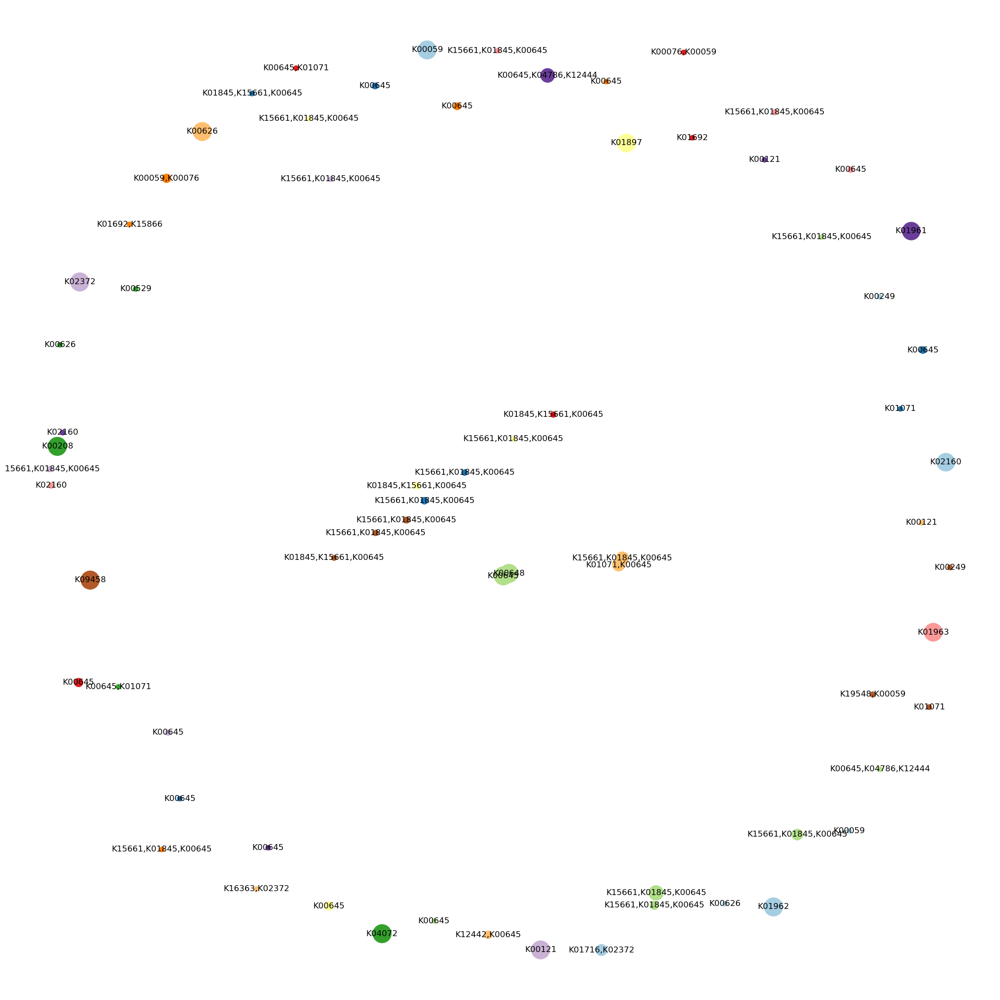

In [17]:
FAM_G = nx.Graph()
FAM_G.add_nodes_from(FAM_node_t) 
#FAM_G.add_nodes_from(FAM_node_tnei) 
FAM_weight_min = min(list(FAM_edge_t.values()) + list(FAM_edge_ex.values())) #list(FAM_edge_tnei.values())
FAM_weight_max = max(list(FAM_edge_t.values()) + list(FAM_edge_ex.values())) #+ list(FAM_edge_tnei.values())
FAM_node_min = min([id_pro_len[i] for i in (FAM_node_t + FAM_node_tC)]) #+ FAM_node_tnei
FAM_node_max = max([id_pro_len[i] for i in (FAM_node_t + FAM_node_tC)]) #+ FAM_node_tnei
#FAM_node_max = min(162, max([id_pro_len[i] for i in (FAM_node_t + FAM_node_tnei + FAM_node_tC)]))
for edge, w in FAM_edge_origin.items():
    FAM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl='o') 
for edge, w in FAM_edge_pre.items():
    FAM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'e') 
#for edge, w in FAM_edge_ex.items():
    #FAM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'C') 
#for edge, w in FAM_edge_tnei.items():
#    FAM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'n') 
    
nx.set_node_attributes(FAM_G, id_FAM_dict_G, 'fun_name')
nx.set_node_attributes(FAM_G, id_C, 'C')
nx.set_node_attributes(FAM_G, id_pro_len, 'pro_len')
#nx.set_node_attributes(FAM_G, id_type, 'C_type')
node_labels = nx.get_node_attributes(FAM_G, 'fun_name')
print('number of nodes: ', FAM_G.number_of_nodes())
print('number of edges: ', FAM_G.number_of_edges())

eorigin=[(u,v) for (u,v,d) in FAM_G.edges(data=True) if d['cl'] == 'o']
eex=[(u,v) for (u,v,d) in FAM_G.edges(data=True) if d['cl'] == 'e']
eC=[(u,v) for (u,v,d) in FAM_G.edges(data=True) if d['cl'] == 'C']
enei=[(u,v) for (u,v,d) in FAM_G.edges(data=True) if d['cl'] == 'n']

FAM_G_connected_node = list()
for c in nx.connected_components(FAM_G):
    nodeSet = FAM_G.subgraph(c).nodes()
    FAM_G_connected_node.append(nodeSet)
print('number of subgraFAM: ', len(FAM_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(FAM_C_t)) 
node_color = [color_palette[FAM_C_t.index(node[1]['C'])] for node in FAM_G.nodes()(data=True)]
node_size = [50 + 950*(node[1]['pro_len'] - FAM_node_min)/(FAM_node_max - FAM_node_min)  for node in FAM_G.nodes()(data=True)]
pos = nx.spring_layout(FAM_G, k=0.2) #,iterations=50
#pos = nx.kamada_kawai_layout(FAM_G)
width_normal = [1 + 5*(float(abs(d['weight'])) - FAM_weight_min)/(FAM_weight_max -FAM_weight_min) for (u,v,d) in FAM_G.edges()(data=True)]
nx.draw(FAM_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        edgelist=eorigin,
        node_color=node_color,
        width=width_normal
       )
#nx.draw_networkx_edge_labels(FAM_pred_G, pos, label_pos=0.5,  rotate=False, font_size=8)
#nx.draw_networkx_edges(FAM_G,pos,edgelist=eex,style = ':',
#                      width= width_normal, alpha=1
#                      )
#nx.draw_networkx_edges(FAM_G,pos,edgelist=eC,style = '--',
#                      width= width_normal, alpha=1
#                      )
#nx.draw_networkx_edges(FAM_G,pos,edgelist=enei,style = '--',
 #                     width= width_normal, alpha=0.8
  #                    )

number of nodes:  184
number of edges:  1455
number of PPI C:  25
number of subgraFAM:  1


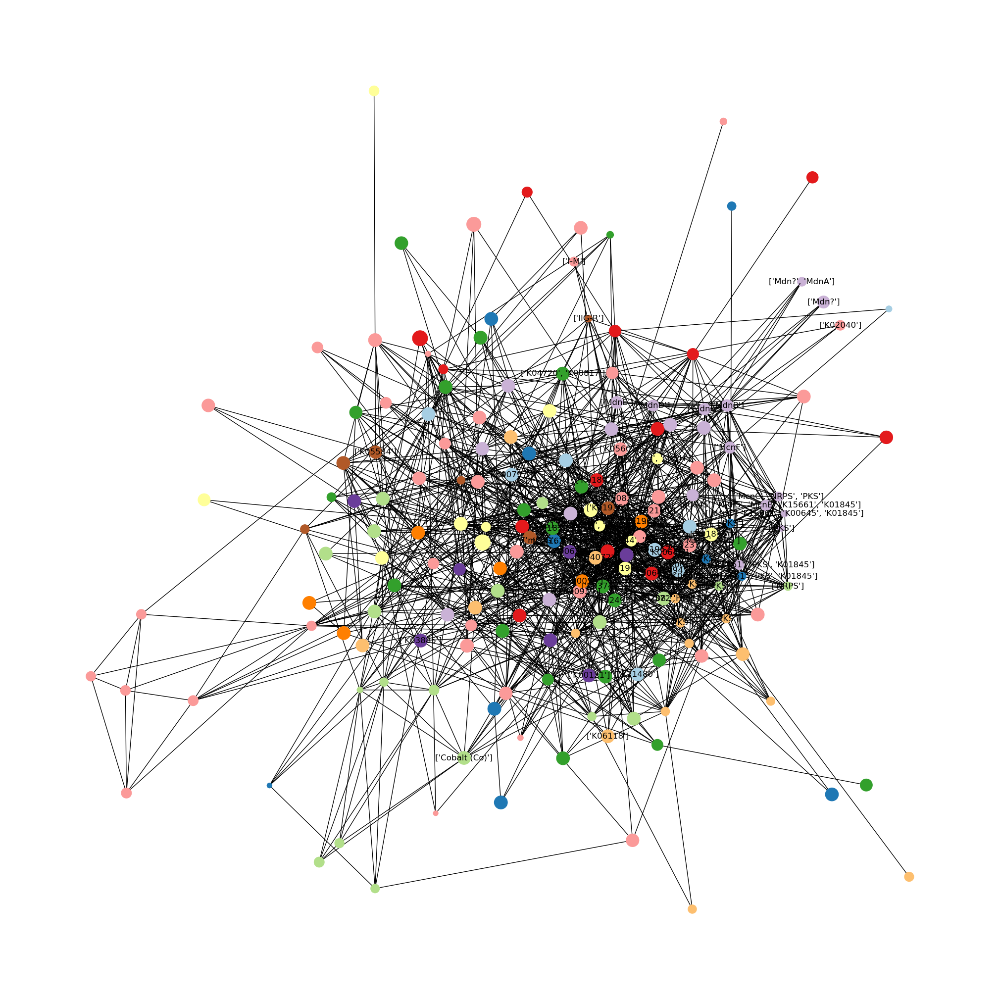

In [18]:
PPI_id_FAM_df = PPI_id_df[(PPI_id_df['C_1'].isin(FAM_C_t)) & (PPI_id_df['C_2'].isin(FAM_C_t))].reset_index(drop=True)
FAM_C_PPI_edge_t = PPI_id_FAM_df.set_index(['node1','node2']).to_dict()['weight']
FAM_C_PPI_node = list(set([str(i) for i in PPI_id_FAM_df['node1'].tolist()] + [str(i) for i in PPI_id_FAM_df['node2'].tolist()]))
FAM_C_PPI_t = list(set([id_C[i] for i in FAM_C_PPI_node]))
FAM_PPI_G = nx.Graph()
#FAM_PPI_G.add_nodes_from(FAM_C_PPI_node) 
FAM_PPI_node_min = min([id_pro_len[i] for i in (FAM_C_PPI_node)])
FAM_PPI_node_max = max([id_pro_len[i] for i in (FAM_C_PPI_node)]) 
for edge, w in FAM_C_PPI_edge_t.items():
    FAM_PPI_G.add_edge(str(edge[0]), str(edge[1]), weight = w)   
nx.set_node_attributes(FAM_PPI_G, label_dict, 'fun_name')
nx.set_node_attributes(FAM_PPI_G, id_C, 'C')
nx.set_node_attributes(FAM_PPI_G, id_pro_len, 'pro_len')
node_labels = nx.get_node_attributes(FAM_PPI_G, 'fun_name')
print('number of nodes: ', FAM_PPI_G.number_of_nodes())
print('number of edges: ', FAM_PPI_G.number_of_edges())
print('number of PPI C: ', len(FAM_C_PPI_t))


FAM_PPI_G_connected_node = list()
for c in nx.connected_components(FAM_PPI_G):
    nodeSet = FAM_PPI_G.subgraph(c).nodes()
    FAM_PPI_G_connected_node.append(nodeSet)
print('number of subgraFAM: ', len(FAM_PPI_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(FAM_C_PPI_t)) 
node_color = [color_palette[FAM_C_PPI_t.index(node[1]['C'])] for node in FAM_PPI_G.nodes()(data=True)]
node_size = [50 + 450*(node[1]['pro_len'] - FAM_PPI_node_min)/(FAM_PPI_node_max - FAM_PPI_node_min)  for node in FAM_PPI_G.nodes()(data=True)]
pos = nx.spring_layout(FAM_PPI_G, k=2) #,iterations=50
#pos = nx.kamada_kawai_layout(FAM_PPI_G)
nx.draw(FAM_PPI_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        node_color=node_color,
       )

### 糖酵解 GLY

In [19]:
pro_GLY_dict = {}
with open('../function/GLY_mis.fasta') as f:
    for line in f:
        line = line.strip('\n')
        if line.startswith('>'):
            pro_GLY_dict[line[1:]] = pro_K[line[1:]]
id_GLY_dict = {}
for k, v in pro_GLY_dict.items():
    if pro_id[k] not in id_GLY_dict:
        id_GLY_dict[pro_id[k]] = []
    id_GLY_dict[pro_id[k]]  = list(set(v+id_GLY_dict[pro_id[k]]))
id_GLY_dict = {k:v if len(v) != 0 else ['GLY?'] for k, v in id_GLY_dict.items()}
GLY_id_origin = list(id_GLY_dict.keys())
C_GLY_dict = {}
C_GLY_value_dict = {}
C_GLY_count_dict = {}
for k, v in id_GLY_dict.items():
    if id_C[k] not in C_GLY_dict:
        C_GLY_dict[id_C[k]] = []
        C_GLY_value_dict[id_C[k]] = []
    C_GLY_dict[id_C[k]] = list(set(C_GLY_dict[id_C[k]] + v))
    C_GLY_value_dict[id_C[k]] = C_GLY_value_dict[id_C[k]] + v
C_GLY_count_dict = {k:dict(Counter(v)) for k, v in C_GLY_value_dict.items()}
print('GLY pro count: ', len(pro_GLY_dict))
print('GLY node count: ',len(id_GLY_dict))
print('GLY C count: ',len(C_GLY_dict))

GLY_pred_df = pd.read_csv('../function/GLY_pred.txt', sep='\t', header=None)
GLY_pred_df = GLY_pred_df[GLY_pred_df[1].isin(pro_GLY_dict)]
GLY_pred_df['id_1'] = GLY_pred_df[0].apply(lambda x:pro_id[x])
GLY_pred_df['id_2'] = GLY_pred_df[1].apply(lambda x:pro_id[x])
GLY_pred_df['func'] = GLY_pred_df[1].apply(lambda x: pro_GLY_dict[x])
GLY_pred_f_df = GLY_pred_df[~(GLY_pred_df['id_1'].isin(GLY_id_origin))].loc[:, ['id_1','id_2','func']].drop_duplicates(subset=['id_1','id_2'])
id_GLY_pred_dict = GLY_pred_f_df.set_index('id_1').to_dict()['func']
id_GLY_pred_dict = {k:v if len(v) != 0 else ['GLY?'] for k, v in id_GLY_pred_dict.items()}
#id_GLY_dict.update(id_GLY_pred_dict)

GLY_node_origin = GLY_id_origin
GLY_edge_origin = id_edge_df[(id_edge_df[0].isin(GLY_node_origin))&(id_edge_df[1].isin(GLY_node_origin))].set_index([0,1]).to_dict()[2]
GLY_node_ex = list(id_GLY_pred_dict.keys())
GLY_node_t = list(id_GLY_dict.keys()) + list(id_GLY_pred_dict.keys())
GLY_edge_t_df = id_edge_df[(id_edge_df[0].isin(GLY_node_t))&(id_edge_df[1].isin(GLY_node_t))]
GLY_edge_t = GLY_edge_t_df.set_index([0,1]).to_dict()[2]
GLY_edge_pre = GLY_edge_t_df[(GLY_edge_t_df[0].isin(GLY_node_ex))|(GLY_edge_t_df[1].isin(GLY_node_ex))].set_index([0,1]).to_dict()[2]

GLY_C = list(C_GLY_dict.keys())
GLY_node_oC= [j for i in GLY_C for j in C_id[i] if j not in GLY_node_origin]
GLY_node_tC = [j for i in GLY_C for j in C_id[i] if j not in GLY_node_t]
GLY_edge_df = id_edge_df[(id_edge_df[0].isin(GLY_node_origin+GLY_node_oC))&(id_edge_df[1].isin(GLY_node_origin+GLY_node_oC))]
GLY_edge = GLY_edge_df[(GLY_edge_df[0].isin(GLY_node_oC))|(GLY_edge_df[1].isin(GLY_node_oC))].set_index([0,1]).to_dict()[2]
GLY_edge_ex_df = id_edge_df[(id_edge_df[0].isin(GLY_node_t+GLY_node_tC))&(id_edge_df[1].isin(GLY_node_t+GLY_node_tC))]
GLY_edge_ex = GLY_edge_ex_df[(GLY_edge_ex_df[0].isin(GLY_node_tC))|(GLY_edge_ex_df[1].isin(GLY_node_tC))].set_index([0,1]).to_dict()[2]
GLY_C_t = list(set([id_C[i] for i in GLY_node_t]))
print('GLY ex C count: ',len(GLY_C_t))
print('origin node: ', len(GLY_node_origin))
print('total node: ', len(GLY_node_t))
print('origin edge: ', len(GLY_edge_origin))
print('extend edge: ', len(GLY_edge_pre))
print('total edge: ', len(GLY_edge_t_df))
print('origin C nei node: ', len(GLY_node_oC))
print('origin C nei edge: ', len(GLY_edge_df))
print('total C nei node: ', len(GLY_node_tC))
print('total C nei edge: ', len(GLY_edge_ex_df))

GLY_node_onei = list(set([nei for node in GLY_node_origin for nei in find_nei(proid_G, node)[0]]) - set(GLY_node_origin))
GLY_node_tnei = list(set([nei for node in GLY_node_t for nei in find_nei(proid_G, node)[0]]) - set(GLY_node_t))
GLY_edge_onei_df = id_edge_df[(id_edge_df[0].isin(GLY_node_origin+GLY_node_onei))&(id_edge_df[1].isin(GLY_node_origin+GLY_node_onei))]
#GLY_edge_onei = GLY_edge_onei_df[GLY_edge_onei_df[0].isin(GLY_node_onei) | GLY_edge_onei_df[1].isin(GLY_node_onei)].set_index([0,1]).to_dict()[2]
GLY_edge_tnei_df = id_edge_df[(id_edge_df[0].isin(GLY_node_t+GLY_node_tnei))&(id_edge_df[1].isin(GLY_node_t+GLY_node_tnei))]
#GLY_edge_tnei = GLY_edge_tnei_df[GLY_edge_tnei_df[0].isin(GLY_node_tnei) | GLY_edge_tnei_df[1].isin(GLY_node_tnei)].set_index([0,1]).to_dict()[2]
GLY_GC_t =list(set([id_C[i] for i in GLY_node_t+GLY_node_tnei]))
print('origin  nei node: ', len(GLY_node_onei))
print('origin  nei edge: ', len(GLY_edge_onei_df))
print('total  nei node: ', len(GLY_node_tnei))
print('total  nei edge: ', len(GLY_edge_tnei_df))

GLY_PPI_o_df = PPI_id_df[(PPI_id_df['node1'].isin(GLY_node_origin))&(PPI_id_df['node2'].isin(GLY_node_origin))]
GLY_PPI_t_df = PPI_id_df[(PPI_id_df['node1'].isin(GLY_node_t))&(PPI_id_df['node2'].isin(GLY_node_t))]
GLY_node_o_PPI = list(set(GLY_PPI_o_df['node1'].tolist() + GLY_PPI_o_df['node2'].tolist()))
GLY_node_t_PPI = list(set(GLY_PPI_t_df['node1'].tolist() + GLY_PPI_t_df['node2'].tolist()))
print('PPI orign node: ', len(GLY_node_o_PPI))
print('PPI total node: ', len(GLY_node_t_PPI))
print('PPI orign edge: ', len(GLY_PPI_o_df))
print('PPI total edge: ', len(GLY_PPI_t_df)) 
id_GLY_t_dict = {k:id_GLY_dict[k] if k in id_GLY_dict else id_GLY_pred_dict[k] for k in GLY_node_t}
id_GLY_dict_G = {k:','.join(v) + ' **' if int(k) in GLY_node_t_PPI  else ','.join(v) for k, v in id_GLY_t_dict.items()}

GLY pro count:  4927
GLY node count:  45
GLY C count:  45
GLY ex C count:  49
origin node:  45
total node:  49
origin edge:  6
extend edge:  1
total edge:  7
origin C nei node:  739
origin C nei edge:  308
total C nei node:  739
total C nei edge:  311
origin  nei node:  639
origin  nei edge:  1518
total  nei node:  638
total  nei edge:  1521
PPI orign node:  30
PPI total node:  30
PPI orign edge:  360
PPI total edge:  360


number of nodes:  49
number of edges:  7
number of subgraGLY:  43


"\nnx.draw_networkx_edges(GLY_G,pos,edgelist=eex,style = ':',\n                      width= width_normal, alpha=1\n                      )\nnx.draw_networkx_edges(GLY_G,pos,edgelist=eC,style = '--',\n                      width= width_normal, alpha=1\n                      )\nnx.draw_networkx_edges(GLY_G,pos,edgelist=enei,style = '--',\n                      width= width_normal, alpha=0.8\n                      )\n"

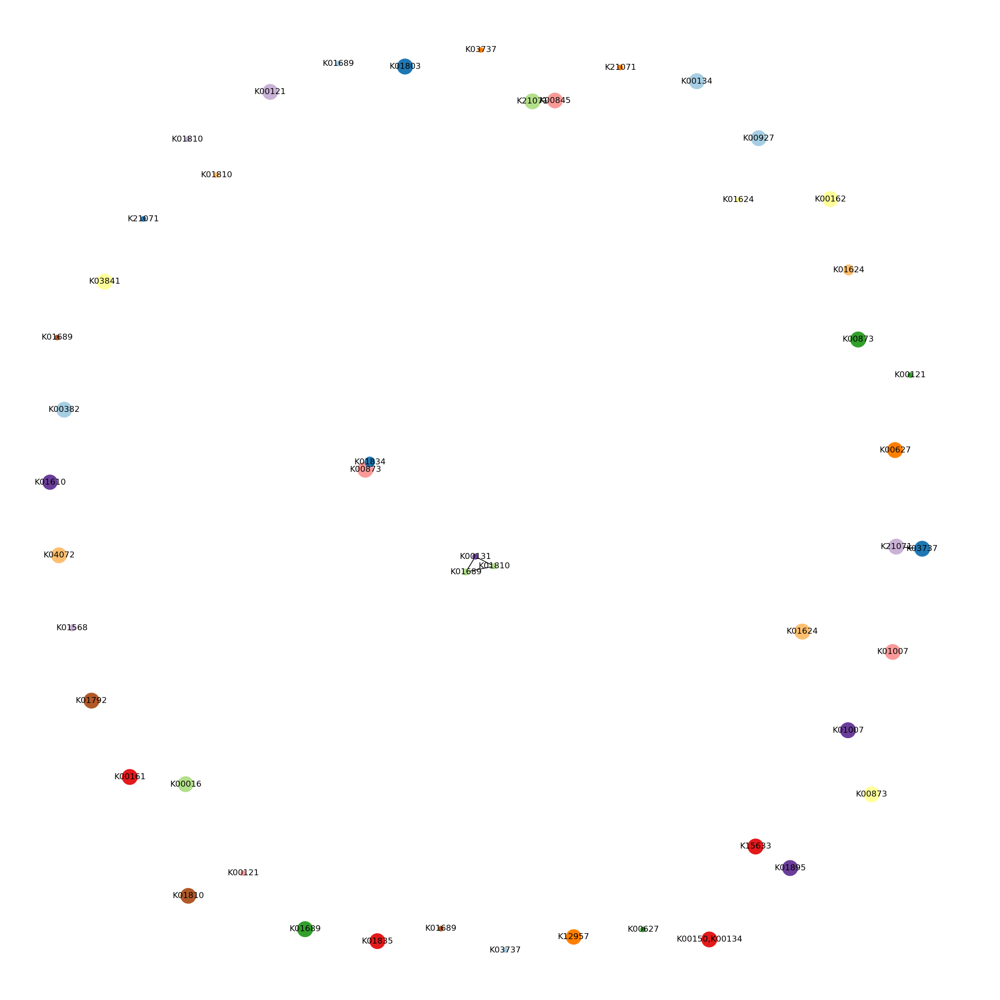

In [20]:
GLY_G = nx.Graph()
GLY_G.add_nodes_from(GLY_node_t) 
#GLY_G.add_nodes_from(GLY_node_tnei) 
GLY_weight_min = min(list(GLY_edge_t.values()) + list(GLY_edge_ex.values())) #list(GLY_edge_tnei.values())
GLY_weight_max = max(list(GLY_edge_t.values()) + list(GLY_edge_ex.values())) #+ list(GLY_edge_tnei.values())
GLY_node_min = min([id_pro_len[i] for i in (GLY_node_t + GLY_node_tC)]) #+ GLY_node_tnei
GLY_node_max = max([id_pro_len[i] for i in (GLY_node_t + GLY_node_tC)]) #+ GLY_node_tnei
#GLY_node_max = min(162, max([id_pro_len[i] for i in (GLY_node_t + GLY_node_tnei + GLY_node_tC)]))
for edge, w in GLY_edge_origin.items():
    GLY_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl='o') 
for edge, w in GLY_edge_pre.items():
    GLY_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'e') 
#for edge, w in GLY_edge_ex.items():
    #GLY_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'C') 
#for edge, w in GLY_edge_tnei.items():
#    GLY_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'n') 
    
nx.set_node_attributes(GLY_G, id_GLY_dict_G, 'fun_name')
nx.set_node_attributes(GLY_G, id_C, 'C')
nx.set_node_attributes(GLY_G, id_pro_len, 'pro_len')
#nx.set_node_attributes(GLY_G, id_type, 'C_type')
node_labels = nx.get_node_attributes(GLY_G, 'fun_name')
print('number of nodes: ', GLY_G.number_of_nodes())
print('number of edges: ', GLY_G.number_of_edges())

eorigin=[(u,v) for (u,v,d) in GLY_G.edges(data=True) if d['cl'] == 'o']
eex=[(u,v) for (u,v,d) in GLY_G.edges(data=True) if d['cl'] == 'e']
eC=[(u,v) for (u,v,d) in GLY_G.edges(data=True) if d['cl'] == 'C']
enei=[(u,v) for (u,v,d) in GLY_G.edges(data=True) if d['cl'] == 'n']

GLY_G_connected_node = list()
for c in nx.connected_components(GLY_G):
    nodeSet = GLY_G.subgraph(c).nodes()
    GLY_G_connected_node.append(nodeSet)
print('number of subgraGLY: ', len(GLY_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(GLY_C_t)) 
node_color = [color_palette[GLY_C_t.index(node[1]['C'])] for node in GLY_G.nodes()(data=True)]
node_size = [50 + 950*(node[1]['pro_len'] - GLY_node_min)/(GLY_node_max - GLY_node_min)  for node in GLY_G.nodes()(data=True)]
pos = nx.spring_layout(GLY_G, k=0.2) #,iterations=50
#pos = nx.kamada_kawai_layout(GLY_G)
width_normal = [1 + 5*(float(abs(d['weight'])) - GLY_weight_min)/(GLY_weight_max -GLY_weight_min) for (u,v,d) in GLY_G.edges()(data=True)]
nx.draw(GLY_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        edgelist=eorigin,
        node_color=node_color,
        width=width_normal
       )
#nx.draw_networkx_edge_labels(GLY_pred_G, pos, label_pos=0.5,  rotate=False, font_size=8)
'''
nx.draw_networkx_edges(GLY_G,pos,edgelist=eex,style = ':',
                      width= width_normal, alpha=1
                      )
nx.draw_networkx_edges(GLY_G,pos,edgelist=eC,style = '--',
                      width= width_normal, alpha=1
                      )
nx.draw_networkx_edges(GLY_G,pos,edgelist=enei,style = '--',
                      width= width_normal, alpha=0.8
                      )
'''

number of nodes:  176
number of edges:  1506
number of PPI C:  35
number of subgraGLY:  3


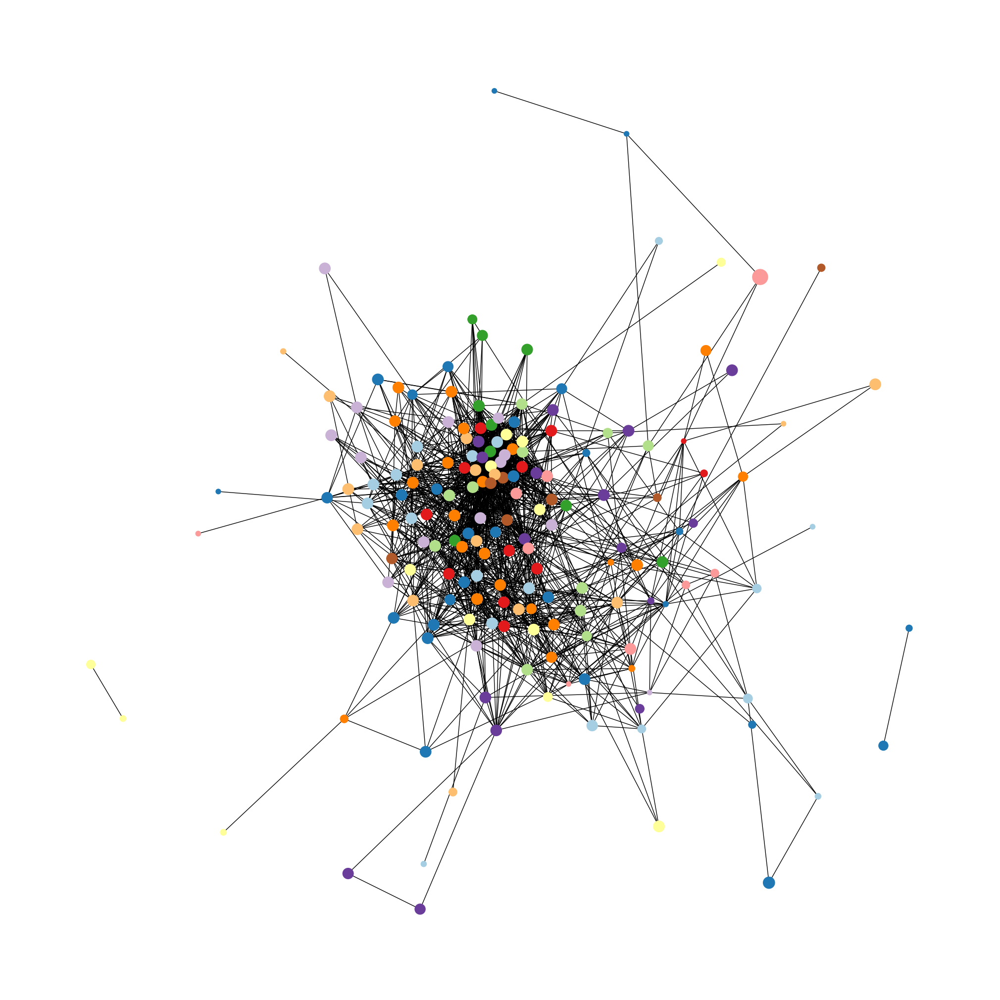

In [21]:
PPI_id_GLY_df = PPI_id_df[(PPI_id_df['C_1'].isin(GLY_C_t)) & (PPI_id_df['C_2'].isin(GLY_C_t))].reset_index(drop=True)
GLY_C_PPI_edge_t = PPI_id_GLY_df.set_index(['node1','node2']).to_dict()['weight']
GLY_C_PPI_node = list(set([str(i) for i in PPI_id_GLY_df['node1'].tolist()] + [str(i) for i in PPI_id_GLY_df['node2'].tolist()]))
GLY_C_PPI_t = list(set([id_C[i] for i in GLY_C_PPI_node]))
GLY_PPI_G = nx.Graph()
#GLY_PPI_G.add_nodes_from(GLY_C_PPI_node) 
GLY_PPI_node_min = min([id_pro_len[i] for i in (GLY_C_PPI_node)])
GLY_PPI_node_max = max([id_pro_len[i] for i in (GLY_C_PPI_node)]) 
for edge, w in GLY_C_PPI_edge_t.items():
    GLY_PPI_G.add_edge(str(edge[0]), str(edge[1]), weight = w)   
#nx.set_node_attributes(GLY_PPI_G, label_dict, 'fun_name')
nx.set_node_attributes(GLY_PPI_G, id_C, 'C')
nx.set_node_attributes(GLY_PPI_G, id_pro_len, 'pro_len')
node_labels = nx.get_node_attributes(GLY_PPI_G, 'fun_name')
print('number of nodes: ', GLY_PPI_G.number_of_nodes())
print('number of edges: ', GLY_PPI_G.number_of_edges())
print('number of PPI C: ', len(GLY_C_PPI_t))


GLY_PPI_G_connected_node = list()
for c in nx.connected_components(GLY_PPI_G):
    nodeSet = GLY_PPI_G.subgraph(c).nodes()
    GLY_PPI_G_connected_node.append(nodeSet)
print('number of subgraGLY: ', len(GLY_PPI_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(GLY_C_PPI_t)) 
node_color = [color_palette[GLY_C_PPI_t.index(node[1]['C'])] for node in GLY_PPI_G.nodes()(data=True)]
node_size = [50 + 450*(node[1]['pro_len'] - GLY_PPI_node_min)/(GLY_PPI_node_max - GLY_PPI_node_min)  for node in GLY_PPI_G.nodes()(data=True)]
pos = nx.spring_layout(GLY_PPI_G, k=2) #,iterations=50
#pos = nx.kamada_kawai_layout(GLY_PPI_G)
nx.draw(GLY_PPI_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        node_color=node_color,
       )

### 磷酸戊糖途径 PPP

In [22]:
pro_PPP_dict = {}
with open('../function/PPP_mis.fasta') as f:
    for line in f:
        line = line.strip('\n')
        if line.startswith('>'):
            pro_PPP_dict[line[1:]] = pro_K[line[1:]]
id_PPP_dict = {}
for k, v in pro_PPP_dict.items():
    if pro_id[k] not in id_PPP_dict:
        id_PPP_dict[pro_id[k]] = []
    id_PPP_dict[pro_id[k]]  = list(set(v+id_PPP_dict[pro_id[k]]))
id_PPP_dict = {k:v if len(v) != 0 else ['PPP?'] for k, v in id_PPP_dict.items()}
PPP_id_origin = list(id_PPP_dict.keys())
C_PPP_dict = {}
C_PPP_value_dict = {}
C_PPP_count_dict = {}
for k, v in id_PPP_dict.items():
    if id_C[k] not in C_PPP_dict:
        C_PPP_dict[id_C[k]] = []
        C_PPP_value_dict[id_C[k]] = []
    C_PPP_dict[id_C[k]] = list(set(C_PPP_dict[id_C[k]] + v))
    C_PPP_value_dict[id_C[k]] = C_PPP_value_dict[id_C[k]] + v
C_PPP_count_dict = {k:dict(Counter(v)) for k, v in C_PPP_value_dict.items()}
print('PPP pro count: ', len(pro_PPP_dict))
print('PPP node count: ',len(id_PPP_dict))
print('PPP C count: ',len(C_PPP_dict))

PPP_pred_df = pd.read_csv('../function/PPP_pred.txt', sep='\t', header=None)
PPP_pred_df = PPP_pred_df[PPP_pred_df[1].isin(pro_PPP_dict)]
PPP_pred_df['id_1'] = PPP_pred_df[0].apply(lambda x:pro_id[x])
PPP_pred_df['id_2'] = PPP_pred_df[1].apply(lambda x:pro_id[x])
PPP_pred_df['func'] = PPP_pred_df[1].apply(lambda x: pro_PPP_dict[x])
PPP_pred_f_df = PPP_pred_df[~(PPP_pred_df['id_1'].isin(PPP_id_origin))].loc[:, ['id_1','id_2','func']].drop_duplicates(subset=['id_1','id_2'])
id_PPP_pred_dict = PPP_pred_f_df.set_index('id_1').to_dict()['func']
id_PPP_pred_dict = {k:v if len(v) != 0 else ['PPP?'] for k, v in id_PPP_pred_dict.items()}
#id_PPP_dict.update(id_PPP_pred_dict)

PPP_node_origin = PPP_id_origin
PPP_edge_origin = id_edge_df[(id_edge_df[0].isin(PPP_node_origin))&(id_edge_df[1].isin(PPP_node_origin))].set_index([0,1]).to_dict()[2]
PPP_node_ex = list(id_PPP_pred_dict.keys())
PPP_node_t = list(id_PPP_dict.keys()) + list(id_PPP_pred_dict.keys())
PPP_edge_t_df = id_edge_df[(id_edge_df[0].isin(PPP_node_t))&(id_edge_df[1].isin(PPP_node_t))]
PPP_edge_t = PPP_edge_t_df.set_index([0,1]).to_dict()[2]
PPP_edge_pre = PPP_edge_t_df[(PPP_edge_t_df[0].isin(PPP_node_ex))|(PPP_edge_t_df[1].isin(PPP_node_ex))].set_index([0,1]).to_dict()[2]

PPP_C = list(C_PPP_dict.keys())
PPP_node_oC= [j for i in PPP_C for j in C_id[i] if j not in PPP_node_origin]
PPP_node_tC = [j for i in PPP_C for j in C_id[i] if j not in PPP_node_t]
PPP_edge_df = id_edge_df[(id_edge_df[0].isin(PPP_node_origin+PPP_node_oC))&(id_edge_df[1].isin(PPP_node_origin+PPP_node_oC))]
PPP_edge = PPP_edge_df[(PPP_edge_df[0].isin(PPP_node_oC))|(PPP_edge_df[1].isin(PPP_node_oC))].set_index([0,1]).to_dict()[2]
PPP_edge_ex_df = id_edge_df[(id_edge_df[0].isin(PPP_node_t+PPP_node_tC))&(id_edge_df[1].isin(PPP_node_t+PPP_node_tC))]
PPP_edge_ex = PPP_edge_ex_df[(PPP_edge_ex_df[0].isin(PPP_node_tC))|(PPP_edge_ex_df[1].isin(PPP_node_tC))].set_index([0,1]).to_dict()[2]
PPP_C_t = list(set([id_C[i] for i in PPP_node_t]))
print('PPP ex C count: ',len(PPP_C_t))
print('origin node: ', len(PPP_node_origin))
print('total node: ', len(PPP_node_t))
print('origin edge: ', len(PPP_edge_origin))
print('extend edge: ', len(PPP_edge_pre))
print('total edge: ', len(PPP_edge_t_df))
print('origin C nei node: ', len(PPP_node_oC))
print('origin C nei edge: ', len(PPP_edge_df))
print('total C nei node: ', len(PPP_node_tC))
print('total C nei edge: ', len(PPP_edge_ex_df))

PPP_node_onei = list(set([nei for node in PPP_node_origin for nei in find_nei(proid_G, node)[0]]) - set(PPP_node_origin))
PPP_node_tnei = list(set([nei for node in PPP_node_t for nei in find_nei(proid_G, node)[0]]) - set(PPP_node_t))
PPP_edge_onei_df = id_edge_df[(id_edge_df[0].isin(PPP_node_origin+PPP_node_onei))&(id_edge_df[1].isin(PPP_node_origin+PPP_node_onei))]
#PPP_edge_onei = PPP_edge_onei_df[PPP_edge_onei_df[0].isin(PPP_node_onei) | PPP_edge_onei_df[1].isin(PPP_node_onei)].set_index([0,1]).to_dict()[2]
PPP_edge_tnei_df = id_edge_df[(id_edge_df[0].isin(PPP_node_t+PPP_node_tnei))&(id_edge_df[1].isin(PPP_node_t+PPP_node_tnei))]
#PPP_edge_tnei = PPP_edge_tnei_df[PPP_edge_tnei_df[0].isin(PPP_node_tnei) | PPP_edge_tnei_df[1].isin(PPP_node_tnei)].set_index([0,1]).to_dict()[2]
PPP_GC_t =list(set([id_C[i] for i in PPP_node_t+PPP_node_tnei]))
print('origin  nei node: ', len(PPP_node_onei))
print('origin  nei edge: ', len(PPP_edge_onei_df))
print('total  nei node: ', len(PPP_node_tnei))
print('total  nei edge: ', len(PPP_edge_tnei_df))

PPP_PPI_o_df = PPI_id_df[(PPI_id_df['node1'].isin(PPP_node_origin))&(PPI_id_df['node2'].isin(PPP_node_origin))]
PPP_PPI_t_df = PPI_id_df[(PPI_id_df['node1'].isin(PPP_node_t))&(PPI_id_df['node2'].isin(PPP_node_t))]
PPP_node_o_PPI = list(set(PPP_PPI_o_df['node1'].tolist() + PPP_PPI_o_df['node2'].tolist()))
PPP_node_t_PPI = list(set(PPP_PPI_t_df['node1'].tolist() + PPP_PPI_t_df['node2'].tolist()))
print('PPI orign node: ', len(PPP_node_o_PPI))
print('PPI total node: ', len(PPP_node_t_PPI))
print('PPI orign edge: ', len(PPP_PPI_o_df))
print('PPI total edge: ', len(PPP_PPI_t_df)) 
id_PPP_t_dict = {k:id_PPP_dict[k] if k in id_PPP_dict else id_PPP_pred_dict[k] for k in PPP_node_t}
id_PPP_dict_G = {k:','.join(v) + ' **' if int(k) in PPP_node_t_PPI  else ','.join(v) for k, v in id_PPP_t_dict.items()}

PPP pro count:  2712
PPP node count:  31
PPP C count:  30
PPP ex C count:  34
origin node:  31
total node:  35
origin edge:  2
extend edge:  1
total edge:  3
origin C nei node:  316
origin C nei edge:  155
total C nei node:  316
total C nei edge:  158
origin  nei node:  338
origin  nei edge:  811
total  nei node:  338
total  nei edge:  815
PPI orign node:  17
PPI total node:  17
PPI orign edge:  123
PPI total edge:  123


number of nodes:  35
number of edges:  3
number of subgraPPP:  32


"\nnx.draw_networkx_edges(PPP_G,pos,edgelist=eex,style = ':',\n                      width= width_normal, alpha=1\n                      )\nnx.draw_networkx_edges(PPP_G,pos,edgelist=eC,style = '--',\n                      width= width_normal, alpha=1\n                      )\nnx.draw_networkx_edges(PPP_G,pos,edgelist=enei,style = '--',\n                      width= width_normal, alpha=0.8\n                      )\n"

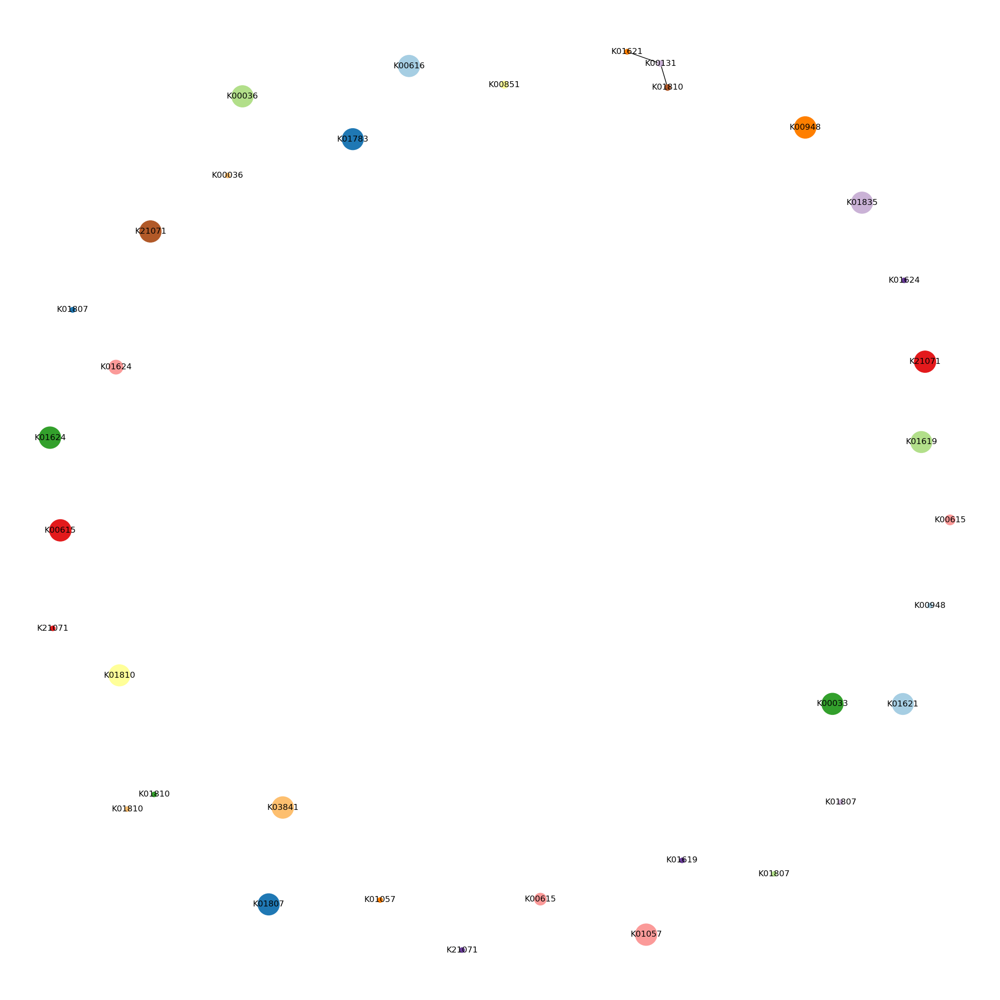

In [23]:
PPP_G = nx.Graph()
PPP_G.add_nodes_from(PPP_node_t) 
#PPP_G.add_nodes_from(PPP_node_tnei) 
PPP_weight_min = min(list(PPP_edge_t.values()) + list(PPP_edge_ex.values())) #list(PPP_edge_tnei.values())
PPP_weight_max = max(list(PPP_edge_t.values()) + list(PPP_edge_ex.values())) #+ list(PPP_edge_tnei.values())
PPP_node_min = min([id_pro_len[i] for i in (PPP_node_t + PPP_node_tC)]) #+ PPP_node_tnei
PPP_node_max = max([id_pro_len[i] for i in (PPP_node_t + PPP_node_tC)]) #+ PPP_node_tnei
#PPP_node_max = min(162, max([id_pro_len[i] for i in (PPP_node_t + PPP_node_tnei + PPP_node_tC)]))
for edge, w in PPP_edge_origin.items():
    PPP_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl='o') 
for edge, w in PPP_edge_pre.items():
    PPP_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'e') 
#for edge, w in PPP_edge_ex.items():
    #PPP_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'C') 
#for edge, w in PPP_edge_tnei.items():
#    PPP_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'n') 
    
nx.set_node_attributes(PPP_G, id_PPP_dict_G, 'fun_name')
nx.set_node_attributes(PPP_G, id_C, 'C')
nx.set_node_attributes(PPP_G, id_pro_len, 'pro_len')
#nx.set_node_attributes(PPP_G, id_type, 'C_type')
node_labels = nx.get_node_attributes(PPP_G, 'fun_name')
print('number of nodes: ', PPP_G.number_of_nodes())
print('number of edges: ', PPP_G.number_of_edges())

eorigin=[(u,v) for (u,v,d) in PPP_G.edges(data=True) if d['cl'] == 'o']
eex=[(u,v) for (u,v,d) in PPP_G.edges(data=True) if d['cl'] == 'e']
eC=[(u,v) for (u,v,d) in PPP_G.edges(data=True) if d['cl'] == 'C']
enei=[(u,v) for (u,v,d) in PPP_G.edges(data=True) if d['cl'] == 'n']

PPP_G_connected_node = list()
for c in nx.connected_components(PPP_G):
    nodeSet = PPP_G.subgraph(c).nodes()
    PPP_G_connected_node.append(nodeSet)
print('number of subgraPPP: ', len(PPP_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(PPP_C_t)) 
node_color = [color_palette[PPP_C_t.index(node[1]['C'])] for node in PPP_G.nodes()(data=True)]
node_size = [50 + 950*(node[1]['pro_len'] - PPP_node_min)/(PPP_node_max - PPP_node_min)  for node in PPP_G.nodes()(data=True)]
pos = nx.spring_layout(PPP_G, k=0.2) #,iterations=50
#pos = nx.kamada_kawai_layout(PPP_G)
width_normal = [1 + 5*(float(abs(d['weight'])) - PPP_weight_min)/(PPP_weight_max -PPP_weight_min) for (u,v,d) in PPP_G.edges()(data=True)]
nx.draw(PPP_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        edgelist=eorigin,
        node_color=node_color,
        width=width_normal
       )
#nx.draw_networkx_edge_labels(PPP_pred_G, pos, label_pos=0.5,  rotate=False, font_size=8)
'''
nx.draw_networkx_edges(PPP_G,pos,edgelist=eex,style = ':',
                      width= width_normal, alpha=1
                      )
nx.draw_networkx_edges(PPP_G,pos,edgelist=eC,style = '--',
                      width= width_normal, alpha=1
                      )
nx.draw_networkx_edges(PPP_G,pos,edgelist=enei,style = '--',
                      width= width_normal, alpha=0.8
                      )
'''

number of nodes:  79
number of edges:  395
number of PPI C:  21
number of subgraPPP:  2


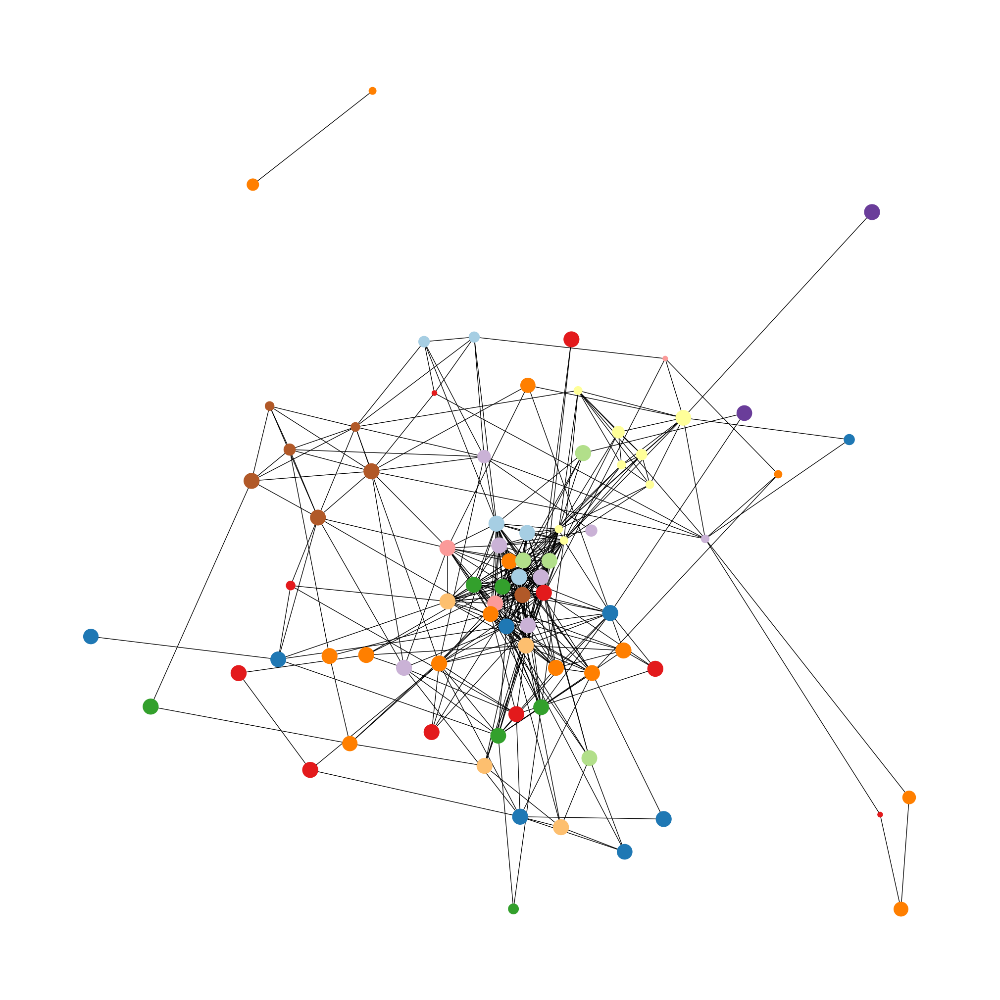

In [24]:
PPI_id_PPP_df = PPI_id_df[(PPI_id_df['C_1'].isin(PPP_C_t)) & (PPI_id_df['C_2'].isin(PPP_C_t))].reset_index(drop=True)
PPP_C_PPI_edge_t = PPI_id_PPP_df.set_index(['node1','node2']).to_dict()['weight']
PPP_C_PPI_node = list(set([str(i) for i in PPI_id_PPP_df['node1'].tolist()] + [str(i) for i in PPI_id_PPP_df['node2'].tolist()]))
PPP_C_PPI_t = list(set([id_C[i] for i in PPP_C_PPI_node]))
PPP_PPI_G = nx.Graph()
#PPP_PPI_G.add_nodes_from(PPP_C_PPI_node) 
PPP_PPI_node_min = min([id_pro_len[i] for i in (PPP_C_PPI_node)])
PPP_PPI_node_max = max([id_pro_len[i] for i in (PPP_C_PPI_node)]) 
for edge, w in PPP_C_PPI_edge_t.items():
    PPP_PPI_G.add_edge(str(edge[0]), str(edge[1]), weight = w)   
#nx.set_node_attributes(PPP_PPI_G, label_dict, 'fun_name')
nx.set_node_attributes(PPP_PPI_G, id_C, 'C')
nx.set_node_attributes(PPP_PPI_G, id_pro_len, 'pro_len')
node_labels = nx.get_node_attributes(PPP_PPI_G, 'fun_name')
print('number of nodes: ', PPP_PPI_G.number_of_nodes())
print('number of edges: ', PPP_PPI_G.number_of_edges())
print('number of PPI C: ', len(PPP_C_PPI_t))


PPP_PPI_G_connected_node = list()
for c in nx.connected_components(PPP_PPI_G):
    nodeSet = PPP_PPI_G.subgraph(c).nodes()
    PPP_PPI_G_connected_node.append(nodeSet)
print('number of subgraPPP: ', len(PPP_PPI_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(PPP_C_PPI_t)) 
node_color = [color_palette[PPP_C_PPI_t.index(node[1]['C'])] for node in PPP_PPI_G.nodes()(data=True)]
node_size = [50 + 450*(node[1]['pro_len'] - PPP_PPI_node_min)/(PPP_PPI_node_max - PPP_PPI_node_min)  for node in PPP_PPI_G.nodes()(data=True)]
pos = nx.spring_layout(PPP_PPI_G, k=2) #,iterations=50
#pos = nx.kamada_kawai_layout(PPP_PPI_G)
nx.draw(PPP_PPI_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        node_color=node_color,
       )

### 糖代谢 SUM

In [25]:
pro_SUM_dict = {}
with open('../function/SUM_mis.fasta') as f:
    for line in f:
        line = line.strip('\n')
        if line.startswith('>'):
            pro_SUM_dict[line[1:]] = pro_K[line[1:]]
id_SUM_dict = {}
for k, v in pro_SUM_dict.items():
    if pro_id[k] not in id_SUM_dict:
        id_SUM_dict[pro_id[k]] = []
    id_SUM_dict[pro_id[k]]  = list(set(v+id_SUM_dict[pro_id[k]]))
id_SUM_dict = {k:v if len(v) != 0 else ['SUM?'] for k, v in id_SUM_dict.items()}
SUM_id_origin = list(id_SUM_dict.keys())
C_SUM_dict = {}
C_SUM_value_dict = {}
C_SUM_count_dict = {}
for k, v in id_SUM_dict.items():
    if id_C[k] not in C_SUM_dict:
        C_SUM_dict[id_C[k]] = []
        C_SUM_value_dict[id_C[k]] = []
    C_SUM_dict[id_C[k]] = list(set(C_SUM_dict[id_C[k]] + v))
    C_SUM_value_dict[id_C[k]] = C_SUM_value_dict[id_C[k]] + v
C_SUM_count_dict = {k:dict(Counter(v)) for k, v in C_SUM_value_dict.items()}
print('SUM pro count: ', len(pro_SUM_dict))
print('SUM node count: ',len(id_SUM_dict))
print('SUM C count: ',len(C_SUM_dict))

SUM_pred_df = pd.read_csv('../function/SUM_pred.txt', sep='\t', header=None)
SUM_pred_df = SUM_pred_df[SUM_pred_df[1].isin(pro_SUM_dict)]
SUM_pred_df['id_1'] = SUM_pred_df[0].apply(lambda x:pro_id[x])
SUM_pred_df['id_2'] = SUM_pred_df[1].apply(lambda x:pro_id[x])
SUM_pred_df['func'] = SUM_pred_df[1].apply(lambda x: pro_SUM_dict[x])
SUM_pred_f_df = SUM_pred_df[~(SUM_pred_df['id_1'].isin(SUM_id_origin))].loc[:, ['id_1','id_2','func']].drop_duplicates(subset=['id_1','id_2'])
id_SUM_pred_dict = SUM_pred_f_df.set_index('id_1').to_dict()['func']
id_SUM_pred_dict = {k:v if len(v) != 0 else ['SUM?'] for k, v in id_SUM_pred_dict.items()}
#id_SUM_dict.update(id_SUM_pred_dict)

SUM_node_origin = SUM_id_origin
SUM_edge_origin = id_edge_df[(id_edge_df[0].isin(SUM_node_origin))&(id_edge_df[1].isin(SUM_node_origin))].set_index([0,1]).to_dict()[2]
SUM_node_ex = list(id_SUM_pred_dict.keys())
SUM_node_t = list(id_SUM_dict.keys()) + list(id_SUM_pred_dict.keys())
SUM_edge_t_df = id_edge_df[(id_edge_df[0].isin(SUM_node_t))&(id_edge_df[1].isin(SUM_node_t))]
SUM_edge_t = SUM_edge_t_df.set_index([0,1]).to_dict()[2]
SUM_edge_pre = SUM_edge_t_df[(SUM_edge_t_df[0].isin(SUM_node_ex))|(SUM_edge_t_df[1].isin(SUM_node_ex))].set_index([0,1]).to_dict()[2]

SUM_C = list(C_SUM_dict.keys())
SUM_node_oC= [j for i in SUM_C for j in C_id[i] if j not in SUM_node_origin]
SUM_node_tC = [j for i in SUM_C for j in C_id[i] if j not in SUM_node_t]
SUM_edge_df = id_edge_df[(id_edge_df[0].isin(SUM_node_origin+SUM_node_oC))&(id_edge_df[1].isin(SUM_node_origin+SUM_node_oC))]
SUM_edge = SUM_edge_df[(SUM_edge_df[0].isin(SUM_node_oC))|(SUM_edge_df[1].isin(SUM_node_oC))].set_index([0,1]).to_dict()[2]
SUM_edge_ex_df = id_edge_df[(id_edge_df[0].isin(SUM_node_t+SUM_node_tC))&(id_edge_df[1].isin(SUM_node_t+SUM_node_tC))]
SUM_edge_ex = SUM_edge_ex_df[(SUM_edge_ex_df[0].isin(SUM_node_tC))|(SUM_edge_ex_df[1].isin(SUM_node_tC))].set_index([0,1]).to_dict()[2]
SUM_C_t = list(set([id_C[i] for i in SUM_node_t]))
print('SUM ex C count: ',len(SUM_C_t))
print('origin node: ', len(SUM_node_origin))
print('total node: ', len(SUM_node_t))
print('origin edge: ', len(SUM_edge_origin))
print('extend edge: ', len(SUM_edge_pre))
print('total edge: ', len(SUM_edge_t_df))
print('origin C nei node: ', len(SUM_node_oC))
print('origin C nei edge: ', len(SUM_edge_df))
print('total C nei node: ', len(SUM_node_tC))
print('total C nei edge: ', len(SUM_edge_ex_df))

SUM_node_onei = list(set([nei for node in SUM_node_origin for nei in find_nei(proid_G, node)[0]]) - set(SUM_node_origin))
SUM_node_tnei = list(set([nei for node in SUM_node_t for nei in find_nei(proid_G, node)[0]]) - set(SUM_node_t))
SUM_edge_onei_df = id_edge_df[(id_edge_df[0].isin(SUM_node_origin+SUM_node_onei))&(id_edge_df[1].isin(SUM_node_origin+SUM_node_onei))]
#SUM_edge_onei = SUM_edge_onei_df[SUM_edge_onei_df[0].isin(SUM_node_onei) | SUM_edge_onei_df[1].isin(SUM_node_onei)].set_index([0,1]).to_dict()[2]
SUM_edge_tnei_df = id_edge_df[(id_edge_df[0].isin(SUM_node_t+SUM_node_tnei))&(id_edge_df[1].isin(SUM_node_t+SUM_node_tnei))]
#SUM_edge_tnei = SUM_edge_tnei_df[SUM_edge_tnei_df[0].isin(SUM_node_tnei) | SUM_edge_tnei_df[1].isin(SUM_node_tnei)].set_index([0,1]).to_dict()[2]
SUM_GC_t =list(set([id_C[i] for i in SUM_node_t+SUM_node_tnei]))
print('origin  nei node: ', len(SUM_node_onei))
print('origin  nei edge: ', len(SUM_edge_onei_df))
print('total  nei node: ', len(SUM_node_tnei))
print('total  nei edge: ', len(SUM_edge_tnei_df))

SUM_PPI_o_df = PPI_id_df[(PPI_id_df['node1'].isin(SUM_node_origin))&(PPI_id_df['node2'].isin(SUM_node_origin))]
SUM_PPI_t_df = PPI_id_df[(PPI_id_df['node1'].isin(SUM_node_t))&(PPI_id_df['node2'].isin(SUM_node_t))]
SUM_node_o_PPI = list(set(SUM_PPI_o_df['node1'].tolist() + SUM_PPI_o_df['node2'].tolist()))
SUM_node_t_PPI = list(set(SUM_PPI_t_df['node1'].tolist() + SUM_PPI_t_df['node2'].tolist()))
print('PPI orign node: ', len(SUM_node_o_PPI))
print('PPI total node: ', len(SUM_node_t_PPI))
print('PPI orign edge: ', len(SUM_PPI_o_df))
print('PPI total edge: ', len(SUM_PPI_t_df)) 
id_SUM_t_dict = {k:id_SUM_dict[k] if k in id_SUM_dict else id_SUM_pred_dict[k] for k in SUM_node_t}
id_SUM_dict_G = {k:','.join(v) + ' **' if int(k) in SUM_node_t_PPI  else ','.join(v) for k, v in id_SUM_t_dict.items()}

SUM pro count:  4802
SUM node count:  89
SUM C count:  80
SUM ex C count:  127
origin node:  89
total node:  139
origin edge:  27
extend edge:  4
total edge:  31
origin C nei node:  751
origin C nei edge:  554
total C nei node:  749
total C nei edge:  568
origin  nei node:  516
origin  nei edge:  1254
total  nei node:  609
total  nei edge:  1564
PPI orign node:  31
PPI total node:  32
PPI orign edge:  200
PPI total edge:  201


number of nodes:  139
number of edges:  31
number of subgraSUM:  109


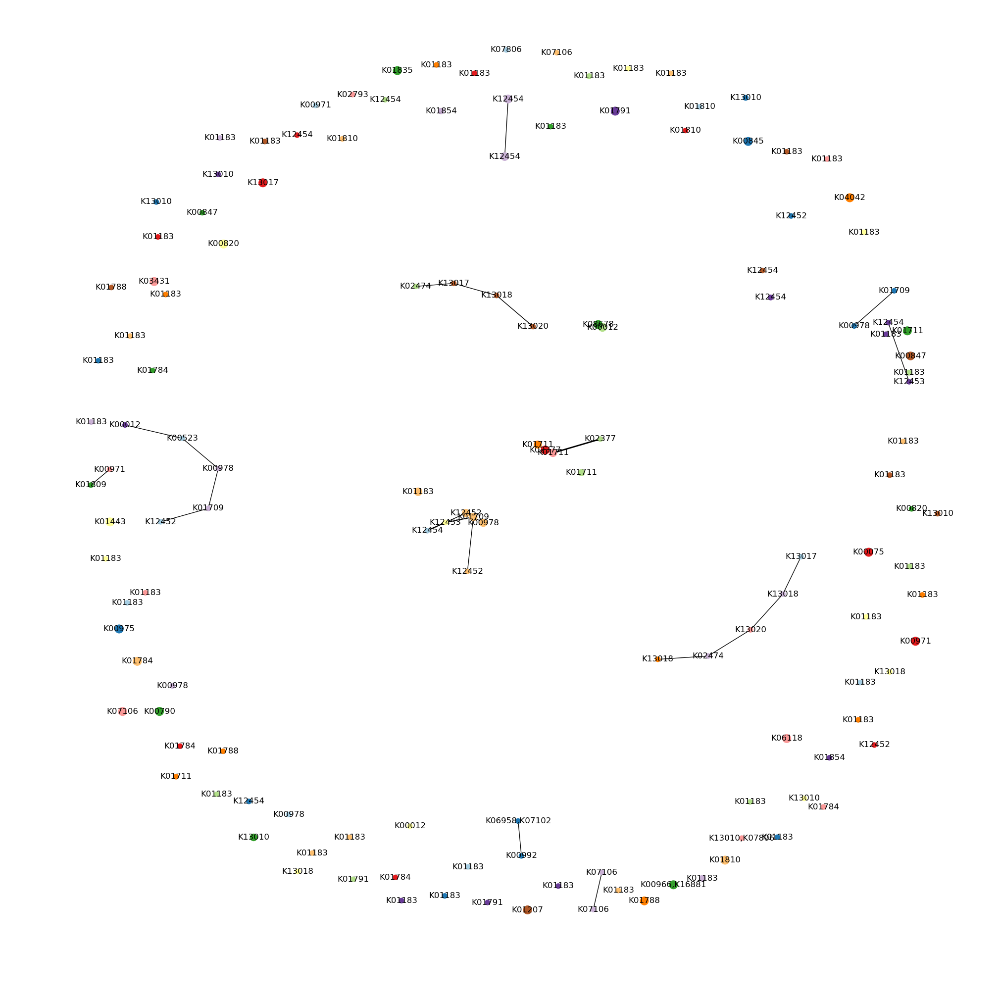

In [26]:
SUM_G = nx.Graph()
SUM_G.add_nodes_from(SUM_node_t) 
#SUM_G.add_nodes_from(SUM_node_tnei) 
SUM_weight_min = min(list(SUM_edge_t.values()) + list(SUM_edge_ex.values())) #list(SUM_edge_tnei.values())
SUM_weight_max = max(list(SUM_edge_t.values()) + list(SUM_edge_ex.values())) #+ list(SUM_edge_tnei.values())
SUM_node_min = min([id_pro_len[i] for i in (SUM_node_t + SUM_node_tC)]) #+ SUM_node_tnei
SUM_node_max = max([id_pro_len[i] for i in (SUM_node_t + SUM_node_tC)]) #+ SUM_node_tnei
#SUM_node_max = min(162, max([id_pro_len[i] for i in (SUM_node_t + SUM_node_tnei + SUM_node_tC)]))
for edge, w in SUM_edge_origin.items():
    SUM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl='o') 
for edge, w in SUM_edge_pre.items():
    SUM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'e') 
#for edge, w in SUM_edge_ex.items():
    #SUM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'C') 
#for edge, w in SUM_edge_tnei.items():
#    SUM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'n') 
    
nx.set_node_attributes(SUM_G, id_SUM_dict_G, 'fun_name')
nx.set_node_attributes(SUM_G, id_C, 'C')
nx.set_node_attributes(SUM_G, id_pro_len, 'pro_len')
#nx.set_node_attributes(SUM_G, id_type, 'C_type')
node_labels = nx.get_node_attributes(SUM_G, 'fun_name')
print('number of nodes: ', SUM_G.number_of_nodes())
print('number of edges: ', SUM_G.number_of_edges())

eorigin=[(u,v) for (u,v,d) in SUM_G.edges(data=True) if d['cl'] == 'o']
eex=[(u,v) for (u,v,d) in SUM_G.edges(data=True) if d['cl'] == 'e']
eC=[(u,v) for (u,v,d) in SUM_G.edges(data=True) if d['cl'] == 'C']
enei=[(u,v) for (u,v,d) in SUM_G.edges(data=True) if d['cl'] == 'n']

SUM_G_connected_node = list()
for c in nx.connected_components(SUM_G):
    nodeSet = SUM_G.subgraph(c).nodes()
    SUM_G_connected_node.append(nodeSet)
print('number of subgraSUM: ', len(SUM_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(SUM_C_t)) 
node_color = [color_palette[SUM_C_t.index(node[1]['C'])] for node in SUM_G.nodes()(data=True)]
node_size = [50 + 950*(node[1]['pro_len'] - SUM_node_min)/(SUM_node_max - SUM_node_min)  for node in SUM_G.nodes()(data=True)]
pos = nx.spring_layout(SUM_G, k=0.2) #,iterations=50
#pos = nx.kamada_kawai_layout(SUM_G)
width_normal = [1 + 5*(float(abs(d['weight'])) - SUM_weight_min)/(SUM_weight_max -SUM_weight_min) for (u,v,d) in SUM_G.edges()(data=True)]
nx.draw(SUM_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        edgelist=eorigin,
        node_color=node_color,
        width=width_normal
       )
#nx.draw_networkx_edge_labels(SUM_pred_G, pos, label_pos=0.5,  rotate=False, font_size=8)
#nx.draw_networkx_edges(SUM_G,pos,edgelist=eex,style = ':',
#                      width= width_normal, alpha=1
#                      )
#nx.draw_networkx_edges(SUM_G,pos,edgelist=eC,style = '--',
#                      width= width_normal, alpha=1
#                      )
#nx.draw_networkx_edges(SUM_G,pos,edgelist=enei,style = '--',
#                      width= width_normal, alpha=0.8
#                      )

number of nodes:  259
number of edges:  2332
number of PPI C:  47
number of subgraSUM:  1


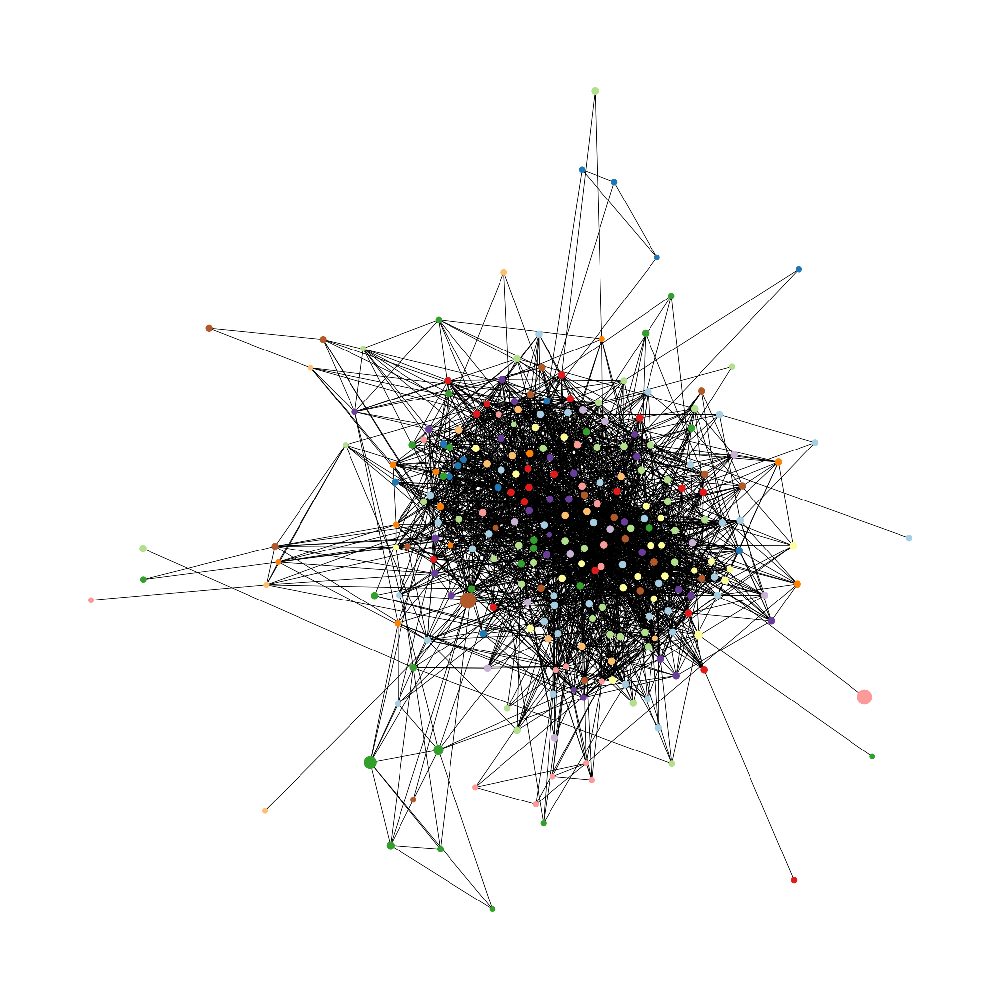

In [27]:
PPI_id_SUM_df = PPI_id_df[(PPI_id_df['C_1'].isin(SUM_C_t)) & (PPI_id_df['C_2'].isin(SUM_C_t))].reset_index(drop=True)
SUM_C_PPI_edge_t = PPI_id_SUM_df.set_index(['node1','node2']).to_dict()['weight']
SUM_C_PPI_node = list(set([str(i) for i in PPI_id_SUM_df['node1'].tolist()] + [str(i) for i in PPI_id_SUM_df['node2'].tolist()]))
SUM_C_PPI_t = list(set([id_C[i] for i in SUM_C_PPI_node]))
SUM_PPI_G = nx.Graph()
#SUM_PPI_G.add_nodes_from(SUM_C_PPI_node) 
SUM_PPI_node_min = min([id_pro_len[i] for i in (SUM_C_PPI_node)])
SUM_PPI_node_max = max([id_pro_len[i] for i in (SUM_C_PPI_node)]) 
for edge, w in SUM_C_PPI_edge_t.items():
    SUM_PPI_G.add_edge(str(edge[0]), str(edge[1]), weight = w)   
#nx.set_node_attributes(SUM_PPI_G, label_dict, 'fun_name')
nx.set_node_attributes(SUM_PPI_G, id_C, 'C')
nx.set_node_attributes(SUM_PPI_G, id_pro_len, 'pro_len')
node_labels = nx.get_node_attributes(SUM_PPI_G, 'fun_name')
print('number of nodes: ', SUM_PPI_G.number_of_nodes())
print('number of edges: ', SUM_PPI_G.number_of_edges())
print('number of PPI C: ', len(SUM_C_PPI_t))


SUM_PPI_G_connected_node = list()
for c in nx.connected_components(SUM_PPI_G):
    nodeSet = SUM_PPI_G.subgraph(c).nodes()
    SUM_PPI_G_connected_node.append(nodeSet)
print('number of subgraSUM: ', len(SUM_PPI_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(SUM_C_PPI_t)) 
node_color = [color_palette[SUM_C_PPI_t.index(node[1]['C'])] for node in SUM_PPI_G.nodes()(data=True)]
node_size = [50 + 450*(node[1]['pro_len'] - SUM_PPI_node_min)/(SUM_PPI_node_max - SUM_PPI_node_min)  for node in SUM_PPI_G.nodes()(data=True)]
pos = nx.spring_layout(SUM_PPI_G, k=2) #,iterations=50
#pos = nx.kamada_kawai_layout(SUM_PPI_G)
nx.draw(SUM_PPI_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        node_color=node_color,
       )

### 微量元素和维生素的同化作用 TEVIT

In [28]:
pro_TEVIT_dict = {}
with open('../function/TEVIT_mis.fasta') as f:
    for line in f:
        line = line.strip('\n')
        if line.startswith('>'):
            pro_TEVIT_dict[line[1:]] = pro_K[line[1:]]
id_TEVIT_dict = {}
for k, v in pro_TEVIT_dict.items():
    if pro_id[k] not in id_TEVIT_dict:
        id_TEVIT_dict[pro_id[k]] = []
    id_TEVIT_dict[pro_id[k]]  = list(set(v+id_TEVIT_dict[pro_id[k]]))
id_TEVIT_dict = {k:v if len(v) != 0 else ['TEVIT?'] for k, v in id_TEVIT_dict.items()}
TEVIT_id_origin = list(id_TEVIT_dict.keys())
C_TEVIT_dict = {}
C_TEVIT_value_dict = {}
C_TEVIT_count_dict = {}
for k, v in id_TEVIT_dict.items():
    if id_C[k] not in C_TEVIT_dict:
        C_TEVIT_dict[id_C[k]] = []
        C_TEVIT_value_dict[id_C[k]] = []
    C_TEVIT_dict[id_C[k]] = list(set(C_TEVIT_dict[id_C[k]] + v))
    C_TEVIT_value_dict[id_C[k]] = C_TEVIT_value_dict[id_C[k]] + v
C_TEVIT_count_dict = {k:dict(Counter(v)) for k, v in C_TEVIT_value_dict.items()}
print('TEVIT pro count: ', len(pro_TEVIT_dict))
print('TEVIT node count: ',len(id_TEVIT_dict))
print('TEVIT C count: ',len(C_TEVIT_dict))

TEVIT_pred_df = pd.read_csv('../function/TEVIT_pred.txt', sep='\t', header=None)
TEVIT_pred_df = TEVIT_pred_df[TEVIT_pred_df[1].isin(pro_TEVIT_dict)]
TEVIT_pred_df['id_1'] = TEVIT_pred_df[0].apply(lambda x:pro_id[x])
TEVIT_pred_df['id_2'] = TEVIT_pred_df[1].apply(lambda x:pro_id[x])
TEVIT_pred_df['func'] = TEVIT_pred_df[1].apply(lambda x: pro_TEVIT_dict[x])
TEVIT_pred_f_df = TEVIT_pred_df[~(TEVIT_pred_df['id_1'].isin(TEVIT_id_origin))].loc[:, ['id_1','id_2','func']].drop_duplicates(subset=['id_1','id_2'])
id_TEVIT_pred_dict = TEVIT_pred_f_df.set_index('id_1').to_dict()['func']
id_TEVIT_pred_dict = {k:v if len(v) != 0 else ['TEVIT?'] for k, v in id_TEVIT_pred_dict.items()}
#id_TEVIT_dict.update(id_TEVIT_pred_dict)

TEVIT_node_origin = TEVIT_id_origin
TEVIT_edge_origin = id_edge_df[(id_edge_df[0].isin(TEVIT_node_origin))&(id_edge_df[1].isin(TEVIT_node_origin))].set_index([0,1]).to_dict()[2]
TEVIT_node_ex = list(id_TEVIT_pred_dict.keys())
TEVIT_node_t = list(id_TEVIT_dict.keys()) + list(id_TEVIT_pred_dict.keys())
TEVIT_edge_t_df = id_edge_df[(id_edge_df[0].isin(TEVIT_node_t))&(id_edge_df[1].isin(TEVIT_node_t))]
TEVIT_edge_t = TEVIT_edge_t_df.set_index([0,1]).to_dict()[2]
TEVIT_edge_pre = TEVIT_edge_t_df[(TEVIT_edge_t_df[0].isin(TEVIT_node_ex))|(TEVIT_edge_t_df[1].isin(TEVIT_node_ex))].set_index([0,1]).to_dict()[2]

TEVIT_C = list(C_TEVIT_dict.keys())
TEVIT_node_oC= [j for i in TEVIT_C for j in C_id[i] if j not in TEVIT_node_origin]
TEVIT_node_tC = [j for i in TEVIT_C for j in C_id[i] if j not in TEVIT_node_t]
TEVIT_edge_df = id_edge_df[(id_edge_df[0].isin(TEVIT_node_origin+TEVIT_node_oC))&(id_edge_df[1].isin(TEVIT_node_origin+TEVIT_node_oC))]
TEVIT_edge = TEVIT_edge_df[(TEVIT_edge_df[0].isin(TEVIT_node_oC))|(TEVIT_edge_df[1].isin(TEVIT_node_oC))].set_index([0,1]).to_dict()[2]
TEVIT_edge_ex_df = id_edge_df[(id_edge_df[0].isin(TEVIT_node_t+TEVIT_node_tC))&(id_edge_df[1].isin(TEVIT_node_t+TEVIT_node_tC))]
TEVIT_edge_ex = TEVIT_edge_ex_df[(TEVIT_edge_ex_df[0].isin(TEVIT_node_tC))|(TEVIT_edge_ex_df[1].isin(TEVIT_node_tC))].set_index([0,1]).to_dict()[2]
TEVIT_C_t = list(set([id_C[i] for i in TEVIT_node_t]))
print('TEVIT ex C count: ',len(TEVIT_C_t))
print('origin node: ', len(TEVIT_node_origin))
print('total node: ', len(TEVIT_node_t))
print('origin edge: ', len(TEVIT_edge_origin))
print('extend edge: ', len(TEVIT_edge_pre))
print('total edge: ', len(TEVIT_edge_t_df))
print('origin C nei node: ', len(TEVIT_node_oC))
print('origin C nei edge: ', len(TEVIT_edge_df))
print('total C nei node: ', len(TEVIT_node_tC))
print('total C nei edge: ', len(TEVIT_edge_ex_df))

TEVIT_node_onei = list(set([nei for node in TEVIT_node_origin for nei in find_nei(proid_G, node)[0]]) - set(TEVIT_node_origin))
TEVIT_node_tnei = list(set([nei for node in TEVIT_node_t for nei in find_nei(proid_G, node)[0]]) - set(TEVIT_node_t))
TEVIT_edge_onei_df = id_edge_df[(id_edge_df[0].isin(TEVIT_node_origin+TEVIT_node_onei))&(id_edge_df[1].isin(TEVIT_node_origin+TEVIT_node_onei))]
#TEVIT_edge_onei = TEVIT_edge_onei_df[TEVIT_edge_onei_df[0].isin(TEVIT_node_onei) | TEVIT_edge_onei_df[1].isin(TEVIT_node_onei)].set_index([0,1]).to_dict()[2]
TEVIT_edge_tnei_df = id_edge_df[(id_edge_df[0].isin(TEVIT_node_t+TEVIT_node_tnei))&(id_edge_df[1].isin(TEVIT_node_t+TEVIT_node_tnei))]
#TEVIT_edge_tnei = TEVIT_edge_tnei_df[TEVIT_edge_tnei_df[0].isin(TEVIT_node_tnei) | TEVIT_edge_tnei_df[1].isin(TEVIT_node_tnei)].set_index([0,1]).to_dict()[2]
TEVIT_GC_t =list(set([id_C[i] for i in TEVIT_node_t+TEVIT_node_tnei]))
print('origin  nei node: ', len(TEVIT_node_onei))
print('origin  nei edge: ', len(TEVIT_edge_onei_df))
print('total  nei node: ', len(TEVIT_node_tnei))
print('total  nei edge: ', len(TEVIT_edge_tnei_df))

TEVIT_PPI_o_df = PPI_id_df[(PPI_id_df['node1'].isin(TEVIT_node_origin))&(PPI_id_df['node2'].isin(TEVIT_node_origin))]
TEVIT_PPI_t_df = PPI_id_df[(PPI_id_df['node1'].isin(TEVIT_node_t))&(PPI_id_df['node2'].isin(TEVIT_node_t))]
TEVIT_node_o_PPI = list(set(TEVIT_PPI_o_df['node1'].tolist() + TEVIT_PPI_o_df['node2'].tolist()))
TEVIT_node_t_PPI = list(set(TEVIT_PPI_t_df['node1'].tolist() + TEVIT_PPI_t_df['node2'].tolist()))
print('PPI orign node: ', len(TEVIT_node_o_PPI))
print('PPI total node: ', len(TEVIT_node_t_PPI))
print('PPI orign edge: ', len(TEVIT_PPI_o_df))
print('PPI total edge: ', len(TEVIT_PPI_t_df)) 
id_TEVIT_t_dict = {k:id_TEVIT_dict[k] if k in id_TEVIT_dict else id_TEVIT_pred_dict[k] for k in TEVIT_node_t}
id_TEVIT_dict_G = {k:','.join(v) + ' **' if int(k) in TEVIT_node_t_PPI  else ','.join(v) for k, v in id_TEVIT_t_dict.items()}

TEVIT pro count:  26317
TEVIT node count:  275
TEVIT C count:  248
TEVIT ex C count:  319
origin node:  275
total node:  358
origin edge:  44
extend edge:  45
total edge:  89
origin C nei node:  2579
origin C nei edge:  2899
total C nei node:  2570
total C nei edge:  2995
origin  nei node:  2630
origin  nei edge:  7417
total  nei node:  2818
total  nei edge:  8162
PPI orign node:  167
PPI total node:  174
PPI orign edge:  2813
PPI total edge:  2869


number of nodes:  358
number of edges:  89
number of subgraTEVIT:  272


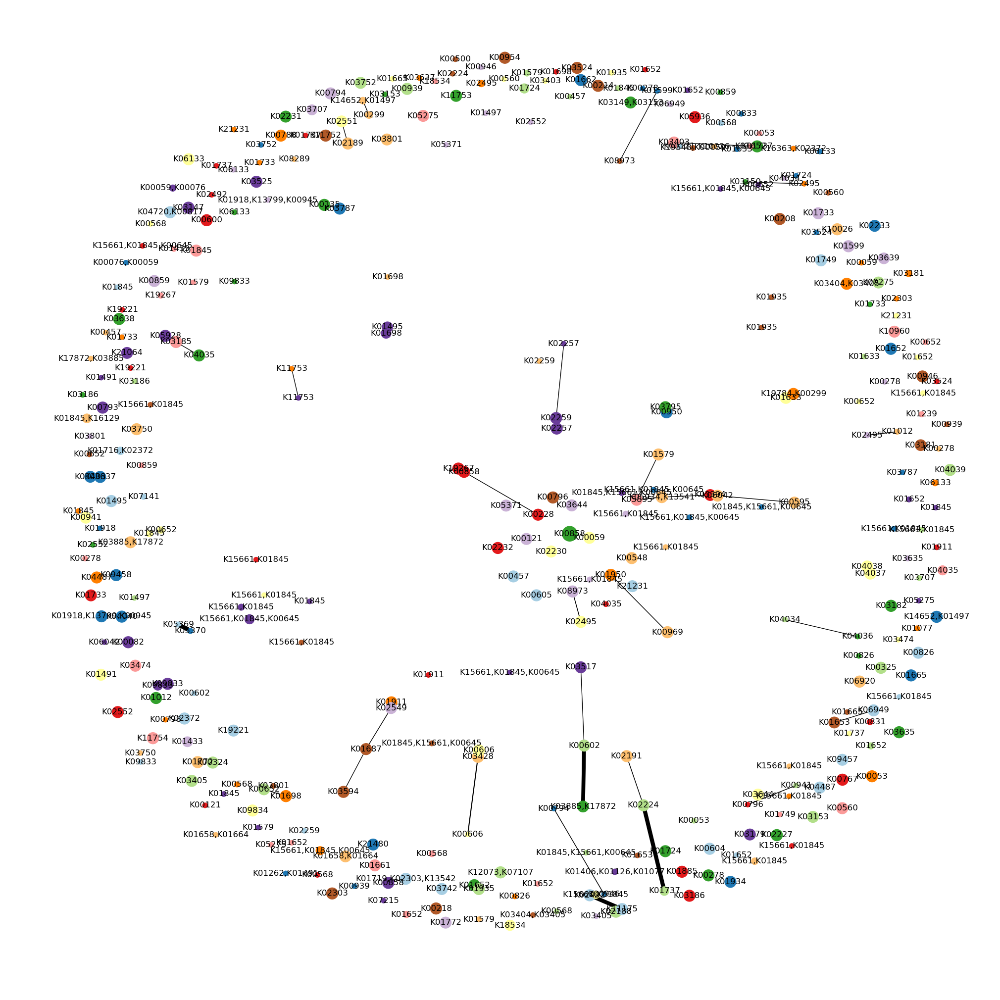

In [29]:
TEVIT_G = nx.Graph()
TEVIT_G.add_nodes_from(TEVIT_node_t) 
#TEVIT_G.add_nodes_from(TEVIT_node_tnei) 
TEVIT_weight_min = min(list(TEVIT_edge_t.values()) + list(TEVIT_edge_ex.values())) #list(TEVIT_edge_tnei.values())
TEVIT_weight_max = max(list(TEVIT_edge_t.values()) + list(TEVIT_edge_ex.values())) #+ list(TEVIT_edge_tnei.values())
TEVIT_node_min = min([id_pro_len[i] for i in (TEVIT_node_t + TEVIT_node_tC)]) #+ TEVIT_node_tnei
TEVIT_node_max = max([id_pro_len[i] for i in (TEVIT_node_t + TEVIT_node_tC)]) #+ TEVIT_node_tnei
#TEVIT_node_max = min(162, max([id_pro_len[i] for i in (TEVIT_node_t + TEVIT_node_tnei + TEVIT_node_tC)]))
for edge, w in TEVIT_edge_origin.items():
    TEVIT_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl='o') 
for edge, w in TEVIT_edge_pre.items():
    TEVIT_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'e') 
#for edge, w in TEVIT_edge_ex.items():
    #TEVIT_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'C') 
#for edge, w in TEVIT_edge_tnei.items():
#    TEVIT_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'n') 
    
nx.set_node_attributes(TEVIT_G, id_TEVIT_dict_G, 'fun_name')
nx.set_node_attributes(TEVIT_G, id_C, 'C')
nx.set_node_attributes(TEVIT_G, id_pro_len, 'pro_len')
#nx.set_node_attributes(TEVIT_G, id_type, 'C_type')
node_labels = nx.get_node_attributes(TEVIT_G, 'fun_name')
print('number of nodes: ', TEVIT_G.number_of_nodes())
print('number of edges: ', TEVIT_G.number_of_edges())

eorigin=[(u,v) for (u,v,d) in TEVIT_G.edges(data=True) if d['cl'] == 'o']
eex=[(u,v) for (u,v,d) in TEVIT_G.edges(data=True) if d['cl'] == 'e']
eC=[(u,v) for (u,v,d) in TEVIT_G.edges(data=True) if d['cl'] == 'C']
enei=[(u,v) for (u,v,d) in TEVIT_G.edges(data=True) if d['cl'] == 'n']

TEVIT_G_connected_node = list()
for c in nx.connected_components(TEVIT_G):
    nodeSet = TEVIT_G.subgraph(c).nodes()
    TEVIT_G_connected_node.append(nodeSet)
print('number of subgraTEVIT: ', len(TEVIT_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(TEVIT_C_t)) 
node_color = [color_palette[TEVIT_C_t.index(node[1]['C'])] for node in TEVIT_G.nodes()(data=True)]
node_size = [50 + 950*(node[1]['pro_len'] - TEVIT_node_min)/(TEVIT_node_max - TEVIT_node_min)  for node in TEVIT_G.nodes()(data=True)]
pos = nx.spring_layout(TEVIT_G, k=0.2) #,iterations=50
#pos = nx.kamada_kawai_layout(TEVIT_G)
width_normal = [1 + 5*(float(abs(d['weight'])) - TEVIT_weight_min)/(TEVIT_weight_max -TEVIT_weight_min) for (u,v,d) in TEVIT_G.edges()(data=True)]
nx.draw(TEVIT_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        edgelist=eorigin,
        node_color=node_color,
        width=width_normal
       )
#nx.draw_networkx_edge_labels(TEVIT_pred_G, pos, label_pos=0.5,  rotate=False, font_size=8)
#nx.draw_networkx_edges(TEVIT_G,pos,edgelist=eex,style = ':',
#                      width= width_normal, alpha=1
#                      )
#nx.draw_networkx_edges(TEVIT_G,pos,edgelist=eC,style = '--',
#                      width= width_normal, alpha=1
#                      )
#nx.draw_networkx_edges(TEVIT_G,pos,edgelist=enei,style = '--',
#                      width= width_normal, alpha=0.8
#                      )

number of nodes:  979
number of edges:  28920
number of PPI C:  176
number of subgraTEVIT:  8


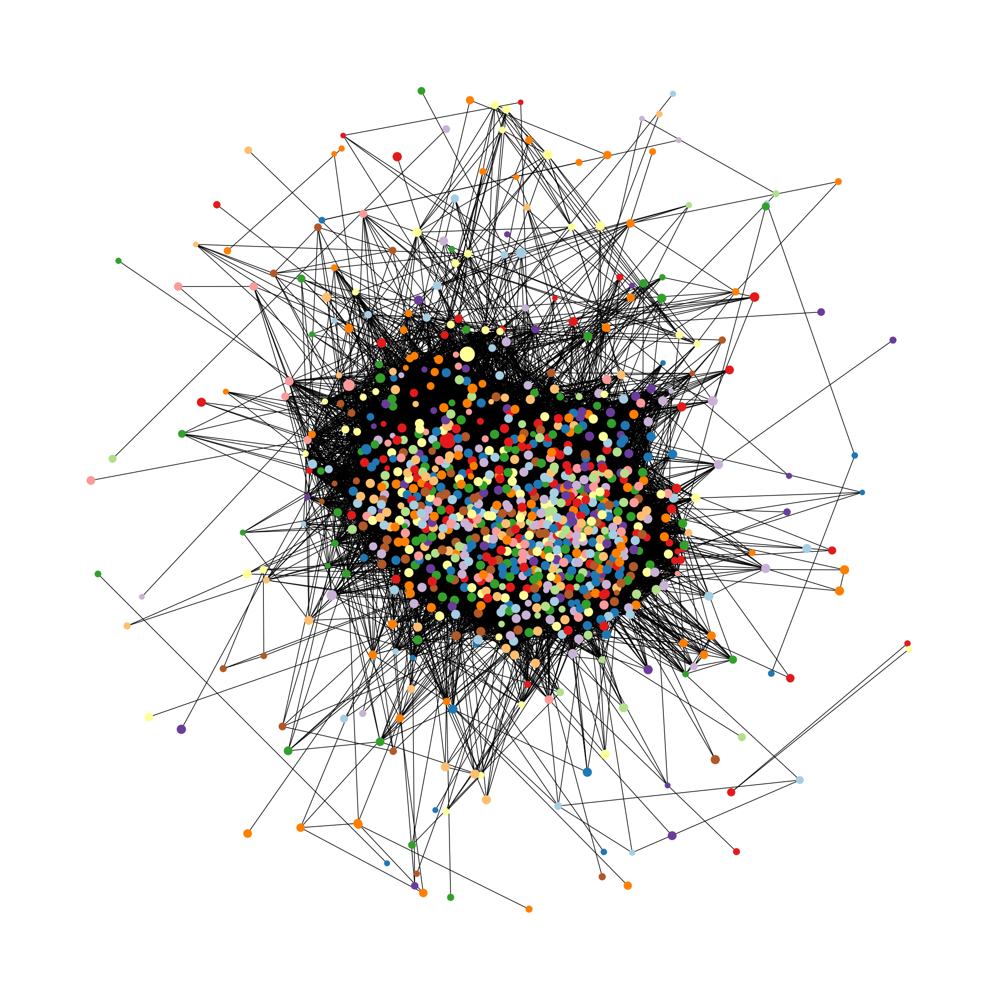

In [30]:
PPI_id_TEVIT_df = PPI_id_df[(PPI_id_df['C_1'].isin(TEVIT_C_t)) & (PPI_id_df['C_2'].isin(TEVIT_C_t))].reset_index(drop=True)
TEVIT_C_PPI_edge_t = PPI_id_TEVIT_df.set_index(['node1','node2']).to_dict()['weight']
TEVIT_C_PPI_node = list(set([str(i) for i in PPI_id_TEVIT_df['node1'].tolist()] + [str(i) for i in PPI_id_TEVIT_df['node2'].tolist()]))
TEVIT_C_PPI_t = list(set([id_C[i] for i in TEVIT_C_PPI_node]))
TEVIT_PPI_G = nx.Graph()
#TEVIT_PPI_G.add_nodes_from(TEVIT_C_PPI_node) 
TEVIT_PPI_node_min = min([id_pro_len[i] for i in (TEVIT_C_PPI_node)])
TEVIT_PPI_node_max = max([id_pro_len[i] for i in (TEVIT_C_PPI_node)]) 
for edge, w in TEVIT_C_PPI_edge_t.items():
    TEVIT_PPI_G.add_edge(str(edge[0]), str(edge[1]), weight = w)   
#nx.set_node_attributes(TEVIT_PPI_G, label_dict, 'fun_name')
nx.set_node_attributes(TEVIT_PPI_G, id_C, 'C')
nx.set_node_attributes(TEVIT_PPI_G, id_pro_len, 'pro_len')
node_labels = nx.get_node_attributes(TEVIT_PPI_G, 'fun_name')
print('number of nodes: ', TEVIT_PPI_G.number_of_nodes())
print('number of edges: ', TEVIT_PPI_G.number_of_edges())
print('number of PPI C: ', len(TEVIT_C_PPI_t))


TEVIT_PPI_G_connected_node = list()
for c in nx.connected_components(TEVIT_PPI_G):
    nodeSet = TEVIT_PPI_G.subgraph(c).nodes()
    TEVIT_PPI_G_connected_node.append(nodeSet)
print('number of subgraTEVIT: ', len(TEVIT_PPI_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(TEVIT_C_PPI_t)) 
node_color = [color_palette[TEVIT_C_PPI_t.index(node[1]['C'])] for node in TEVIT_PPI_G.nodes()(data=True)]
node_size = [50 + 450*(node[1]['pro_len'] - TEVIT_PPI_node_min)/(TEVIT_PPI_node_max - TEVIT_PPI_node_min)  for node in TEVIT_PPI_G.nodes()(data=True)]
pos = nx.spring_layout(TEVIT_PPI_G, k=2) #,iterations=50
#pos = nx.kamada_kawai_layout(TEVIT_PPI_G)
nx.draw(TEVIT_PPI_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        node_color=node_color,
       )

### 甲烷代谢 MM

In [31]:
pro_MM_dict = {}
with open('../function/MM_mis.fasta') as f:
    for line in f:
        line = line.strip('\n')
        if line.startswith('>'):
            pro_MM_dict[line[1:]] = pro_K[line[1:]]
id_MM_dict = {}
for k, v in pro_MM_dict.items():
    if pro_id[k] not in id_MM_dict:
        id_MM_dict[pro_id[k]] = []
    id_MM_dict[pro_id[k]]  = list(set(v+id_MM_dict[pro_id[k]]))
id_MM_dict = {k:v if len(v) != 0 else ['MM?'] for k, v in id_MM_dict.items()}
MM_id_origin = list(id_MM_dict.keys())
C_MM_dict = {}
C_MM_value_dict = {}
C_MM_count_dict = {}
for k, v in id_MM_dict.items():
    if id_C[k] not in C_MM_dict:
        C_MM_dict[id_C[k]] = []
        C_MM_value_dict[id_C[k]] = []
    C_MM_dict[id_C[k]] = list(set(C_MM_dict[id_C[k]] + v))
    C_MM_value_dict[id_C[k]] = C_MM_value_dict[id_C[k]] + v
C_MM_count_dict = {k:dict(Counter(v)) for k, v in C_MM_value_dict.items()}
print('MM pro count: ', len(pro_MM_dict))
print('MM node count: ',len(id_MM_dict))
print('MM C count: ',len(C_MM_dict))

MM_pred_df = pd.read_csv('../function/MM_pred.txt', sep='\t', header=None)
MM_pred_df = MM_pred_df[MM_pred_df[1].isin(pro_MM_dict)]
MM_pred_df['id_1'] = MM_pred_df[0].apply(lambda x:pro_id[x])
MM_pred_df['id_2'] = MM_pred_df[1].apply(lambda x:pro_id[x])
MM_pred_df['func'] = MM_pred_df[1].apply(lambda x: pro_MM_dict[x])
MM_pred_f_df = MM_pred_df[~(MM_pred_df['id_1'].isin(MM_id_origin))].loc[:, ['id_1','id_2','func']].drop_duplicates(subset=['id_1','id_2'])
id_MM_pred_dict = MM_pred_f_df.set_index('id_1').to_dict()['func']
id_MM_pred_dict = {k:v if len(v) != 0 else ['MM?'] for k, v in id_MM_pred_dict.items()}
#id_MM_dict.update(id_MM_pred_dict)

MM_node_origin = MM_id_origin
MM_edge_origin = id_edge_df[(id_edge_df[0].isin(MM_node_origin))&(id_edge_df[1].isin(MM_node_origin))].set_index([0,1]).to_dict()[2]
MM_node_ex = list(id_MM_pred_dict.keys())
MM_node_t = list(id_MM_dict.keys()) + list(id_MM_pred_dict.keys())
MM_edge_t_df = id_edge_df[(id_edge_df[0].isin(MM_node_t))&(id_edge_df[1].isin(MM_node_t))]
MM_edge_t = MM_edge_t_df.set_index([0,1]).to_dict()[2]
MM_edge_pre = MM_edge_t_df[(MM_edge_t_df[0].isin(MM_node_ex))|(MM_edge_t_df[1].isin(MM_node_ex))].set_index([0,1]).to_dict()[2]

MM_C = list(C_MM_dict.keys())
MM_node_oC= [j for i in MM_C for j in C_id[i] if j not in MM_node_origin]
MM_node_tC = [j for i in MM_C for j in C_id[i] if j not in MM_node_t]
MM_edge_df = id_edge_df[(id_edge_df[0].isin(MM_node_origin+MM_node_oC))&(id_edge_df[1].isin(MM_node_origin+MM_node_oC))]
MM_edge = MM_edge_df[(MM_edge_df[0].isin(MM_node_oC))|(MM_edge_df[1].isin(MM_node_oC))].set_index([0,1]).to_dict()[2]
MM_edge_ex_df = id_edge_df[(id_edge_df[0].isin(MM_node_t+MM_node_tC))&(id_edge_df[1].isin(MM_node_t+MM_node_tC))]
MM_edge_ex = MM_edge_ex_df[(MM_edge_ex_df[0].isin(MM_node_tC))|(MM_edge_ex_df[1].isin(MM_node_tC))].set_index([0,1]).to_dict()[2]
MM_C_t = list(set([id_C[i] for i in MM_node_t]))
print('MM ex C count: ',len(MM_C_t))
print('origin node: ', len(MM_node_origin))
print('total node: ', len(MM_node_t))
print('origin edge: ', len(MM_edge_origin))
print('extend edge: ', len(MM_edge_pre))
print('total edge: ', len(MM_edge_t_df))
print('origin C nei node: ', len(MM_node_oC))
print('origin C nei edge: ', len(MM_edge_df))
print('total C nei node: ', len(MM_node_tC))
print('total C nei edge: ', len(MM_edge_ex_df))

MM_node_onei = list(set([nei for node in MM_node_origin for nei in find_nei(proid_G, node)[0]]) - set(MM_node_origin))
MM_node_tnei = list(set([nei for node in MM_node_t for nei in find_nei(proid_G, node)[0]]) - set(MM_node_t))
MM_edge_onei_df = id_edge_df[(id_edge_df[0].isin(MM_node_origin+MM_node_onei))&(id_edge_df[1].isin(MM_node_origin+MM_node_onei))]
#MM_edge_onei = MM_edge_onei_df[MM_edge_onei_df[0].isin(MM_node_onei) | MM_edge_onei_df[1].isin(MM_node_onei)].set_index([0,1]).to_dict()[2]
MM_edge_tnei_df = id_edge_df[(id_edge_df[0].isin(MM_node_t+MM_node_tnei))&(id_edge_df[1].isin(MM_node_t+MM_node_tnei))]
#MM_edge_tnei = MM_edge_tnei_df[MM_edge_tnei_df[0].isin(MM_node_tnei) | MM_edge_tnei_df[1].isin(MM_node_tnei)].set_index([0,1]).to_dict()[2]
MM_GC_t =list(set([id_C[i] for i in MM_node_t+MM_node_tnei]))
print('origin  nei node: ', len(MM_node_onei))
print('origin  nei edge: ', len(MM_edge_onei_df))
print('total  nei node: ', len(MM_node_tnei))
print('total  nei edge: ', len(MM_edge_tnei_df))

MM_PPI_o_df = PPI_id_df[(PPI_id_df['node1'].isin(MM_node_origin))&(PPI_id_df['node2'].isin(MM_node_origin))]
MM_PPI_t_df = PPI_id_df[(PPI_id_df['node1'].isin(MM_node_t))&(PPI_id_df['node2'].isin(MM_node_t))]
MM_node_o_PPI = list(set(MM_PPI_o_df['node1'].tolist() + MM_PPI_o_df['node2'].tolist()))
MM_node_t_PPI = list(set(MM_PPI_t_df['node1'].tolist() + MM_PPI_t_df['node2'].tolist()))
print('PPI orign node: ', len(MM_node_o_PPI))
print('PPI total node: ', len(MM_node_t_PPI))
print('PPI orign edge: ', len(MM_PPI_o_df))
print('PPI total edge: ', len(MM_PPI_t_df)) 
id_MM_t_dict = {k:id_MM_dict[k] if k in id_MM_dict else id_MM_pred_dict[k] for k in MM_node_t}
id_MM_dict_G = {k:','.join(v) + ' **' if int(k) in MM_node_t_PPI  else ','.join(v) for k, v in id_MM_t_dict.items()}

MM pro count:  3305
MM node count:  40
MM C count:  39
MM ex C count:  43
origin node:  40
total node:  44
origin edge:  3
extend edge:  1
total edge:  4
origin C nei node:  362
origin C nei edge:  162
total C nei node:  362
total C nei edge:  166
origin  nei node:  485
origin  nei edge:  1096
total  nei node:  484
total  nei edge:  1099
PPI orign node:  19
PPI total node:  19
PPI orign edge:  109
PPI total edge:  109


number of nodes:  44
number of edges:  4
number of subgraMM:  40


"\nnx.draw_networkx_edges(MM_G,pos,edgelist=eex,style = ':',\n                      width= width_normal, alpha=1\n                      )\nnx.draw_networkx_edges(MM_G,pos,edgelist=eC,style = '--',\n                      width= width_normal, alpha=1\n                      )\nnx.draw_networkx_edges(MM_G,pos,edgelist=enei,style = '--',\n                      width= width_normal, alpha=0.8\n                      )\n"

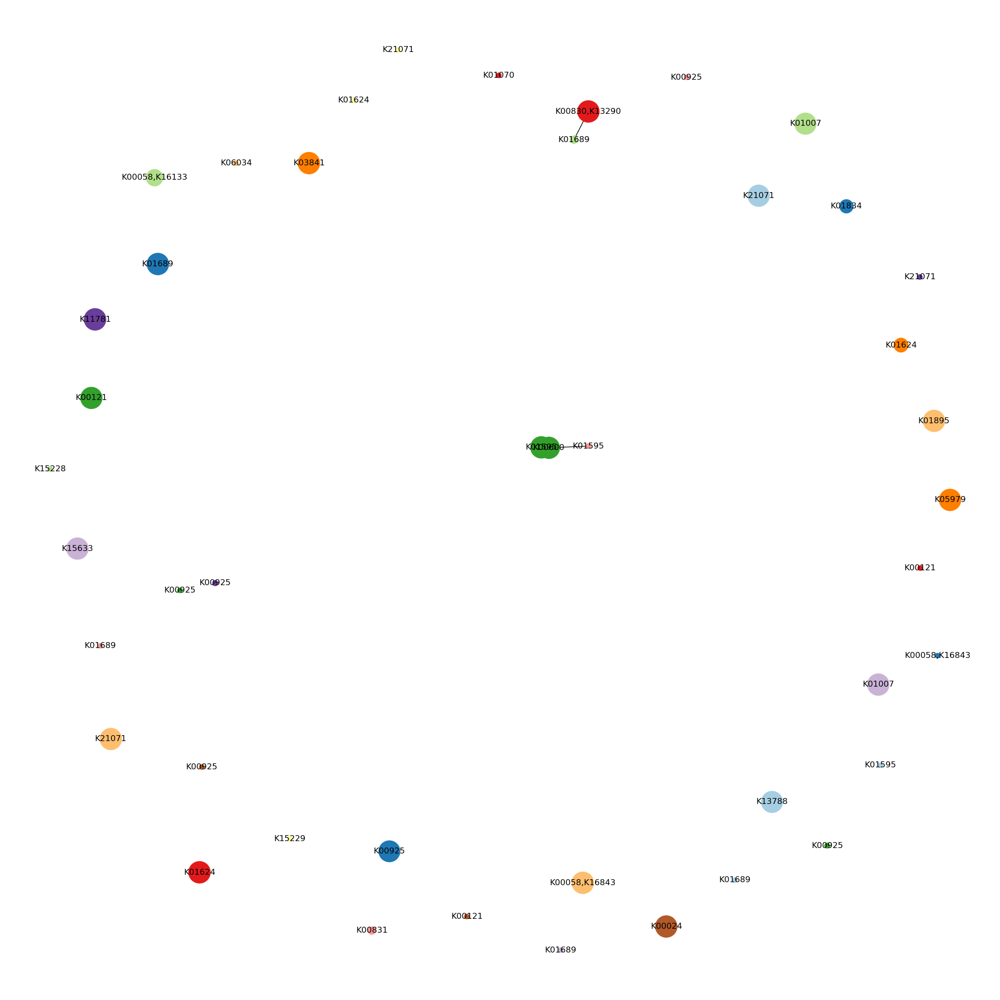

In [32]:
MM_G = nx.Graph()
MM_G.add_nodes_from(MM_node_t) 
#MM_G.add_nodes_from(MM_node_tnei) 
MM_weight_min = min(list(MM_edge_t.values()) + list(MM_edge_ex.values())) #list(MM_edge_tnei.values())
MM_weight_max = max(list(MM_edge_t.values()) + list(MM_edge_ex.values())) #+ list(MM_edge_tnei.values())
MM_node_min = min([id_pro_len[i] for i in (MM_node_t + MM_node_tC)]) #+ MM_node_tnei
MM_node_max = max([id_pro_len[i] for i in (MM_node_t + MM_node_tC)]) #+ MM_node_tnei
#MM_node_max = min(162, max([id_pro_len[i] for i in (MM_node_t + MM_node_tnei + MM_node_tC)]))
for edge, w in MM_edge_origin.items():
    MM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl='o') 
for edge, w in MM_edge_pre.items():
    MM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'e') 
#for edge, w in MM_edge_ex.items():
    #MM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'C') 
#for edge, w in MM_edge_tnei.items():
#    MM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'n') 
    
nx.set_node_attributes(MM_G, id_MM_dict_G, 'fun_name')
nx.set_node_attributes(MM_G, id_C, 'C')
nx.set_node_attributes(MM_G, id_pro_len, 'pro_len')
#nx.set_node_attributes(MM_G, id_type, 'C_type')
node_labels = nx.get_node_attributes(MM_G, 'fun_name')
print('number of nodes: ', MM_G.number_of_nodes())
print('number of edges: ', MM_G.number_of_edges())

eorigin=[(u,v) for (u,v,d) in MM_G.edges(data=True) if d['cl'] == 'o']
eex=[(u,v) for (u,v,d) in MM_G.edges(data=True) if d['cl'] == 'e']
eC=[(u,v) for (u,v,d) in MM_G.edges(data=True) if d['cl'] == 'C']
enei=[(u,v) for (u,v,d) in MM_G.edges(data=True) if d['cl'] == 'n']

MM_G_connected_node = list()
for c in nx.connected_components(MM_G):
    nodeSet = MM_G.subgraph(c).nodes()
    MM_G_connected_node.append(nodeSet)
print('number of subgraMM: ', len(MM_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(MM_C_t)) 
node_color = [color_palette[MM_C_t.index(node[1]['C'])] for node in MM_G.nodes()(data=True)]
node_size = [50 + 950*(node[1]['pro_len'] - MM_node_min)/(MM_node_max - MM_node_min)  for node in MM_G.nodes()(data=True)]
pos = nx.spring_layout(MM_G, k=0.2) #,iterations=50
#pos = nx.kamada_kawai_layout(MM_G)
width_normal = [1 + 5*(float(abs(d['weight'])) - MM_weight_min)/(MM_weight_max -MM_weight_min) for (u,v,d) in MM_G.edges()(data=True)]
nx.draw(MM_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        edgelist=eorigin,
        node_color=node_color,
        width=width_normal
       )
#nx.draw_networkx_edge_labels(MM_pred_G, pos, label_pos=0.5,  rotate=False, font_size=8)
'''
nx.draw_networkx_edges(MM_G,pos,edgelist=eex,style = ':',
                      width= width_normal, alpha=1
                      )
nx.draw_networkx_edges(MM_G,pos,edgelist=eC,style = '--',
                      width= width_normal, alpha=1
                      )
nx.draw_networkx_edges(MM_G,pos,edgelist=enei,style = '--',
                      width= width_normal, alpha=0.8
                      )
'''

number of nodes:  92
number of edges:  496
number of PPI C:  23
number of subgraMM:  2


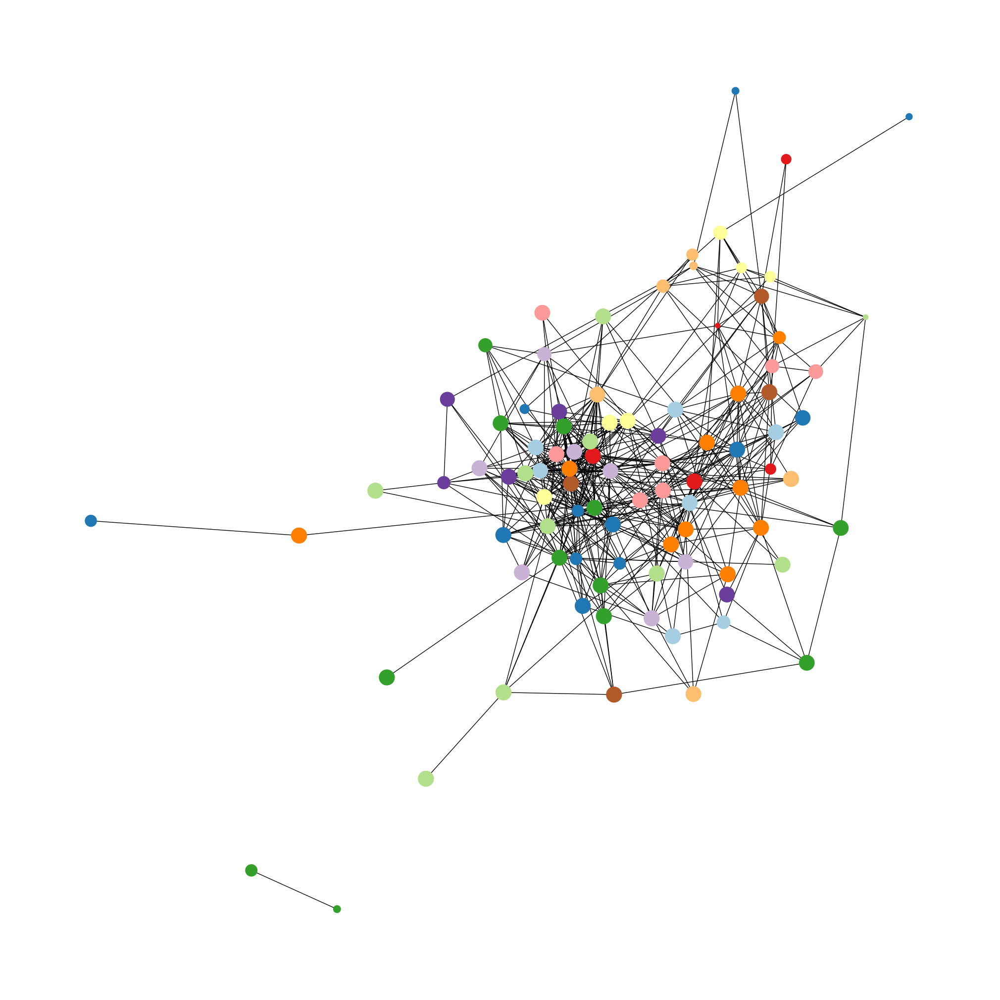

In [33]:
PPI_id_MM_df = PPI_id_df[(PPI_id_df['C_1'].isin(MM_C_t)) & (PPI_id_df['C_2'].isin(MM_C_t))].reset_index(drop=True)
MM_C_PPI_edge_t = PPI_id_MM_df.set_index(['node1','node2']).to_dict()['weight']
MM_C_PPI_node = list(set([str(i) for i in PPI_id_MM_df['node1'].tolist()] + [str(i) for i in PPI_id_MM_df['node2'].tolist()]))
MM_C_PPI_t = list(set([id_C[i] for i in MM_C_PPI_node]))
MM_PPI_G = nx.Graph()
#MM_PPI_G.add_nodes_from(MM_C_PPI_node) 
MM_PPI_node_min = min([id_pro_len[i] for i in (MM_C_PPI_node)])
MM_PPI_node_max = max([id_pro_len[i] for i in (MM_C_PPI_node)]) 
for edge, w in MM_C_PPI_edge_t.items():
    MM_PPI_G.add_edge(str(edge[0]), str(edge[1]), weight = w)   
#nx.set_node_attributes(MM_PPI_G, label_dict, 'fun_name')
nx.set_node_attributes(MM_PPI_G, id_C, 'C')
nx.set_node_attributes(MM_PPI_G, id_pro_len, 'pro_len')
node_labels = nx.get_node_attributes(MM_PPI_G, 'fun_name')
print('number of nodes: ', MM_PPI_G.number_of_nodes())
print('number of edges: ', MM_PPI_G.number_of_edges())
print('number of PPI C: ', len(MM_C_PPI_t))


MM_PPI_G_connected_node = list()
for c in nx.connected_components(MM_PPI_G):
    nodeSet = MM_PPI_G.subgraph(c).nodes()
    MM_PPI_G_connected_node.append(nodeSet)
print('number of subgraMM: ', len(MM_PPI_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(MM_C_PPI_t)) 
node_color = [color_palette[MM_C_PPI_t.index(node[1]['C'])] for node in MM_PPI_G.nodes()(data=True)]
node_size = [50 + 450*(node[1]['pro_len'] - MM_PPI_node_min)/(MM_PPI_node_max - MM_PPI_node_min)  for node in MM_PPI_G.nodes()(data=True)]
pos = nx.spring_layout(MM_PPI_G, k=2) #,iterations=50
#pos = nx.kamada_kawai_layout(MM_PPI_G)
nx.draw(MM_PPI_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        node_color=node_color,
       )

###  CO2浓缩机制 CCM

In [34]:
pro_CCM_dict = {}
with open('../function/CCM_mis.fasta') as f:
    for line in f:
        line = line.strip('\n')
        if line.startswith('>'):
            pro_CCM_dict[line[1:]] = pro_K[line[1:]]
id_CCM_dict = {}
for k, v in pro_CCM_dict.items():
    if pro_id[k] not in id_CCM_dict:
        id_CCM_dict[pro_id[k]] = []
    id_CCM_dict[pro_id[k]]  = list(set(v+id_CCM_dict[pro_id[k]]))
id_CCM_dict = {k:v if len(v) != 0 else ['CCM?'] for k, v in id_CCM_dict.items()}
CCM_id_origin = list(id_CCM_dict.keys())
C_CCM_dict = {}
C_CCM_value_dict = {}
C_CCM_count_dict = {}
for k, v in id_CCM_dict.items():
    if id_C[k] not in C_CCM_dict:
        C_CCM_dict[id_C[k]] = []
        C_CCM_value_dict[id_C[k]] = []
    C_CCM_dict[id_C[k]] = list(set(C_CCM_dict[id_C[k]] + v))
    C_CCM_value_dict[id_C[k]] = C_CCM_value_dict[id_C[k]] + v
C_CCM_count_dict = {k:dict(Counter(v)) for k, v in C_CCM_value_dict.items()}
print('CCM pro count: ', len(pro_CCM_dict))
print('CCM node count: ',len(id_CCM_dict))
print('CCM C count: ',len(C_CCM_dict))

CCM_pred_df = pd.read_csv('../function/CCM_pred.txt', sep='\t', header=None)
CCM_pred_df = CCM_pred_df[CCM_pred_df[1].isin(pro_CCM_dict)]
CCM_pred_df['id_1'] = CCM_pred_df[0].apply(lambda x:pro_id[x])
CCM_pred_df['id_2'] = CCM_pred_df[1].apply(lambda x:pro_id[x])
CCM_pred_df['func'] = CCM_pred_df[1].apply(lambda x: pro_CCM_dict[x])
CCM_pred_f_df = CCM_pred_df[~(CCM_pred_df['id_1'].isin(CCM_id_origin))].loc[:, ['id_1','id_2','func']].drop_duplicates(subset=['id_1','id_2'])
id_CCM_pred_dict = CCM_pred_f_df.set_index('id_1').to_dict()['func']
id_CCM_pred_dict = {k:v if len(v) != 0 else ['CCM?'] for k, v in id_CCM_pred_dict.items()}
#id_CCM_dict.update(id_CCM_pred_dict)

CCM_node_origin = CCM_id_origin
CCM_edge_origin = id_edge_df[(id_edge_df[0].isin(CCM_node_origin))&(id_edge_df[1].isin(CCM_node_origin))].set_index([0,1]).to_dict()[2]
CCM_node_ex = list(id_CCM_pred_dict.keys())
CCM_node_t = list(id_CCM_dict.keys()) + list(id_CCM_pred_dict.keys())
CCM_edge_t_df = id_edge_df[(id_edge_df[0].isin(CCM_node_t))&(id_edge_df[1].isin(CCM_node_t))]
CCM_edge_t = CCM_edge_t_df.set_index([0,1]).to_dict()[2]
CCM_edge_pre = CCM_edge_t_df[(CCM_edge_t_df[0].isin(CCM_node_ex))|(CCM_edge_t_df[1].isin(CCM_node_ex))].set_index([0,1]).to_dict()[2]

CCM_C = list(C_CCM_dict.keys())
CCM_node_oC= [j for i in CCM_C for j in C_id[i] if j not in CCM_node_origin]
CCM_node_tC = [j for i in CCM_C for j in C_id[i] if j not in CCM_node_t]
CCM_edge_df = id_edge_df[(id_edge_df[0].isin(CCM_node_origin+CCM_node_oC))&(id_edge_df[1].isin(CCM_node_origin+CCM_node_oC))]
CCM_edge = CCM_edge_df[(CCM_edge_df[0].isin(CCM_node_oC))|(CCM_edge_df[1].isin(CCM_node_oC))].set_index([0,1]).to_dict()[2]
CCM_edge_ex_df = id_edge_df[(id_edge_df[0].isin(CCM_node_t+CCM_node_tC))&(id_edge_df[1].isin(CCM_node_t+CCM_node_tC))]
CCM_edge_ex = CCM_edge_ex_df[(CCM_edge_ex_df[0].isin(CCM_node_tC))|(CCM_edge_ex_df[1].isin(CCM_node_tC))].set_index([0,1]).to_dict()[2]
CCM_C_t = list(set([id_C[i] for i in CCM_node_t]))
print('CCM ex C count: ',len(CCM_C_t))
print('origin node: ', len(CCM_node_origin))
print('total node: ', len(CCM_node_t))
print('origin edge: ', len(CCM_edge_origin))
print('extend edge: ', len(CCM_edge_pre))
print('total edge: ', len(CCM_edge_t_df))
print('origin C nei node: ', len(CCM_node_oC))
print('origin C nei edge: ', len(CCM_edge_df))
print('total C nei node: ', len(CCM_node_tC))
print('total C nei edge: ', len(CCM_edge_ex_df))

CCM_node_onei = list(set([nei for node in CCM_node_origin for nei in find_nei(proid_G, node)[0]]) - set(CCM_node_origin))
CCM_node_tnei = list(set([nei for node in CCM_node_t for nei in find_nei(proid_G, node)[0]]) - set(CCM_node_t))
CCM_edge_onei_df = id_edge_df[(id_edge_df[0].isin(CCM_node_origin+CCM_node_onei))&(id_edge_df[1].isin(CCM_node_origin+CCM_node_onei))]
#CCM_edge_onei = CCM_edge_onei_df[CCM_edge_onei_df[0].isin(CCM_node_onei) | CCM_edge_onei_df[1].isin(CCM_node_onei)].set_index([0,1]).to_dict()[2]
CCM_edge_tnei_df = id_edge_df[(id_edge_df[0].isin(CCM_node_t+CCM_node_tnei))&(id_edge_df[1].isin(CCM_node_t+CCM_node_tnei))]
#CCM_edge_tnei = CCM_edge_tnei_df[CCM_edge_tnei_df[0].isin(CCM_node_tnei) | CCM_edge_tnei_df[1].isin(CCM_node_tnei)].set_index([0,1]).to_dict()[2]
CCM_GC_t =list(set([id_C[i] for i in CCM_node_t+CCM_node_tnei]))
print('origin  nei node: ', len(CCM_node_onei))
print('origin  nei edge: ', len(CCM_edge_onei_df))
print('total  nei node: ', len(CCM_node_tnei))
print('total  nei edge: ', len(CCM_edge_tnei_df))

CCM_PPI_o_df = PPI_id_df[(PPI_id_df['node1'].isin(CCM_node_origin))&(PPI_id_df['node2'].isin(CCM_node_origin))]
CCM_PPI_t_df = PPI_id_df[(PPI_id_df['node1'].isin(CCM_node_t))&(PPI_id_df['node2'].isin(CCM_node_t))]
CCM_node_o_PPI = list(set(CCM_PPI_o_df['node1'].tolist() + CCM_PPI_o_df['node2'].tolist()))
CCM_node_t_PPI = list(set(CCM_PPI_t_df['node1'].tolist() + CCM_PPI_t_df['node2'].tolist()))
print('PPI orign node: ', len(CCM_node_o_PPI))
print('PPI total node: ', len(CCM_node_t_PPI))
print('PPI orign edge: ', len(CCM_PPI_o_df))
print('PPI total edge: ', len(CCM_PPI_t_df)) 
id_CCM_t_dict = {k:id_CCM_dict[k] if k in id_CCM_dict else id_CCM_pred_dict[k] for k in CCM_node_t}
id_CCM_dict_G = {k:','.join(v) + ' **' if int(k) in CCM_node_t_PPI  else ','.join(v) for k, v in id_CCM_t_dict.items()}

CCM pro count:  3057
CCM node count:  26
CCM C count:  19
CCM ex C count:  27
origin node:  26
total node:  36
origin edge:  13
extend edge:  5
total edge:  18
origin C nei node:  200
origin C nei edge:  91
total C nei node:  200
total C nei edge:  98
origin  nei node:  247
origin  nei edge:  521
total  nei node:  301
total  nei edge:  643
PPI orign node:  20
PPI total node:  25
PPI orign edge:  83
PPI total edge:  126


number of nodes:  36
number of edges:  18
number of subgraCCM:  22


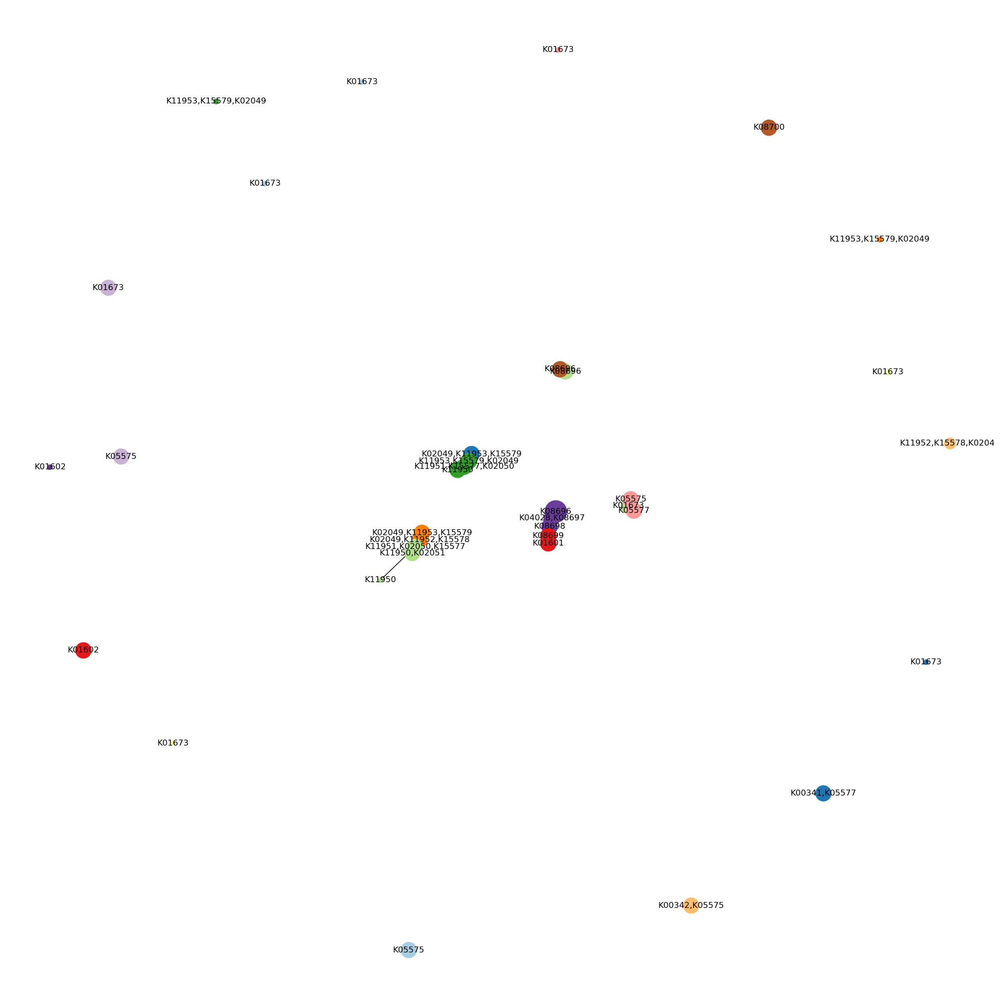

In [35]:
CCM_G = nx.Graph()
CCM_G.add_nodes_from(CCM_node_t) 
#CCM_G.add_nodes_from(CCM_node_tnei) 
CCM_weight_min = min(list(CCM_edge_t.values()) + list(CCM_edge_ex.values())) #list(CCM_edge_tnei.values())
CCM_weight_max = max(list(CCM_edge_t.values()) + list(CCM_edge_ex.values())) #+ list(CCM_edge_tnei.values())
CCM_node_min = min([id_pro_len[i] for i in (CCM_node_t + CCM_node_tC)]) #+ CCM_node_tnei
CCM_node_max = max([id_pro_len[i] for i in (CCM_node_t + CCM_node_tC)]) #+ CCM_node_tnei
#CCM_node_max = min(162, max([id_pro_len[i] for i in (CCM_node_t + CCM_node_tnei + CCM_node_tC)]))
for edge, w in CCM_edge_origin.items():
    CCM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl='o') 
for edge, w in CCM_edge_pre.items():
    CCM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'e') 
#for edge, w in CCM_edge_ex.items():
    #CCM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'C') 
#for edge, w in CCM_edge_tnei.items():
#    CCM_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'n') 
    
nx.set_node_attributes(CCM_G, id_CCM_dict_G, 'fun_name')
nx.set_node_attributes(CCM_G, id_C, 'C')
nx.set_node_attributes(CCM_G, id_pro_len, 'pro_len')
#nx.set_node_attributes(CCM_G, id_type, 'C_type')
node_labels = nx.get_node_attributes(CCM_G, 'fun_name')
print('number of nodes: ', CCM_G.number_of_nodes())
print('number of edges: ', CCM_G.number_of_edges())

eorigin=[(u,v) for (u,v,d) in CCM_G.edges(data=True) if d['cl'] == 'o']
eex=[(u,v) for (u,v,d) in CCM_G.edges(data=True) if d['cl'] == 'e']
eC=[(u,v) for (u,v,d) in CCM_G.edges(data=True) if d['cl'] == 'C']
enei=[(u,v) for (u,v,d) in CCM_G.edges(data=True) if d['cl'] == 'n']

CCM_G_connected_node = list()
for c in nx.connected_components(CCM_G):
    nodeSet = CCM_G.subgraph(c).nodes()
    CCM_G_connected_node.append(nodeSet)
print('number of subgraCCM: ', len(CCM_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(CCM_C_t)) 
node_color = [color_palette[CCM_C_t.index(node[1]['C'])] for node in CCM_G.nodes()(data=True)]
node_size = [50 + 950*(node[1]['pro_len'] - CCM_node_min)/(CCM_node_max - CCM_node_min)  for node in CCM_G.nodes()(data=True)]
pos = nx.spring_layout(CCM_G, k=0.2) #,iterations=50
#pos = nx.kamada_kawai_layout(CCM_G)
width_normal = [1 + 5*(float(abs(d['weight'])) - CCM_weight_min)/(CCM_weight_max -CCM_weight_min) for (u,v,d) in CCM_G.edges()(data=True)]
nx.draw(CCM_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        edgelist=eorigin,
        node_color=node_color,
        width=width_normal
       )
#nx.draw_networkx_edge_labels(CCM_pred_G, pos, label_pos=0.5,  rotate=False, font_size=8)
#nx.draw_networkx_edges(CCM_G,pos,edgelist=eex,style = ':',
#                      width= width_normal, alpha=1
#                      )
#nx.draw_networkx_edges(CCM_G,pos,edgelist=eC,style = '--',
#                      width= width_normal, alpha=1
#                      )
#nx.draw_networkx_edges(CCM_G,pos,edgelist=enei,style = '--',
 #                     width= width_normal, alpha=0.8
 #                     )

number of nodes:  86
number of edges:  415
number of PPI C:  21
number of subgraCCM:  1


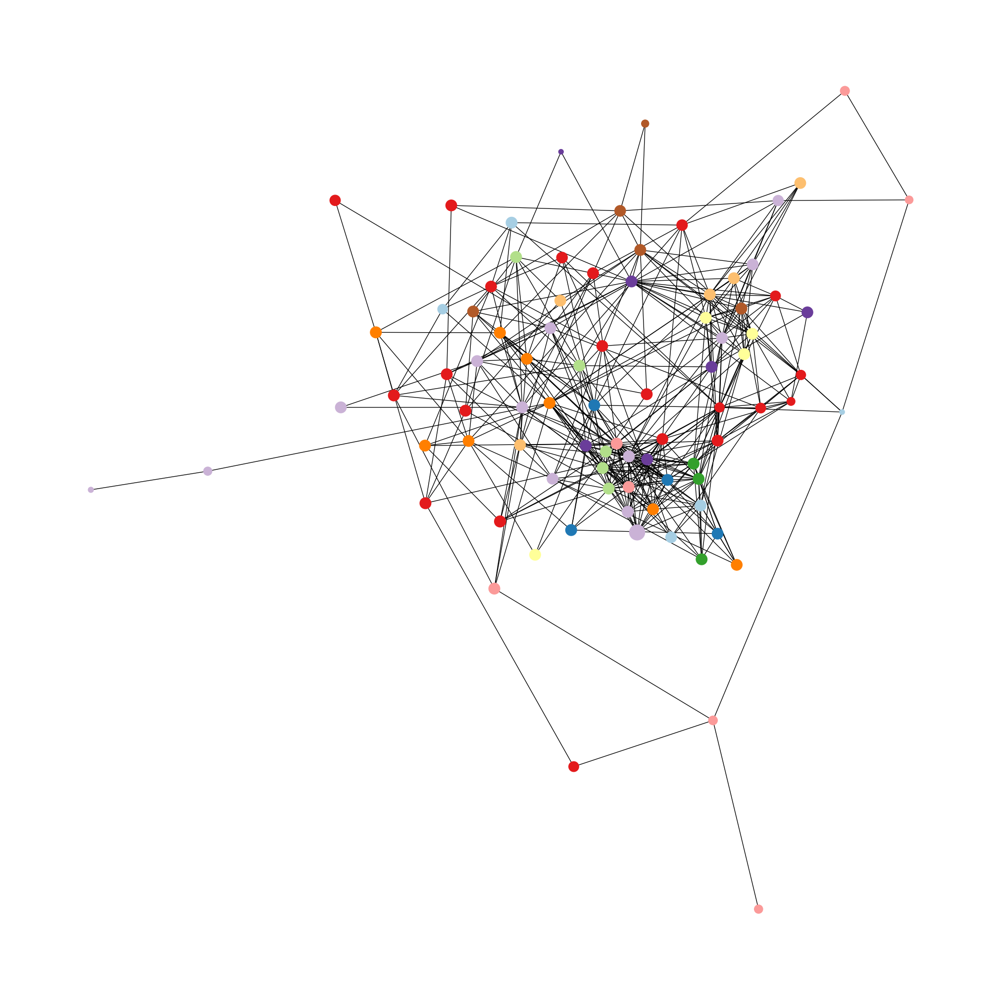

In [36]:
PPI_id_CCM_df = PPI_id_df[(PPI_id_df['C_1'].isin(CCM_C_t)) & (PPI_id_df['C_2'].isin(CCM_C_t))].reset_index(drop=True)
CCM_C_PPI_edge_t = PPI_id_CCM_df.set_index(['node1','node2']).to_dict()['weight']
CCM_C_PPI_node = list(set([str(i) for i in PPI_id_CCM_df['node1'].tolist()] + [str(i) for i in PPI_id_CCM_df['node2'].tolist()]))
CCM_C_PPI_t = list(set([id_C[i] for i in CCM_C_PPI_node]))
CCM_PPI_G = nx.Graph()
#CCM_PPI_G.add_nodes_from(CCM_C_PPI_node) 
CCM_PPI_node_min = min([id_pro_len[i] for i in (CCM_C_PPI_node)])
CCM_PPI_node_max = max([id_pro_len[i] for i in (CCM_C_PPI_node)]) 
for edge, w in CCM_C_PPI_edge_t.items():
    CCM_PPI_G.add_edge(str(edge[0]), str(edge[1]), weight = w)   
#nx.set_node_attributes(CCM_PPI_G, label_dict, 'fun_name')
nx.set_node_attributes(CCM_PPI_G, id_C, 'C')
nx.set_node_attributes(CCM_PPI_G, id_pro_len, 'pro_len')
node_labels = nx.get_node_attributes(CCM_PPI_G, 'fun_name')
print('number of nodes: ', CCM_PPI_G.number_of_nodes())
print('number of edges: ', CCM_PPI_G.number_of_edges())
print('number of PPI C: ', len(CCM_C_PPI_t))


CCM_PPI_G_connected_node = list()
for c in nx.connected_components(CCM_PPI_G):
    nodeSet = CCM_PPI_G.subgraph(c).nodes()
    CCM_PPI_G_connected_node.append(nodeSet)
print('number of subgraCCM: ', len(CCM_PPI_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(CCM_C_PPI_t)) 
node_color = [color_palette[CCM_C_PPI_t.index(node[1]['C'])] for node in CCM_PPI_G.nodes()(data=True)]
node_size = [50 + 450*(node[1]['pro_len'] - CCM_PPI_node_min)/(CCM_PPI_node_max - CCM_PPI_node_min)  for node in CCM_PPI_G.nodes()(data=True)]
pos = nx.spring_layout(CCM_PPI_G, k=2) #,iterations=50
#pos = nx.kamada_kawai_layout(CCM_PPI_G)
nx.draw(CCM_PPI_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        node_color=node_color,
       )

### 抗氧化应激能力 ROS

In [37]:
pro_ROS_dict = {}
with open('../function/ROS_mis.fasta') as f:
    for line in f:
        line = line.strip('\n')
        if line.startswith('>'):
            pro_ROS_dict[line[1:]] = pro_K[line[1:]]
id_ROS_dict = {}
for k, v in pro_ROS_dict.items():
    if pro_id[k] not in id_ROS_dict:
        id_ROS_dict[pro_id[k]] = []
    id_ROS_dict[pro_id[k]]  = list(set(v+id_ROS_dict[pro_id[k]]))
id_ROS_dict = {k:v if len(v) != 0 else ['ROS?'] for k, v in id_ROS_dict.items()}
ROS_id_origin = list(id_ROS_dict.keys())
C_ROS_dict = {}
C_ROS_value_dict = {}
C_ROS_count_dict = {}
for k, v in id_ROS_dict.items():
    if id_C[k] not in C_ROS_dict:
        C_ROS_dict[id_C[k]] = []
        C_ROS_value_dict[id_C[k]] = []
    C_ROS_dict[id_C[k]] = list(set(C_ROS_dict[id_C[k]] + v))
    C_ROS_value_dict[id_C[k]] = C_ROS_value_dict[id_C[k]] + v
C_ROS_count_dict = {k:dict(Counter(v)) for k, v in C_ROS_value_dict.items()}
print('ROS pro count: ', len(pro_ROS_dict))
print('ROS node count: ',len(id_ROS_dict))
print('ROS C count: ',len(C_ROS_dict))

ROS_pred_df = pd.read_csv('../function/ROS_pred.txt', sep='\t', header=None)
ROS_pred_df = ROS_pred_df[ROS_pred_df[1].isin(pro_ROS_dict)]
ROS_pred_df['id_1'] = ROS_pred_df[0].apply(lambda x:pro_id[x])
ROS_pred_df['id_2'] = ROS_pred_df[1].apply(lambda x:pro_id[x])
ROS_pred_df['func'] = ROS_pred_df[1].apply(lambda x: pro_ROS_dict[x])
ROS_pred_f_df = ROS_pred_df[~(ROS_pred_df['id_1'].isin(ROS_id_origin))].loc[:, ['id_1','id_2','func']].drop_duplicates(subset=['id_1','id_2'])
id_ROS_pred_dict = ROS_pred_f_df.set_index('id_1').to_dict()['func']
id_ROS_pred_dict = {k:v if len(v) != 0 else ['ROS?'] for k, v in id_ROS_pred_dict.items()}
#id_ROS_dict.update(id_ROS_pred_dict)

ROS_node_origin = ROS_id_origin
ROS_edge_origin = id_edge_df[(id_edge_df[0].isin(ROS_node_origin))&(id_edge_df[1].isin(ROS_node_origin))].set_index([0,1]).to_dict()[2]
ROS_node_ex = list(id_ROS_pred_dict.keys())
ROS_node_t = list(id_ROS_dict.keys()) + list(id_ROS_pred_dict.keys())
ROS_edge_t_df = id_edge_df[(id_edge_df[0].isin(ROS_node_t))&(id_edge_df[1].isin(ROS_node_t))]
ROS_edge_t = ROS_edge_t_df.set_index([0,1]).to_dict()[2]
ROS_edge_pre = ROS_edge_t_df[(ROS_edge_t_df[0].isin(ROS_node_ex))|(ROS_edge_t_df[1].isin(ROS_node_ex))].set_index([0,1]).to_dict()[2]

ROS_C = list(C_ROS_dict.keys())
ROS_node_oC= [j for i in ROS_C for j in C_id[i] if j not in ROS_node_origin]
ROS_node_tC = [j for i in ROS_C for j in C_id[i] if j not in ROS_node_t]
ROS_edge_df = id_edge_df[(id_edge_df[0].isin(ROS_node_origin+ROS_node_oC))&(id_edge_df[1].isin(ROS_node_origin+ROS_node_oC))]
ROS_edge = ROS_edge_df[(ROS_edge_df[0].isin(ROS_node_oC))|(ROS_edge_df[1].isin(ROS_node_oC))].set_index([0,1]).to_dict()[2]
ROS_edge_ex_df = id_edge_df[(id_edge_df[0].isin(ROS_node_t+ROS_node_tC))&(id_edge_df[1].isin(ROS_node_t+ROS_node_tC))]
ROS_edge_ex = ROS_edge_ex_df[(ROS_edge_ex_df[0].isin(ROS_node_tC))|(ROS_edge_ex_df[1].isin(ROS_node_tC))].set_index([0,1]).to_dict()[2]
ROS_C_t = list(set([id_C[i] for i in ROS_node_t]))
print('ROS ex C count: ',len(ROS_C_t))
print('origin node: ', len(ROS_node_origin))
print('total node: ', len(ROS_node_t))
print('origin edge: ', len(ROS_edge_origin))
print('extend edge: ', len(ROS_edge_pre))
print('total edge: ', len(ROS_edge_t_df))
print('origin C nei node: ', len(ROS_node_oC))
print('origin C nei edge: ', len(ROS_edge_df))
print('total C nei node: ', len(ROS_node_tC))
print('total C nei edge: ', len(ROS_edge_ex_df))

ROS_node_onei = list(set([nei for node in ROS_node_origin for nei in find_nei(proid_G, node)[0]]) - set(ROS_node_origin))
ROS_node_tnei = list(set([nei for node in ROS_node_t for nei in find_nei(proid_G, node)[0]]) - set(ROS_node_t))
ROS_edge_onei_df = id_edge_df[(id_edge_df[0].isin(ROS_node_origin+ROS_node_onei))&(id_edge_df[1].isin(ROS_node_origin+ROS_node_onei))]
#ROS_edge_onei = ROS_edge_onei_df[ROS_edge_onei_df[0].isin(ROS_node_onei) | ROS_edge_onei_df[1].isin(ROS_node_onei)].set_index([0,1]).to_dict()[2]
ROS_edge_tnei_df = id_edge_df[(id_edge_df[0].isin(ROS_node_t+ROS_node_tnei))&(id_edge_df[1].isin(ROS_node_t+ROS_node_tnei))]
#ROS_edge_tnei = ROS_edge_tnei_df[ROS_edge_tnei_df[0].isin(ROS_node_tnei) | ROS_edge_tnei_df[1].isin(ROS_node_tnei)].set_index([0,1]).to_dict()[2]
ROS_GC_t =list(set([id_C[i] for i in ROS_node_t+ROS_node_tnei]))
print('origin  nei node: ', len(ROS_node_onei))
print('origin  nei edge: ', len(ROS_edge_onei_df))
print('total  nei node: ', len(ROS_node_tnei))
print('total  nei edge: ', len(ROS_edge_tnei_df))

ROS_PPI_o_df = PPI_id_df[(PPI_id_df['node1'].isin(ROS_node_origin))&(PPI_id_df['node2'].isin(ROS_node_origin))]
ROS_PPI_t_df = PPI_id_df[(PPI_id_df['node1'].isin(ROS_node_t))&(PPI_id_df['node2'].isin(ROS_node_t))]
ROS_node_o_PPI = list(set(ROS_PPI_o_df['node1'].tolist() + ROS_PPI_o_df['node2'].tolist()))
ROS_node_t_PPI = list(set(ROS_PPI_t_df['node1'].tolist() + ROS_PPI_t_df['node2'].tolist()))
print('PPI orign node: ', len(ROS_node_o_PPI))
print('PPI total node: ', len(ROS_node_t_PPI))
print('PPI orign edge: ', len(ROS_PPI_o_df))
print('PPI total edge: ', len(ROS_PPI_t_df)) 
id_ROS_t_dict = {k:id_ROS_dict[k] if k in id_ROS_dict else id_ROS_pred_dict[k] for k in ROS_node_t}
id_ROS_dict_G = {k:','.join(v) + ' **' if int(k) in ROS_node_t_PPI  else ','.join(v) for k, v in id_ROS_t_dict.items()}

ROS pro count:  1422
ROS node count:  18
ROS C count:  18
ROS ex C count:  21
origin node:  18
total node:  21
origin edge:  0
extend edge:  0
total edge:  0
origin C nei node:  279
origin C nei edge:  119
total C nei node:  279
total C nei edge:  120
origin  nei node:  169
origin  nei edge:  385
total  nei node:  171
total  nei edge:  390
PPI orign node:  6
PPI total node:  6
PPI orign edge:  5
PPI total edge:  5


number of nodes:  21
number of edges:  0
number of subgraROS:  21


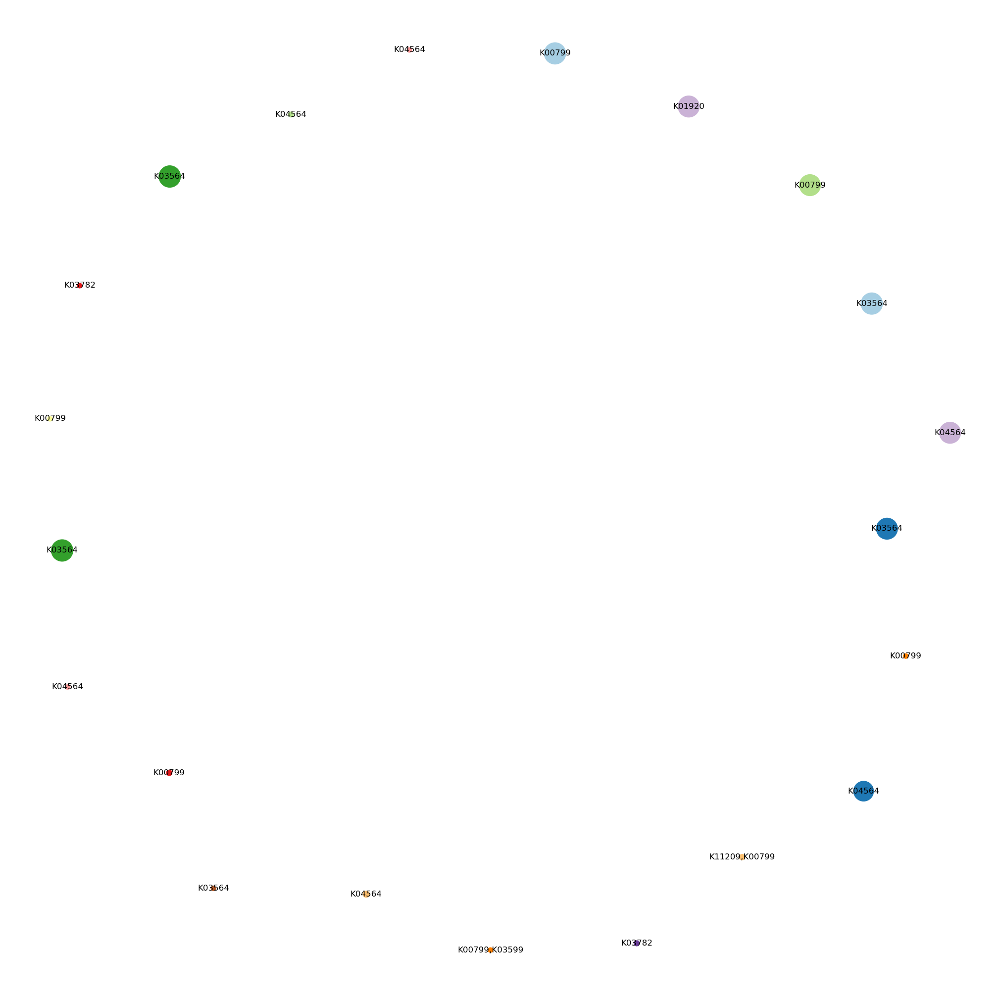

In [38]:
ROS_G = nx.Graph()
ROS_G.add_nodes_from(ROS_node_t) 
#ROS_G.add_nodes_from(ROS_node_tnei) 
ROS_weight_min = min(list(ROS_edge_t.values()) + list(ROS_edge_ex.values())) #list(ROS_edge_tnei.values())
ROS_weight_max = max(list(ROS_edge_t.values()) + list(ROS_edge_ex.values())) #+ list(ROS_edge_tnei.values())
ROS_node_min = min([id_pro_len[i] for i in (ROS_node_t + ROS_node_tC)]) #+ ROS_node_tnei
ROS_node_max = max([id_pro_len[i] for i in (ROS_node_t + ROS_node_tC)]) #+ ROS_node_tnei
#ROS_node_max = min(162, max([id_pro_len[i] for i in (ROS_node_t + ROS_node_tnei + ROS_node_tC)]))
for edge, w in ROS_edge_origin.items():
    ROS_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl='o') 
for edge, w in ROS_edge_pre.items():
    ROS_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'e') 
#for edge, w in ROS_edge_ex.items():
    #ROS_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'C') 
#for edge, w in ROS_edge_tnei.items():
#    ROS_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'n') 
    
nx.set_node_attributes(ROS_G, id_ROS_dict_G, 'fun_name')
nx.set_node_attributes(ROS_G, id_C, 'C')
nx.set_node_attributes(ROS_G, id_pro_len, 'pro_len')
#nx.set_node_attributes(ROS_G, id_type, 'C_type')
node_labels = nx.get_node_attributes(ROS_G, 'fun_name')
print('number of nodes: ', ROS_G.number_of_nodes())
print('number of edges: ', ROS_G.number_of_edges())

eorigin=[(u,v) for (u,v,d) in ROS_G.edges(data=True) if d['cl'] == 'o']
eex=[(u,v) for (u,v,d) in ROS_G.edges(data=True) if d['cl'] == 'e']
eC=[(u,v) for (u,v,d) in ROS_G.edges(data=True) if d['cl'] == 'C']
enei=[(u,v) for (u,v,d) in ROS_G.edges(data=True) if d['cl'] == 'n']

ROS_G_connected_node = list()
for c in nx.connected_components(ROS_G):
    nodeSet = ROS_G.subgraph(c).nodes()
    ROS_G_connected_node.append(nodeSet)
print('number of subgraROS: ', len(ROS_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(ROS_C_t)) 
node_color = [color_palette[ROS_C_t.index(node[1]['C'])] for node in ROS_G.nodes()(data=True)]
node_size = [50 + 950*(node[1]['pro_len'] - ROS_node_min)/(ROS_node_max - ROS_node_min)  for node in ROS_G.nodes()(data=True)]
pos = nx.spring_layout(ROS_G, k=0.2) #,iterations=50
#pos = nx.kamada_kawai_layout(ROS_G)
width_normal = [1 + 5*(float(abs(d['weight'])) - ROS_weight_min)/(ROS_weight_max -ROS_weight_min) for (u,v,d) in ROS_G.edges()(data=True)]
nx.draw(ROS_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        edgelist=eorigin,
        node_color=node_color,
        width=width_normal
       )
#nx.draw_networkx_edge_labels(ROS_pred_G, pos, label_pos=0.5,  rotate=False, font_size=8)
#nx.draw_networkx_edges(ROS_G,pos,edgelist=eex,style = ':',
 #                     width= width_normal, alpha=1
 #                     )
#nx.draw_networkx_edges(ROS_G,pos,edgelist=eC,style = '--',
#                      width= width_normal, alpha=1
#                      )
#nx.draw_networkx_edges(ROS_G,pos,edgelist=enei,style = '--',
 #                     width= width_normal, alpha=0.8
 #                     )

number of nodes:  74
number of edges:  230
number of PPI C:  10
number of subgraROS:  2


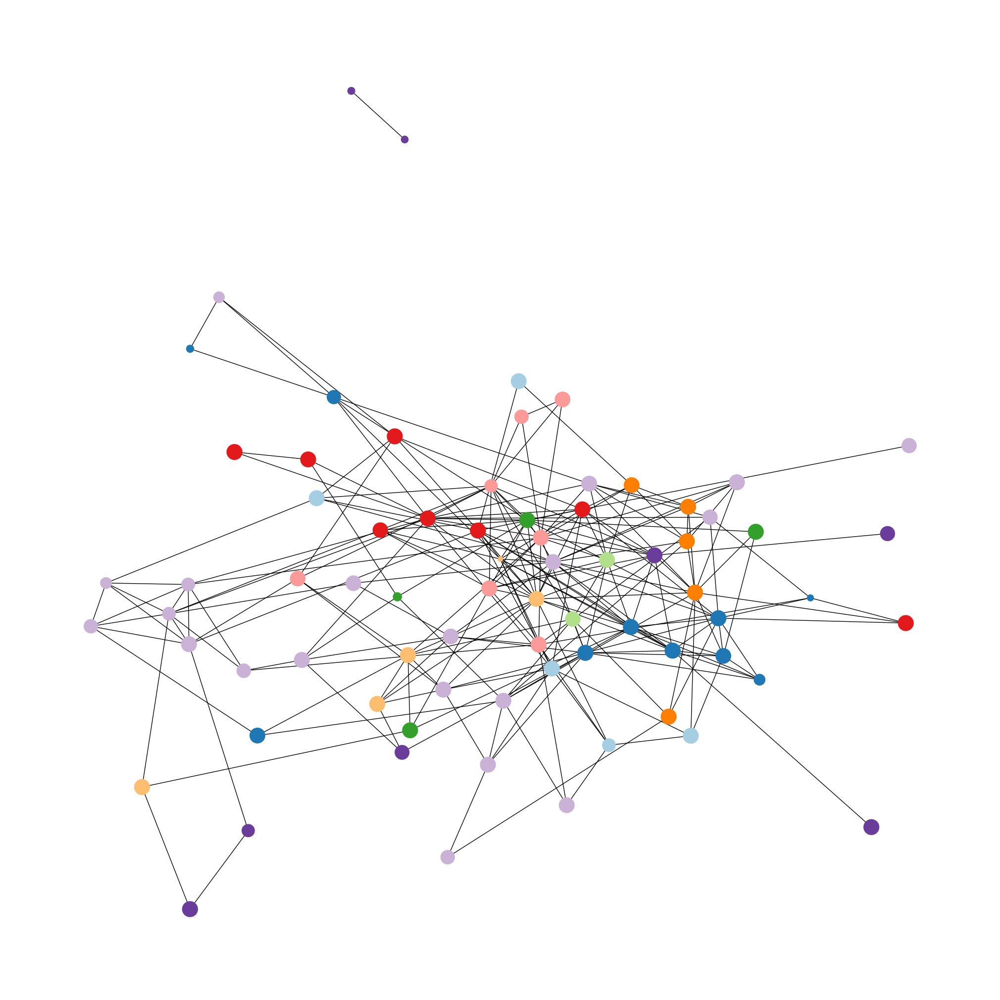

In [39]:
PPI_id_ROS_df = PPI_id_df[(PPI_id_df['C_1'].isin(ROS_C_t)) & (PPI_id_df['C_2'].isin(ROS_C_t))].reset_index(drop=True)
ROS_C_PPI_edge_t = PPI_id_ROS_df.set_index(['node1','node2']).to_dict()['weight']
ROS_C_PPI_node = list(set([str(i) for i in PPI_id_ROS_df['node1'].tolist()] + [str(i) for i in PPI_id_ROS_df['node2'].tolist()]))
ROS_C_PPI_t = list(set([id_C[i] for i in ROS_C_PPI_node]))
ROS_PPI_G = nx.Graph()
#ROS_PPI_G.add_nodes_from(ROS_C_PPI_node) 
ROS_PPI_node_min = min([id_pro_len[i] for i in (ROS_C_PPI_node)])
ROS_PPI_node_max = max([id_pro_len[i] for i in (ROS_C_PPI_node)]) 
for edge, w in ROS_C_PPI_edge_t.items():
    ROS_PPI_G.add_edge(str(edge[0]), str(edge[1]), weight = w)   
#nx.set_node_attributes(ROS_PPI_G, label_dict, 'fun_name')
nx.set_node_attributes(ROS_PPI_G, id_C, 'C')
nx.set_node_attributes(ROS_PPI_G, id_pro_len, 'pro_len')
node_labels = nx.get_node_attributes(ROS_PPI_G, 'fun_name')
print('number of nodes: ', ROS_PPI_G.number_of_nodes())
print('number of edges: ', ROS_PPI_G.number_of_edges())
print('number of PPI C: ', len(ROS_C_PPI_t))


ROS_PPI_G_connected_node = list()
for c in nx.connected_components(ROS_PPI_G):
    nodeSet = ROS_PPI_G.subgraph(c).nodes()
    ROS_PPI_G_connected_node.append(nodeSet)
print('number of subgraROS: ', len(ROS_PPI_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(ROS_C_PPI_t)) 
node_color = [color_palette[ROS_C_PPI_t.index(node[1]['C'])] for node in ROS_PPI_G.nodes()(data=True)]
node_size = [50 + 450*(node[1]['pro_len'] - ROS_PPI_node_min)/(ROS_PPI_node_max - ROS_PPI_node_min)  for node in ROS_PPI_G.nodes()(data=True)]
pos = nx.spring_layout(ROS_PPI_G, k=2) #,iterations=50
#pos = nx.kamada_kawai_layout(ROS_PPI_G)
nx.draw(ROS_PPI_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        node_color=node_color,
       )

### 磷代谢和转运 P

In [40]:
pro_P_dict = {}
with open('../function/P_mis.fasta') as f:
    for line in f:
        line = line.strip('\n')
        if line.startswith('>'):
            pro_P_dict[line[1:]] = pro_K[line[1:]]
id_P_dict = {}
for k, v in pro_P_dict.items():
    if pro_id[k] not in id_P_dict:
        id_P_dict[pro_id[k]] = []
    id_P_dict[pro_id[k]]  = list(set(v+id_P_dict[pro_id[k]]))
id_P_dict = {k:v if len(v) != 0 else ['P?'] for k, v in id_P_dict.items()}
P_id_origin = list(id_P_dict.keys())
C_P_dict = {}
C_P_value_dict = {}
C_P_count_dict = {}
for k, v in id_P_dict.items():
    if id_C[k] not in C_P_dict:
        C_P_dict[id_C[k]] = []
        C_P_value_dict[id_C[k]] = []
    C_P_dict[id_C[k]] = list(set(C_P_dict[id_C[k]] + v))
    C_P_value_dict[id_C[k]] = C_P_value_dict[id_C[k]] + v
C_P_count_dict = {k:dict(Counter(v)) for k, v in C_P_value_dict.items()}
print('P pro count: ', len(pro_P_dict))
print('P node count: ',len(id_P_dict))
print('P C count: ',len(C_P_dict))

P_pred_df = pd.read_csv('../function/P_pred.txt', sep='\t', header=None)
P_pred_df = P_pred_df[P_pred_df[1].isin(pro_P_dict)]
P_pred_df['id_1'] = P_pred_df[0].apply(lambda x:pro_id[x])
P_pred_df['id_2'] = P_pred_df[1].apply(lambda x:pro_id[x])
P_pred_df['func'] = P_pred_df[1].apply(lambda x: pro_P_dict[x])
P_pred_f_df = P_pred_df[~(P_pred_df['id_1'].isin(P_id_origin))].loc[:, ['id_1','id_2','func']].drop_duplicates(subset=['id_1','id_2'])
id_P_pred_dict = P_pred_f_df.set_index('id_1').to_dict()['func']
id_P_pred_dict = {k:v if len(v) != 0 else ['P?'] for k, v in id_P_pred_dict.items()}
#id_P_dict.update(id_P_pred_dict)

P_node_origin = P_id_origin
P_edge_origin = id_edge_df[(id_edge_df[0].isin(P_node_origin))&(id_edge_df[1].isin(P_node_origin))].set_index([0,1]).to_dict()[2]
P_node_ex = list(id_P_pred_dict.keys())
P_node_t = list(id_P_dict.keys()) + list(id_P_pred_dict.keys())
P_edge_t_df = id_edge_df[(id_edge_df[0].isin(P_node_t))&(id_edge_df[1].isin(P_node_t))]
P_edge_t = P_edge_t_df.set_index([0,1]).to_dict()[2]
P_edge_pre = P_edge_t_df[(P_edge_t_df[0].isin(P_node_ex))|(P_edge_t_df[1].isin(P_node_ex))].set_index([0,1]).to_dict()[2]

P_C = list(C_P_dict.keys())
P_node_oC= [j for i in P_C for j in C_id[i] if j not in P_node_origin]
P_node_tC = [j for i in P_C for j in C_id[i] if j not in P_node_t]
P_edge_df = id_edge_df[(id_edge_df[0].isin(P_node_origin+P_node_oC))&(id_edge_df[1].isin(P_node_origin+P_node_oC))]
P_edge = P_edge_df[(P_edge_df[0].isin(P_node_oC))|(P_edge_df[1].isin(P_node_oC))].set_index([0,1]).to_dict()[2]
P_edge_ex_df = id_edge_df[(id_edge_df[0].isin(P_node_t+P_node_tC))&(id_edge_df[1].isin(P_node_t+P_node_tC))]
P_edge_ex = P_edge_ex_df[(P_edge_ex_df[0].isin(P_node_tC))|(P_edge_ex_df[1].isin(P_node_tC))].set_index([0,1]).to_dict()[2]
P_C_t = list(set([id_C[i] for i in P_node_t]))
print('P ex C count: ',len(P_C_t))
print('origin node: ', len(P_node_origin))
print('total node: ', len(P_node_t))
print('origin edge: ', len(P_edge_origin))
print('extend edge: ', len(P_edge_pre))
print('total edge: ', len(P_edge_t_df))
print('origin C nei node: ', len(P_node_oC))
print('origin C nei edge: ', len(P_edge_df))
print('total C nei node: ', len(P_node_tC))
print('total C nei edge: ', len(P_edge_ex_df))

P_node_onei = list(set([nei for node in P_node_origin for nei in find_nei(proid_G, node)[0]]) - set(P_node_origin))
P_node_tnei = list(set([nei for node in P_node_t for nei in find_nei(proid_G, node)[0]]) - set(P_node_t))
P_edge_onei_df = id_edge_df[(id_edge_df[0].isin(P_node_origin+P_node_onei))&(id_edge_df[1].isin(P_node_origin+P_node_onei))]
#P_edge_onei = P_edge_onei_df[P_edge_onei_df[0].isin(P_node_onei) | P_edge_onei_df[1].isin(P_node_onei)].set_index([0,1]).to_dict()[2]
P_edge_tnei_df = id_edge_df[(id_edge_df[0].isin(P_node_t+P_node_tnei))&(id_edge_df[1].isin(P_node_t+P_node_tnei))]
#P_edge_tnei = P_edge_tnei_df[P_edge_tnei_df[0].isin(P_node_tnei) | P_edge_tnei_df[1].isin(P_node_tnei)].set_index([0,1]).to_dict()[2]
P_GC_t =list(set([id_C[i] for i in P_node_t+P_node_tnei]))
print('origin  nei node: ', len(P_node_onei))
print('origin  nei edge: ', len(P_edge_onei_df))
print('total  nei node: ', len(P_node_tnei))
print('total  nei edge: ', len(P_edge_tnei_df))

P_PPI_o_df = PPI_id_df[(PPI_id_df['node1'].isin(P_node_origin))&(PPI_id_df['node2'].isin(P_node_origin))]
P_PPI_t_df = PPI_id_df[(PPI_id_df['node1'].isin(P_node_t))&(PPI_id_df['node2'].isin(P_node_t))]
P_node_o_PPI = list(set(P_PPI_o_df['node1'].tolist() + P_PPI_o_df['node2'].tolist()))
P_node_t_PPI = list(set(P_PPI_t_df['node1'].tolist() + P_PPI_t_df['node2'].tolist()))
print('PPI orign node: ', len(P_node_o_PPI))
print('PPI total node: ', len(P_node_t_PPI))
print('PPI orign edge: ', len(P_PPI_o_df))
print('PPI total edge: ', len(P_PPI_t_df)) 
id_P_t_dict = {k:id_P_dict[k] if k in id_P_dict else id_P_pred_dict[k] for k in P_node_t}
id_P_dict_G = {k:','.join(v) + ' **' if int(k) in P_node_t_PPI  else ','.join(v) for k, v in id_P_t_dict.items()}

P pro count:  2538
P node count:  34
P C count:  23
P ex C count:  29
origin node:  34
total node:  40
origin edge:  25
extend edge:  4
total edge:  29
origin C nei node:  660
origin C nei edge:  272
total C nei node:  660
total C nei edge:  277
origin  nei node:  168
origin  nei edge:  393
total  nei node:  168
total  nei edge:  416
PPI orign node:  18
PPI total node:  18
PPI orign edge:  148
PPI total edge:  148


number of nodes:  40
number of edges:  29
number of subgraP:  16


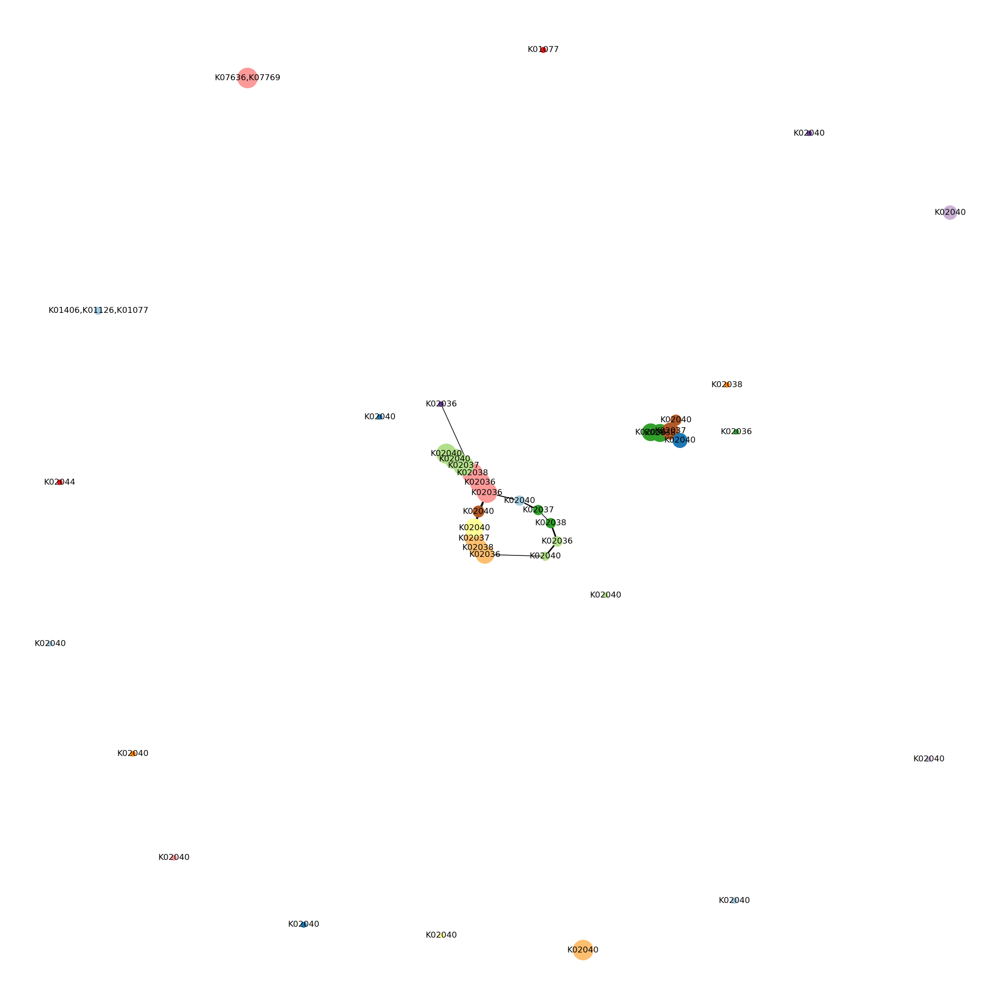

In [41]:
P_G = nx.Graph()
P_G.add_nodes_from(P_node_t) 
#P_G.add_nodes_from(P_node_tnei) 
P_weight_min = min(list(P_edge_t.values()) + list(P_edge_ex.values())) #list(P_edge_tnei.values())
P_weight_max = max(list(P_edge_t.values()) + list(P_edge_ex.values())) #+ list(P_edge_tnei.values())
P_node_min = min([id_pro_len[i] for i in (P_node_t + P_node_tC)]) #+ P_node_tnei
P_node_max = max([id_pro_len[i] for i in (P_node_t + P_node_tC)]) #+ P_node_tnei
#P_node_max = min(162, max([id_pro_len[i] for i in (P_node_t + P_node_tnei + P_node_tC)]))
for edge, w in P_edge_origin.items():
    P_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl='o') 
for edge, w in P_edge_pre.items():
    P_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'e') 
#for edge, w in P_edge_ex.items():
    #P_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'C') 
#for edge, w in P_edge_tnei.items():
#    P_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'n') 
    
nx.set_node_attributes(P_G, id_P_dict_G, 'fun_name')
nx.set_node_attributes(P_G, id_C, 'C')
nx.set_node_attributes(P_G, id_pro_len, 'pro_len')
#nx.set_node_attributes(P_G, id_type, 'C_type')
node_labels = nx.get_node_attributes(P_G, 'fun_name')
print('number of nodes: ', P_G.number_of_nodes())
print('number of edges: ', P_G.number_of_edges())

eorigin=[(u,v) for (u,v,d) in P_G.edges(data=True) if d['cl'] == 'o']
eex=[(u,v) for (u,v,d) in P_G.edges(data=True) if d['cl'] == 'e']
eC=[(u,v) for (u,v,d) in P_G.edges(data=True) if d['cl'] == 'C']
enei=[(u,v) for (u,v,d) in P_G.edges(data=True) if d['cl'] == 'n']

P_G_connected_node = list()
for c in nx.connected_components(P_G):
    nodeSet = P_G.subgraph(c).nodes()
    P_G_connected_node.append(nodeSet)
print('number of subgraP: ', len(P_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(P_C_t)) 
node_color = [color_palette[P_C_t.index(node[1]['C'])] for node in P_G.nodes()(data=True)]
node_size = [50 + 950*(node[1]['pro_len'] - P_node_min)/(P_node_max - P_node_min)  for node in P_G.nodes()(data=True)]
pos = nx.spring_layout(P_G, k=0.2) #,iterations=50
#pos = nx.kamada_kawai_layout(P_G)
width_normal = [1 + 5*(float(abs(d['weight'])) - P_weight_min)/(P_weight_max -P_weight_min) for (u,v,d) in P_G.edges()(data=True)]
nx.draw(P_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        edgelist=eorigin,
        node_color=node_color,
        width=width_normal
       )
#nx.draw_networkx_edge_labels(P_pred_G, pos, label_pos=0.5,  rotate=False, font_size=8)
#nx.draw_networkx_edges(P_G,pos,edgelist=eex,style = ':',
 #                     width= width_normal, alpha=1
#                      )
#nx.draw_networkx_edges(P_G,pos,edgelist=eC,style = '--',
 #                     width= width_normal, alpha=1
#                      )
#nx.draw_networkx_edges(P_G,pos,edgelist=enei,style = '--',
#                      width= width_normal, alpha=0.8
#                      )

number of nodes:  129
number of edges:  647
number of PPI C:  20
number of subgraP:  3


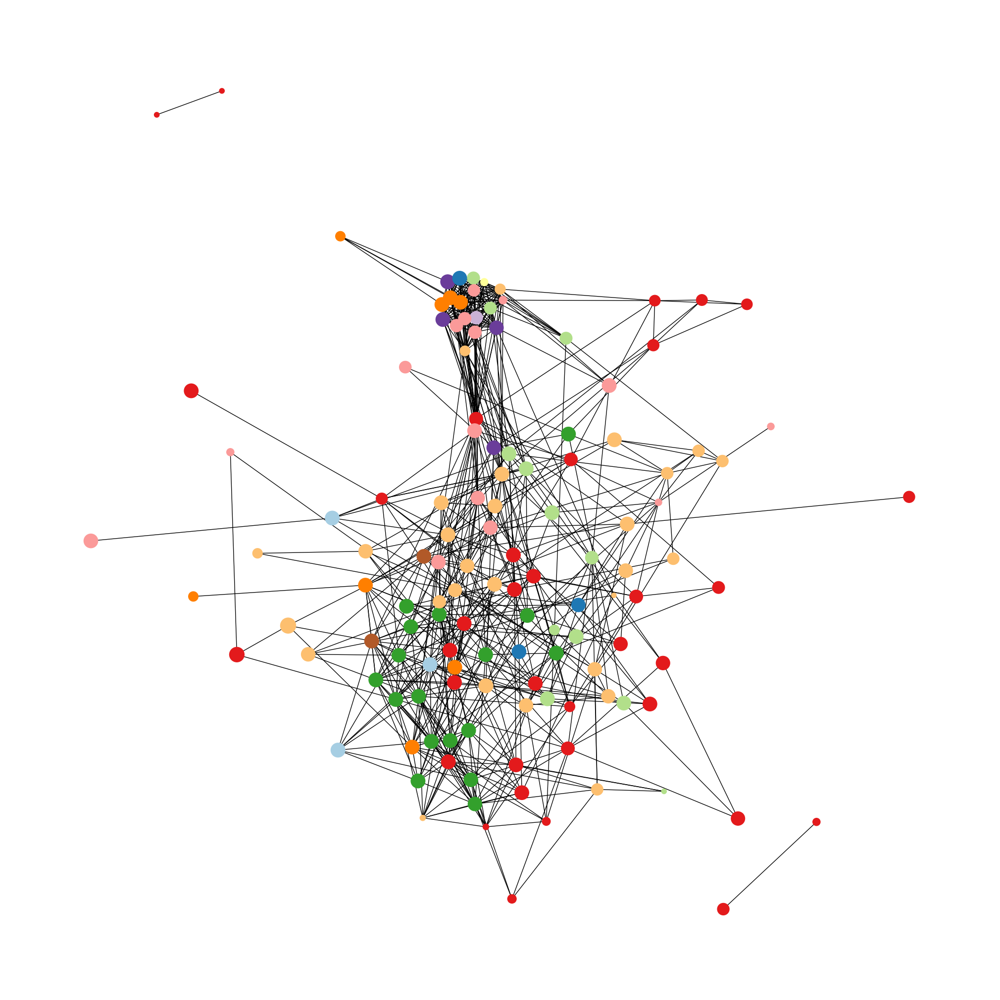

In [42]:
PPI_id_P_df = PPI_id_df[(PPI_id_df['C_1'].isin(P_C_t)) & (PPI_id_df['C_2'].isin(P_C_t))].reset_index(drop=True)
P_C_PPI_edge_t = PPI_id_P_df.set_index(['node1','node2']).to_dict()['weight']
P_C_PPI_node = list(set([str(i) for i in PPI_id_P_df['node1'].tolist()] + [str(i) for i in PPI_id_P_df['node2'].tolist()]))
P_C_PPI_t = list(set([id_C[i] for i in P_C_PPI_node]))
P_PPI_G = nx.Graph()
#P_PPI_G.add_nodes_from(P_C_PPI_node) 
P_PPI_node_min = min([id_pro_len[i] for i in (P_C_PPI_node)])
P_PPI_node_max = max([id_pro_len[i] for i in (P_C_PPI_node)]) 
for edge, w in P_C_PPI_edge_t.items():
    P_PPI_G.add_edge(str(edge[0]), str(edge[1]), weight = w)   
#nx.set_node_attributes(P_PPI_G, label_dict, 'fun_name')
nx.set_node_attributes(P_PPI_G, id_C, 'C')
nx.set_node_attributes(P_PPI_G, id_pro_len, 'pro_len')
node_labels = nx.get_node_attributes(P_PPI_G, 'fun_name')
print('number of nodes: ', P_PPI_G.number_of_nodes())
print('number of edges: ', P_PPI_G.number_of_edges())
print('number of PPI C: ', len(P_C_PPI_t))


P_PPI_G_connected_node = list()
for c in nx.connected_components(P_PPI_G):
    nodeSet = P_PPI_G.subgraph(c).nodes()
    P_PPI_G_connected_node.append(nodeSet)
print('number of subgraP: ', len(P_PPI_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(P_C_PPI_t)) 
node_color = [color_palette[P_C_PPI_t.index(node[1]['C'])] for node in P_PPI_G.nodes()(data=True)]
node_size = [50 + 450*(node[1]['pro_len'] - P_PPI_node_min)/(P_PPI_node_max - P_PPI_node_min)  for node in P_PPI_G.nodes()(data=True)]
pos = nx.spring_layout(P_PPI_G, k=2) #,iterations=50
#pos = nx.kamada_kawai_layout(P_PPI_G)
nx.draw(P_PPI_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        node_color=node_color,
       )

### 氨基酸转运 AAT

In [11]:
pro_AAT_dict = {}
with open('../function/AAT_mis.fasta') as f:
    for line in f:
        line = line.strip('\n')
        if line.startswith('>'):
            pro_AAT_dict[line[1:]] = pro_K[line[1:]]
id_AAT_dict = {}
for k, v in pro_AAT_dict.items():
    if pro_id[k] not in id_AAT_dict:
        id_AAT_dict[pro_id[k]] = []
    id_AAT_dict[pro_id[k]]  = list(set(v+id_AAT_dict[pro_id[k]]))
id_AAT_dict = {k:v if len(v) != 0 else ['AAT?'] for k, v in id_AAT_dict.items()}
AAT_id_origin = list(id_AAT_dict.keys())
C_AAT_dict = {}
C_AAT_value_dict = {}
C_AAT_count_dict = {}
for k, v in id_AAT_dict.items():
    if id_C[k] not in C_AAT_dict:
        C_AAT_dict[id_C[k]] = []
        C_AAT_value_dict[id_C[k]] = []
    C_AAT_dict[id_C[k]] = list(set(C_AAT_dict[id_C[k]] + v))
    C_AAT_value_dict[id_C[k]] = C_AAT_value_dict[id_C[k]] + v
C_AAT_count_dict = {k:dict(Counter(v)) for k, v in C_AAT_value_dict.items()}
print('AAT pro count: ', len(pro_AAT_dict))
print('AAT node count: ',len(id_AAT_dict))
print('AAT C count: ',len(C_AAT_dict))

AAT_pred_df = pd.read_csv('../function/AAT_pred.txt', sep='\t', header=None)
AAT_pred_df = AAT_pred_df[AAT_pred_df[1].isin(pro_AAT_dict)]
AAT_pred_df['id_1'] = AAT_pred_df[0].apply(lambda x:pro_id[x])
AAT_pred_df['id_2'] = AAT_pred_df[1].apply(lambda x:pro_id[x])
AAT_pred_df['func'] = AAT_pred_df[1].apply(lambda x: pro_AAT_dict[x])
AAT_pred_f_df = AAT_pred_df[~(AAT_pred_df['id_1'].isin(AAT_id_origin))].loc[:, ['id_1','id_2','func']].drop_duplicates(subset=['id_1','id_2'])
id_AAT_pred_dict = AAT_pred_f_df.set_index('id_1').to_dict()['func']
id_AAT_pred_dict = {k:v if len(v) != 0 else ['AAT?'] for k, v in id_AAT_pred_dict.items()}
#id_AAT_dict.update(id_AAT_pred_dict)

AAT_node_origin = AAT_id_origin
AAT_edge_origin = id_edge_df[(id_edge_df[0].isin(AAT_node_origin))&(id_edge_df[1].isin(AAT_node_origin))].set_index([0,1]).to_dict()[2]
AAT_node_ex = list(id_AAT_pred_dict.keys())
AAT_node_t = list(id_AAT_dict.keys()) + list(id_AAT_pred_dict.keys())
AAT_edge_t_df = id_edge_df[(id_edge_df[0].isin(AAT_node_t))&(id_edge_df[1].isin(AAT_node_t))]
AAT_edge_t = AAT_edge_t_df.set_index([0,1]).to_dict()[2]
AAT_edge_pre = AAT_edge_t_df[(AAT_edge_t_df[0].isin(AAT_node_ex))|(AAT_edge_t_df[1].isin(AAT_node_ex))].set_index([0,1]).to_dict()[2]

AAT_C = list(C_AAT_dict.keys())
AAT_node_oC= [j for i in AAT_C for j in C_id[i] if j not in AAT_node_origin]
AAT_node_tC = [j for i in AAT_C for j in C_id[i] if j not in AAT_node_t]
AAT_edge_df = id_edge_df[(id_edge_df[0].isin(AAT_node_origin+AAT_node_oC))&(id_edge_df[1].isin(AAT_node_origin+AAT_node_oC))]
AAT_edge = AAT_edge_df[(AAT_edge_df[0].isin(AAT_node_oC))|(AAT_edge_df[1].isin(AAT_node_oC))].set_index([0,1]).to_dict()[2]
AAT_edge_ex_df = id_edge_df[(id_edge_df[0].isin(AAT_node_t+AAT_node_tC))&(id_edge_df[1].isin(AAT_node_t+AAT_node_tC))]
AAT_edge_ex = AAT_edge_ex_df[(AAT_edge_ex_df[0].isin(AAT_node_tC))|(AAT_edge_ex_df[1].isin(AAT_node_tC))].set_index([0,1]).to_dict()[2]
AAT_C_t = list(set([id_C[i] for i in AAT_node_t]))
print('AAT ex C count: ',len(AAT_C_t))
print('origin node: ', len(AAT_node_origin))
print('total node: ', len(AAT_node_t))
print('origin edge: ', len(AAT_edge_origin))
print('extend edge: ', len(AAT_edge_pre))
print('total edge: ', len(AAT_edge_t_df))
print('origin C nei node: ', len(AAT_node_oC))
print('origin C nei edge: ', len(AAT_edge_df))
print('total C nei node: ', len(AAT_node_tC))
print('total C nei edge: ', len(AAT_edge_ex_df))

AAT_node_onei = list(set([nei for node in AAT_node_origin for nei in find_nei(proid_G, node)[0]]) - set(AAT_node_origin))
AAT_node_tnei = list(set([nei for node in AAT_node_t for nei in find_nei(proid_G, node)[0]]) - set(AAT_node_t))
AAT_edge_onei_df = id_edge_df[(id_edge_df[0].isin(AAT_node_origin+AAT_node_onei))&(id_edge_df[1].isin(AAT_node_origin+AAT_node_onei))]
#AAT_edge_onei = AAT_edge_onei_df[AAT_edge_onei_df[0].isin(AAT_node_onei) | AAT_edge_onei_df[1].isin(AAT_node_onei)].set_index([0,1]).to_dict()[2]
AAT_edge_tnei_df = id_edge_df[(id_edge_df[0].isin(AAT_node_t+AAT_node_tnei))&(id_edge_df[1].isin(AAT_node_t+AAT_node_tnei))]
#AAT_edge_tnei = AAT_edge_tnei_df[AAT_edge_tnei_df[0].isin(AAT_node_tnei) | AAT_edge_tnei_df[1].isin(AAT_node_tnei)].set_index([0,1]).to_dict()[2]
AAT_GC_t =list(set([id_C[i] for i in AAT_node_t+AAT_node_tnei]))
print('origin  nei node: ', len(AAT_node_onei))
print('origin  nei edge: ', len(AAT_edge_onei_df))
print('total  nei node: ', len(AAT_node_tnei))
print('total  nei edge: ', len(AAT_edge_tnei_df))

AAT_PPI_o_df = PPI_id_df[(PPI_id_df['node1'].isin(AAT_node_origin))&(PPI_id_df['node2'].isin(AAT_node_origin))]
AAT_PPI_t_df = PPI_id_df[(PPI_id_df['node1'].isin(AAT_node_t))&(PPI_id_df['node2'].isin(AAT_node_t))]
AAT_node_o_PPI = list(set(AAT_PPI_o_df['node1'].tolist() + AAT_PPI_o_df['node2'].tolist()))
AAT_node_t_PPI = list(set(AAT_PPI_t_df['node1'].tolist() + AAT_PPI_t_df['node2'].tolist()))
print('PPI orign node: ', len(AAT_node_o_PPI))
print('PPI total node: ', len(AAT_node_t_PPI))
print('PPI orign edge: ', len(AAT_PPI_o_df))
print('PPI total edge: ', len(AAT_PPI_t_df)) 
id_AAT_t_dict = {k:id_AAT_dict[k] if k in id_AAT_dict else id_AAT_pred_dict[k] for k in AAT_node_t}
id_AAT_dict_G = {k:','.join(v) + ' **' if int(k) in AAT_node_t_PPI  else ','.join(v) for k, v in id_AAT_t_dict.items()}

AAT pro count:  3229
AAT node count:  25
AAT C count:  24
AAT ex C count:  40
origin node:  25
total node:  41
origin edge:  4
extend edge:  5
total edge:  9
origin C nei node:  335
origin C nei edge:  246
total C nei node:  335
total C nei edge:  255
origin  nei node:  331
origin  nei edge:  746
total  nei node:  347
total  nei edge:  797
PPI orign node:  21
PPI total node:  22
PPI orign edge:  125
PPI total edge:  130


In [ ]:
AAT_G = nx.Graph()
AAT_G.add_nodes_from(AAT_node_t) 
#AAT_G.add_nodes_from(AAT_node_tnei) 
AAT_weight_min = min(list(AAT_edge_t.values()) + list(AAT_edge_ex.values())) #list(AAT_edge_tnei.values())
AAT_weight_max = max(list(AAT_edge_t.values()) + list(AAT_edge_ex.values())) #+ list(AAT_edge_tnei.values())
AAT_node_min = min([id_pro_len[i] for i in (AAT_node_t + AAT_node_tC)]) #+ AAT_node_tnei
AAT_node_max = max([id_pro_len[i] for i in (AAT_node_t + AAT_node_tC)]) #+ AAT_node_tnei
#AAT_node_max = min(162, max([id_pro_len[i] for i in (AAT_node_t + AAT_node_tnei + AAT_node_tC)]))
for edge, w in AAT_edge_origin.items():
    AAT_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl='o') 
for edge, w in AAT_edge_pre.items():
    AAT_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'e') 
#for edge, w in AAT_edge_ex.items():
    #AAT_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'C') 
#for edge, w in AAT_edge_tnei.items():
#    AAT_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'n') 
    
nx.set_node_attributes(AAT_G, id_AAT_dict_G, 'fun_name')
nx.set_node_attributes(AAT_G, id_C, 'C')
nx.set_node_attributes(AAT_G, id_pro_len, 'pro_len')
#nx.set_node_attributes(AAT_G, id_type, 'C_type')
node_labels = nx.get_node_attributes(AAT_G, 'fun_name')
print('number of nodes: ', AAT_G.number_of_nodes())
print('number of edges: ', AAT_G.number_of_edges())

eorigin=[(u,v) for (u,v,d) in AAT_G.edges(data=True) if d['cl'] == 'o']
eex=[(u,v) for (u,v,d) in AAT_G.edges(data=True) if d['cl'] == 'e']
eC=[(u,v) for (u,v,d) in AAT_G.edges(data=True) if d['cl'] == 'C']
enei=[(u,v) for (u,v,d) in AAT_G.edges(data=True) if d['cl'] == 'n']

AAT_G_connected_node = list()
for c in nx.connected_components(AAT_G):
    nodeSet = AAT_G.subgraph(c).nodes()
    AAT_G_connected_node.append(nodeSet)
print('number of subgraAAT: ', len(AAT_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(AAT_C_t)) 
node_color = [color_palette[AAT_C_t.index(node[1]['C'])] for node in AAT_G.nodes()(data=True)]
node_size = [50 + 950*(node[1]['pro_len'] - AAT_node_min)/(AAT_node_max - AAT_node_min)  for node in AAT_G.nodes()(data=True)]
pos = nx.spring_layout(AAT_G, k=0.2) #,iterations=50
#pos = nx.kamada_kawai_layout(AAT_G)
width_normal = [1 + 5*(float(abs(d['weight'])) - AAT_weight_min)/(AAT_weight_max -AAT_weight_min) for (u,v,d) in AAT_G.edges()(data=True)]
nx.draw(AAT_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        edgelist=eorigin,
        node_color=node_color,
        width=width_normal
       )
#nx.draw_networkx_edge_labels(AAT_pred_G, pos, label_pos=0.5,  rotate=False, font_size=8)
#nx.draw_networkx_edges(AAT_G,pos,edgelist=eex,style = ':',
#                      width= width_normal, alpha=1
#                      )
#nx.draw_networkx_edges(AAT_G,pos,edgelist=eC,style = '--',
 #                     width= width_normal, alpha=1
 #                     )
#nx.draw_networkx_edges(AAT_G,pos,edgelist=enei,style = '--',
#                      width= width_normal, alpha=0.8
#                      )

number of nodes:  114
number of edges:  539
number of PPI C:  25
number of subgraAAT:  3


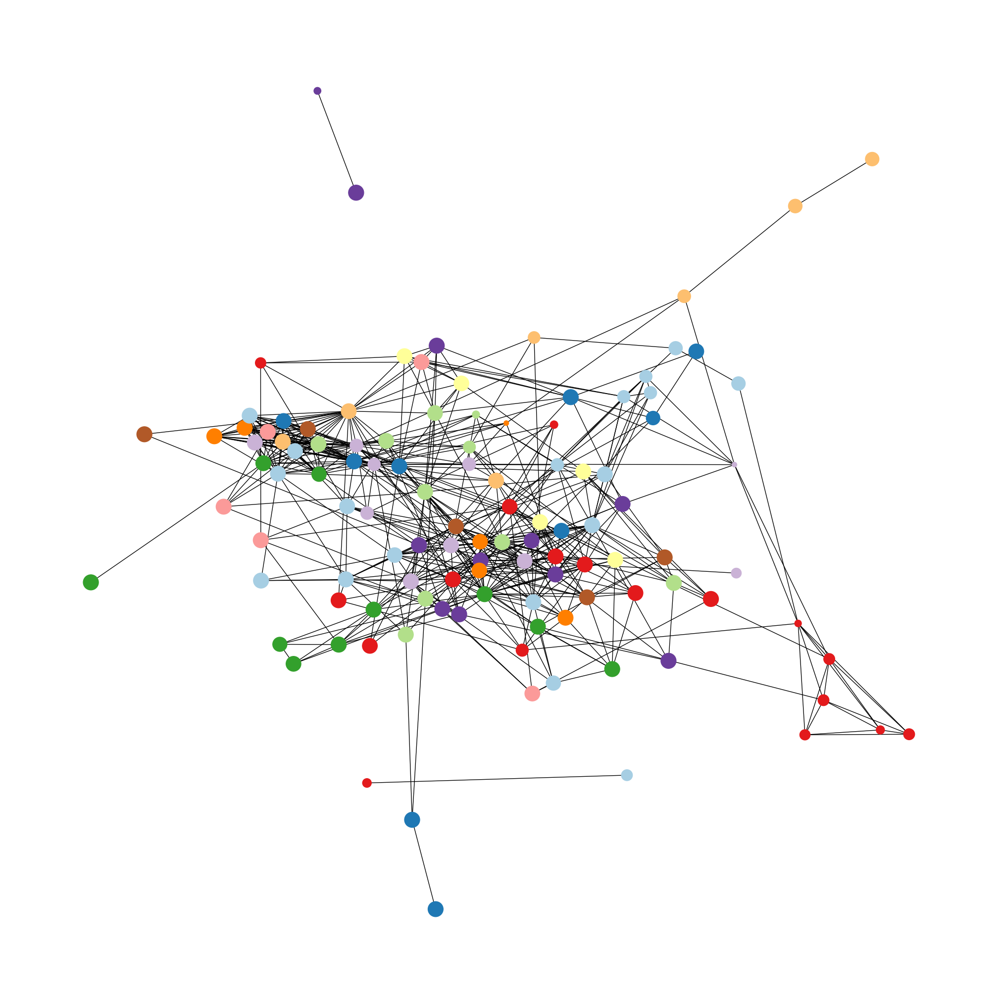

In [44]:
PPI_id_AAT_df = PPI_id_df[(PPI_id_df['C_1'].isin(AAT_C_t)) & (PPI_id_df['C_2'].isin(AAT_C_t))].reset_index(drop=True)
AAT_C_PPI_edge_t = PPI_id_AAT_df.set_index(['node1','node2']).to_dict()['weight']
AAT_C_PPI_node = list(set([str(i) for i in PPI_id_AAT_df['node1'].tolist()] + [str(i) for i in PPI_id_AAT_df['node2'].tolist()]))
AAT_C_PPI_t = list(set([id_C[i] for i in AAT_C_PPI_node]))
AAT_PPI_G = nx.Graph()
#AAT_PPI_G.add_nodes_from(AAT_C_PPI_node) 
AAT_PPI_node_min = min([id_pro_len[i] for i in (AAT_C_PPI_node)])
AAT_PPI_node_max = max([id_pro_len[i] for i in (AAT_C_PPI_node)]) 
for edge, w in AAT_C_PPI_edge_t.items():
    AAT_PPI_G.add_edge(str(edge[0]), str(edge[1]), weight = w)   
#nx.set_node_attributes(AAT_PPI_G, label_dict, 'fun_name')
nx.set_node_attributes(AAT_PPI_G, id_C, 'C')
nx.set_node_attributes(AAT_PPI_G, id_pro_len, 'pro_len')
node_labels = nx.get_node_attributes(AAT_PPI_G, 'fun_name')
print('number of nodes: ', AAT_PPI_G.number_of_nodes())
print('number of edges: ', AAT_PPI_G.number_of_edges())
print('number of PPI C: ', len(AAT_C_PPI_t))


AAT_PPI_G_connected_node = list()
for c in nx.connected_components(AAT_PPI_G):
    nodeSet = AAT_PPI_G.subgraph(c).nodes()
    AAT_PPI_G_connected_node.append(nodeSet)
print('number of subgraAAT: ', len(AAT_PPI_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(AAT_C_PPI_t)) 
node_color = [color_palette[AAT_C_PPI_t.index(node[1]['C'])] for node in AAT_PPI_G.nodes()(data=True)]
node_size = [50 + 450*(node[1]['pro_len'] - AAT_PPI_node_min)/(AAT_PPI_node_max - AAT_PPI_node_min)  for node in AAT_PPI_G.nodes()(data=True)]
pos = nx.spring_layout(AAT_PPI_G, k=2) #,iterations=50
#pos = nx.kamada_kawai_layout(AAT_PPI_G)
nx.draw(AAT_PPI_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        node_color=node_color,
       )

### 丙氨酸、天冬氨酸和谷氨酸代谢 AAG

In [46]:
pro_AAG_dict = {}
with open('../function/AAG_mis.fasta') as f:
    for line in f:
        line = line.strip('\n')
        if line.startswith('>'):
            pro_AAG_dict[line[1:]] = pro_K[line[1:]]
id_AAG_dict = {}
for k, v in pro_AAG_dict.items():
    if pro_id[k] not in id_AAG_dict:
        id_AAG_dict[pro_id[k]] = []
    id_AAG_dict[pro_id[k]]  = list(set(v+id_AAG_dict[pro_id[k]]))
id_AAG_dict = {k:v if len(v) != 0 else ['AAG?'] for k, v in id_AAG_dict.items()}
AAG_id_origin = list(id_AAG_dict.keys())
C_AAG_dict = {}
C_AAG_value_dict = {}
C_AAG_count_dict = {}
for k, v in id_AAG_dict.items():
    if id_C[k] not in C_AAG_dict:
        C_AAG_dict[id_C[k]] = []
        C_AAG_value_dict[id_C[k]] = []
    C_AAG_dict[id_C[k]] = list(set(C_AAG_dict[id_C[k]] + v))
    C_AAG_value_dict[id_C[k]] = C_AAG_value_dict[id_C[k]] + v
C_AAG_count_dict = {k:dict(Counter(v)) for k, v in C_AAG_value_dict.items()}
print('AAG pro count: ', len(pro_AAG_dict))
print('AAG node count: ',len(id_AAG_dict))
print('AAG C count: ',len(C_AAG_dict))

AAG_pred_df = pd.read_csv('../function/AAG_pred.txt', sep='\t', header=None)
AAG_pred_df = AAG_pred_df[AAG_pred_df[1].isin(pro_AAG_dict)]
AAG_pred_df['id_1'] = AAG_pred_df[0].apply(lambda x:pro_id[x])
AAG_pred_df['id_2'] = AAG_pred_df[1].apply(lambda x:pro_id[x])
AAG_pred_df['func'] = AAG_pred_df[1].apply(lambda x: pro_AAG_dict[x])
AAG_pred_f_df = AAG_pred_df[~(AAG_pred_df['id_1'].isin(AAG_id_origin))].loc[:, ['id_1','id_2','func']].drop_duplicates(subset=['id_1','id_2'])
id_AAG_pred_dict = AAG_pred_f_df.set_index('id_1').to_dict()['func']
id_AAG_pred_dict = {k:v if len(v) != 0 else ['AAG?'] for k, v in id_AAG_pred_dict.items()}
#id_AAG_dict.update(id_AAG_pred_dict)

AAG_node_origin = AAG_id_origin
AAG_edge_origin = id_edge_df[(id_edge_df[0].isin(AAG_node_origin))&(id_edge_df[1].isin(AAG_node_origin))].set_index([0,1]).to_dict()[2]
AAG_node_ex = list(id_AAG_pred_dict.keys())
AAG_node_t = list(id_AAG_dict.keys()) + list(id_AAG_pred_dict.keys())
AAG_edge_t_df = id_edge_df[(id_edge_df[0].isin(AAG_node_t))&(id_edge_df[1].isin(AAG_node_t))]
AAG_edge_t = AAG_edge_t_df.set_index([0,1]).to_dict()[2]
AAG_edge_pre = AAG_edge_t_df[(AAG_edge_t_df[0].isin(AAG_node_ex))|(AAG_edge_t_df[1].isin(AAG_node_ex))].set_index([0,1]).to_dict()[2]

AAG_C = list(C_AAG_dict.keys())
AAG_node_oC= [j for i in AAG_C for j in C_id[i] if j not in AAG_node_origin]
AAG_node_tC = [j for i in AAG_C for j in C_id[i] if j not in AAG_node_t]
AAG_edge_df = id_edge_df[(id_edge_df[0].isin(AAG_node_origin+AAG_node_oC))&(id_edge_df[1].isin(AAG_node_origin+AAG_node_oC))]
AAG_edge = AAG_edge_df[(AAG_edge_df[0].isin(AAG_node_oC))|(AAG_edge_df[1].isin(AAG_node_oC))].set_index([0,1]).to_dict()[2]
AAG_edge_ex_df = id_edge_df[(id_edge_df[0].isin(AAG_node_t+AAG_node_tC))&(id_edge_df[1].isin(AAG_node_t+AAG_node_tC))]
AAG_edge_ex = AAG_edge_ex_df[(AAG_edge_ex_df[0].isin(AAG_node_tC))|(AAG_edge_ex_df[1].isin(AAG_node_tC))].set_index([0,1]).to_dict()[2]
AAG_C_t = list(set([id_C[i] for i in AAG_node_t]))
print('AAG ex C count: ',len(AAG_C_t))
print('origin node: ', len(AAG_node_origin))
print('total node: ', len(AAG_node_t))
print('origin edge: ', len(AAG_edge_origin))
print('extend edge: ', len(AAG_edge_pre))
print('total edge: ', len(AAG_edge_t_df))
print('origin C nei node: ', len(AAG_node_oC))
print('origin C nei edge: ', len(AAG_edge_df))
print('total C nei node: ', len(AAG_node_tC))
print('total C nei edge: ', len(AAG_edge_ex_df))

AAG_node_onei = list(set([nei for node in AAG_node_origin for nei in find_nei(proid_G, node)[0]]) - set(AAG_node_origin))
AAG_node_tnei = list(set([nei for node in AAG_node_t for nei in find_nei(proid_G, node)[0]]) - set(AAG_node_t))
AAG_edge_onei_df = id_edge_df[(id_edge_df[0].isin(AAG_node_origin+AAG_node_onei))&(id_edge_df[1].isin(AAG_node_origin+AAG_node_onei))]
#AAG_edge_onei = AAG_edge_onei_df[AAG_edge_onei_df[0].isin(AAG_node_onei) | AAG_edge_onei_df[1].isin(AAG_node_onei)].set_index([0,1]).to_dict()[2]
AAG_edge_tnei_df = id_edge_df[(id_edge_df[0].isin(AAG_node_t+AAG_node_tnei))&(id_edge_df[1].isin(AAG_node_t+AAG_node_tnei))]
#AAG_edge_tnei = AAG_edge_tnei_df[AAG_edge_tnei_df[0].isin(AAG_node_tnei) | AAG_edge_tnei_df[1].isin(AAG_node_tnei)].set_index([0,1]).to_dict()[2]
AAG_GC_t =list(set([id_C[i] for i in AAG_node_t+AAG_node_tnei]))
print('origin  nei node: ', len(AAG_node_onei))
print('origin  nei edge: ', len(AAG_edge_onei_df))
print('total  nei node: ', len(AAG_node_tnei))
print('total  nei edge: ', len(AAG_edge_tnei_df))

AAG_PPI_o_df = PPI_id_df[(PPI_id_df['node1'].isin(AAG_node_origin))&(PPI_id_df['node2'].isin(AAG_node_origin))]
AAG_PPI_t_df = PPI_id_df[(PPI_id_df['node1'].isin(AAG_node_t))&(PPI_id_df['node2'].isin(AAG_node_t))]
AAG_node_o_PPI = list(set(AAG_PPI_o_df['node1'].tolist() + AAG_PPI_o_df['node2'].tolist()))
AAG_node_t_PPI = list(set(AAG_PPI_t_df['node1'].tolist() + AAG_PPI_t_df['node2'].tolist()))
print('PPI orign node: ', len(AAG_node_o_PPI))
print('PPI total node: ', len(AAG_node_t_PPI))
print('PPI orign edge: ', len(AAG_PPI_o_df))
print('PPI total edge: ', len(AAG_PPI_t_df)) 
id_AAG_t_dict = {k:id_AAG_dict[k] if k in id_AAG_dict else id_AAG_pred_dict[k] for k in AAG_node_t}
id_AAG_dict_G = {k:','.join(v) + ' **' if int(k) in AAG_node_t_PPI  else ','.join(v) for k, v in id_AAG_t_dict.items()}

AAG pro count:  3462
AAG node count:  40
AAG C count:  40
AAG ex C count:  51
origin node:  40
total node:  51
origin edge:  2
extend edge:  1
total edge:  3
origin C nei node:  387
origin C nei edge:  398
total C nei node:  387
total C nei edge:  403
origin  nei node:  545
origin  nei edge:  1316
total  nei node:  548
total  nei edge:  1329
PPI orign node:  24
PPI total node:  24
PPI orign edge:  167
PPI total edge:  167


number of nodes:  51
number of edges:  3
number of subgraAAG:  48


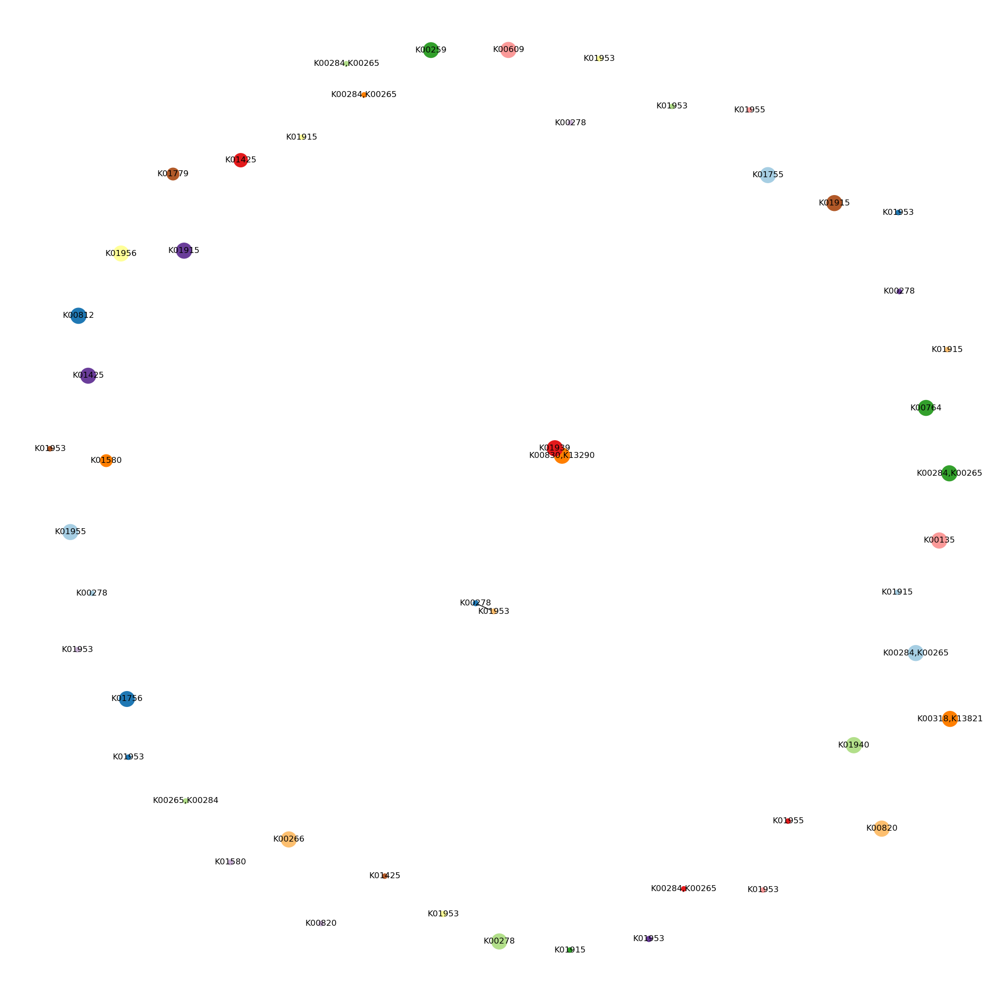

In [47]:
AAG_G = nx.Graph()
AAG_G.add_nodes_from(AAG_node_t) 
#AAG_G.add_nodes_from(AAG_node_tnei) 
AAG_weight_min = min(list(AAG_edge_t.values()) + list(AAG_edge_ex.values())) #list(AAG_edge_tnei.values())
AAG_weight_max = max(list(AAG_edge_t.values()) + list(AAG_edge_ex.values())) #+ list(AAG_edge_tnei.values())
AAG_node_min = min([id_pro_len[i] for i in (AAG_node_t + AAG_node_tC)]) #+ AAG_node_tnei
AAG_node_max = max([id_pro_len[i] for i in (AAG_node_t + AAG_node_tC)]) #+ AAG_node_tnei
#AAG_node_max = min(162, max([id_pro_len[i] for i in (AAG_node_t + AAG_node_tnei + AAG_node_tC)]))
for edge, w in AAG_edge_origin.items():
    AAG_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl='o') 
for edge, w in AAG_edge_pre.items():
    AAG_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'e') 
#for edge, w in AAG_edge_ex.items():
    #AAG_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'C') 
#for edge, w in AAG_edge_tnei.items():
#    AAG_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'n') 
    
nx.set_node_attributes(AAG_G, id_AAG_dict_G, 'fun_name')
nx.set_node_attributes(AAG_G, id_C, 'C')
nx.set_node_attributes(AAG_G, id_pro_len, 'pro_len')
#nx.set_node_attributes(AAG_G, id_type, 'C_type')
node_labels = nx.get_node_attributes(AAG_G, 'fun_name')
print('number of nodes: ', AAG_G.number_of_nodes())
print('number of edges: ', AAG_G.number_of_edges())

eorigin=[(u,v) for (u,v,d) in AAG_G.edges(data=True) if d['cl'] == 'o']
eex=[(u,v) for (u,v,d) in AAG_G.edges(data=True) if d['cl'] == 'e']
eC=[(u,v) for (u,v,d) in AAG_G.edges(data=True) if d['cl'] == 'C']
enei=[(u,v) for (u,v,d) in AAG_G.edges(data=True) if d['cl'] == 'n']

AAG_G_connected_node = list()
for c in nx.connected_components(AAG_G):
    nodeSet = AAG_G.subgraph(c).nodes()
    AAG_G_connected_node.append(nodeSet)
print('number of subgraAAG: ', len(AAG_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(AAG_C_t)) 
node_color = [color_palette[AAG_C_t.index(node[1]['C'])] for node in AAG_G.nodes()(data=True)]
node_size = [50 + 950*(node[1]['pro_len'] - AAG_node_min)/(AAG_node_max - AAG_node_min)  for node in AAG_G.nodes()(data=True)]
pos = nx.spring_layout(AAG_G, k=0.2) #,iterations=50
#pos = nx.kamada_kawai_layout(AAG_G)
width_normal = [1 + 5*(float(abs(d['weight'])) - AAG_weight_min)/(AAG_weight_max -AAG_weight_min) for (u,v,d) in AAG_G.edges()(data=True)]
nx.draw(AAG_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        edgelist=eorigin,
        node_color=node_color,
        width=width_normal
       )
#nx.draw_networkx_edge_labels(AAG_pred_G, pos, label_pos=0.5,  rotate=False, font_size=8)
#nx.draw_networkx_edges(AAG_G,pos,edgelist=eex,style = ':',
#                      width= width_normal, alpha=1
#                      )
#nx.draw_networkx_edges(AAG_G,pos,edgelist=eC,style = '--',
#                      width= width_normal, alpha=1
#                      )
#nx.draw_networkx_edges(AAG_G,pos,edgelist=enei,style = '--',
#                      width= width_normal, alpha=0.8
 #                     )

number of nodes:  150
number of edges:  981
number of PPI C:  28
number of subgraAAG:  1


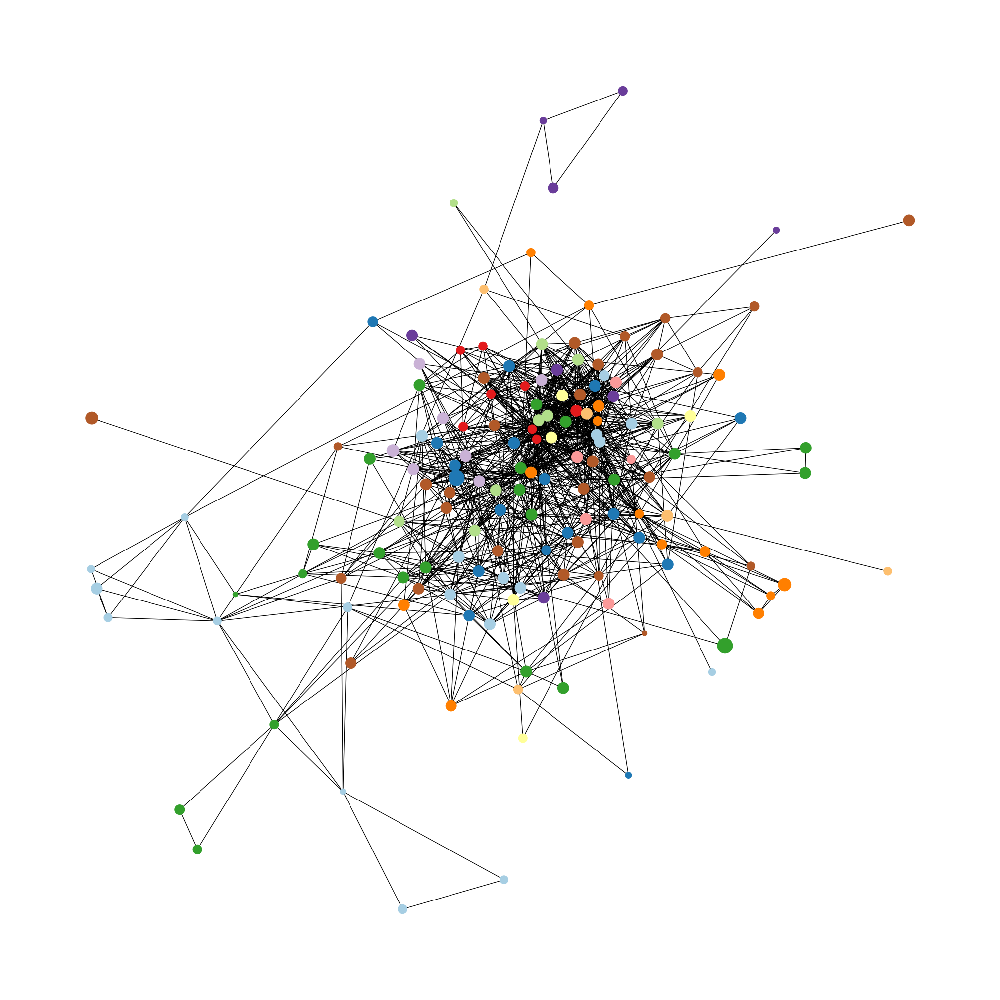

In [48]:
PPI_id_AAG_df = PPI_id_df[(PPI_id_df['C_1'].isin(AAG_C_t)) & (PPI_id_df['C_2'].isin(AAG_C_t))].reset_index(drop=True)
AAG_C_PPI_edge_t = PPI_id_AAG_df.set_index(['node1','node2']).to_dict()['weight']
AAG_C_PPI_node = list(set([str(i) for i in PPI_id_AAG_df['node1'].tolist()] + [str(i) for i in PPI_id_AAG_df['node2'].tolist()]))
AAG_C_PPI_t = list(set([id_C[i] for i in AAG_C_PPI_node]))
AAG_PPI_G = nx.Graph()
#AAG_PPI_G.add_nodes_from(AAG_C_PPI_node) 
AAG_PPI_node_min = min([id_pro_len[i] for i in (AAG_C_PPI_node)])
AAG_PPI_node_max = max([id_pro_len[i] for i in (AAG_C_PPI_node)]) 
for edge, w in AAG_C_PPI_edge_t.items():
    AAG_PPI_G.add_edge(str(edge[0]), str(edge[1]), weight = w)   
#nx.set_node_attributes(AAG_PPI_G, label_dict, 'fun_name')
nx.set_node_attributes(AAG_PPI_G, id_C, 'C')
nx.set_node_attributes(AAG_PPI_G, id_pro_len, 'pro_len')
node_labels = nx.get_node_attributes(AAG_PPI_G, 'fun_name')
print('number of nodes: ', AAG_PPI_G.number_of_nodes())
print('number of edges: ', AAG_PPI_G.number_of_edges())
print('number of PPI C: ', len(AAG_C_PPI_t))


AAG_PPI_G_connected_node = list()
for c in nx.connected_components(AAG_PPI_G):
    nodeSet = AAG_PPI_G.subgraph(c).nodes()
    AAG_PPI_G_connected_node.append(nodeSet)
print('number of subgraAAG: ', len(AAG_PPI_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(AAG_C_PPI_t)) 
node_color = [color_palette[AAG_C_PPI_t.index(node[1]['C'])] for node in AAG_PPI_G.nodes()(data=True)]
node_size = [50 + 450*(node[1]['pro_len'] - AAG_PPI_node_min)/(AAG_PPI_node_max - AAG_PPI_node_min)  for node in AAG_PPI_G.nodes()(data=True)]
pos = nx.spring_layout(AAG_PPI_G, k=2) #,iterations=50
#pos = nx.kamada_kawai_layout(AAG_PPI_G)
nx.draw(AAG_PPI_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        node_color=node_color,
       )

### 精氨酸和脯氨酸代谢 AP

In [49]:
pro_AP_dict = {}
with open('../function/AP_mis.fasta') as f:
    for line in f:
        line = line.strip('\n')
        if line.startswith('>'):
            pro_AP_dict[line[1:]] = pro_K[line[1:]]
id_AP_dict = {}
for k, v in pro_AP_dict.items():
    if pro_id[k] not in id_AP_dict:
        id_AP_dict[pro_id[k]] = []
    id_AP_dict[pro_id[k]]  = list(set(v+id_AP_dict[pro_id[k]]))
id_AP_dict = {k:v if len(v) != 0 else ['AP?'] for k, v in id_AP_dict.items()}
AP_id_origin = list(id_AP_dict.keys())
C_AP_dict = {}
C_AP_value_dict = {}
C_AP_count_dict = {}
for k, v in id_AP_dict.items():
    if id_C[k] not in C_AP_dict:
        C_AP_dict[id_C[k]] = []
        C_AP_value_dict[id_C[k]] = []
    C_AP_dict[id_C[k]] = list(set(C_AP_dict[id_C[k]] + v))
    C_AP_value_dict[id_C[k]] = C_AP_value_dict[id_C[k]] + v
C_AP_count_dict = {k:dict(Counter(v)) for k, v in C_AP_value_dict.items()}
print('AP pro count: ', len(pro_AP_dict))
print('AP node count: ',len(id_AP_dict))
print('AP C count: ',len(C_AP_dict))

AP_pred_df = pd.read_csv('../function/AP_pred.txt', sep='\t', header=None)
AP_pred_df = AP_pred_df[AP_pred_df[1].isin(pro_AP_dict)]
AP_pred_df['id_1'] = AP_pred_df[0].apply(lambda x:pro_id[x])
AP_pred_df['id_2'] = AP_pred_df[1].apply(lambda x:pro_id[x])
AP_pred_df['func'] = AP_pred_df[1].apply(lambda x: pro_AP_dict[x])
AP_pred_f_df = AP_pred_df[~(AP_pred_df['id_1'].isin(AP_id_origin))].loc[:, ['id_1','id_2','func']].drop_duplicates(subset=['id_1','id_2'])
id_AP_pred_dict = AP_pred_f_df.set_index('id_1').to_dict()['func']
id_AP_pred_dict = {k:v if len(v) != 0 else ['AP?'] for k, v in id_AP_pred_dict.items()}
#id_AP_dict.update(id_AP_pred_dict)

AP_node_origin = AP_id_origin
AP_edge_origin = id_edge_df[(id_edge_df[0].isin(AP_node_origin))&(id_edge_df[1].isin(AP_node_origin))].set_index([0,1]).to_dict()[2]
AP_node_ex = list(id_AP_pred_dict.keys())
AP_node_t = list(id_AP_dict.keys()) + list(id_AP_pred_dict.keys())
AP_edge_t_df = id_edge_df[(id_edge_df[0].isin(AP_node_t))&(id_edge_df[1].isin(AP_node_t))]
AP_edge_t = AP_edge_t_df.set_index([0,1]).to_dict()[2]
AP_edge_pre = AP_edge_t_df[(AP_edge_t_df[0].isin(AP_node_ex))|(AP_edge_t_df[1].isin(AP_node_ex))].set_index([0,1]).to_dict()[2]

AP_C = list(C_AP_dict.keys())
AP_node_oC= [j for i in AP_C for j in C_id[i] if j not in AP_node_origin]
AP_node_tC = [j for i in AP_C for j in C_id[i] if j not in AP_node_t]
AP_edge_df = id_edge_df[(id_edge_df[0].isin(AP_node_origin+AP_node_oC))&(id_edge_df[1].isin(AP_node_origin+AP_node_oC))]
AP_edge = AP_edge_df[(AP_edge_df[0].isin(AP_node_oC))|(AP_edge_df[1].isin(AP_node_oC))].set_index([0,1]).to_dict()[2]
AP_edge_ex_df = id_edge_df[(id_edge_df[0].isin(AP_node_t+AP_node_tC))&(id_edge_df[1].isin(AP_node_t+AP_node_tC))]
AP_edge_ex = AP_edge_ex_df[(AP_edge_ex_df[0].isin(AP_node_tC))|(AP_edge_ex_df[1].isin(AP_node_tC))].set_index([0,1]).to_dict()[2]
AP_C_t = list(set([id_C[i] for i in AP_node_t]))
print('AP ex C count: ',len(AP_C_t))
print('origin node: ', len(AP_node_origin))
print('total node: ', len(AP_node_t))
print('origin edge: ', len(AP_edge_origin))
print('extend edge: ', len(AP_edge_pre))
print('total edge: ', len(AP_edge_t_df))
print('origin C nei node: ', len(AP_node_oC))
print('origin C nei edge: ', len(AP_edge_df))
print('total C nei node: ', len(AP_node_tC))
print('total C nei edge: ', len(AP_edge_ex_df))

AP_node_onei = list(set([nei for node in AP_node_origin for nei in find_nei(proid_G, node)[0]]) - set(AP_node_origin))
AP_node_tnei = list(set([nei for node in AP_node_t for nei in find_nei(proid_G, node)[0]]) - set(AP_node_t))
AP_edge_onei_df = id_edge_df[(id_edge_df[0].isin(AP_node_origin+AP_node_onei))&(id_edge_df[1].isin(AP_node_origin+AP_node_onei))]
#AP_edge_onei = AP_edge_onei_df[AP_edge_onei_df[0].isin(AP_node_onei) | AP_edge_onei_df[1].isin(AP_node_onei)].set_index([0,1]).to_dict()[2]
AP_edge_tnei_df = id_edge_df[(id_edge_df[0].isin(AP_node_t+AP_node_tnei))&(id_edge_df[1].isin(AP_node_t+AP_node_tnei))]
#AP_edge_tnei = AP_edge_tnei_df[AP_edge_tnei_df[0].isin(AP_node_tnei) | AP_edge_tnei_df[1].isin(AP_node_tnei)].set_index([0,1]).to_dict()[2]
AP_GC_t =list(set([id_C[i] for i in AP_node_t+AP_node_tnei]))
print('origin  nei node: ', len(AP_node_onei))
print('origin  nei edge: ', len(AP_edge_onei_df))
print('total  nei node: ', len(AP_node_tnei))
print('total  nei edge: ', len(AP_edge_tnei_df))

AP_PPI_o_df = PPI_id_df[(PPI_id_df['node1'].isin(AP_node_origin))&(PPI_id_df['node2'].isin(AP_node_origin))]
AP_PPI_t_df = PPI_id_df[(PPI_id_df['node1'].isin(AP_node_t))&(PPI_id_df['node2'].isin(AP_node_t))]
AP_node_o_PPI = list(set(AP_PPI_o_df['node1'].tolist() + AP_PPI_o_df['node2'].tolist()))
AP_node_t_PPI = list(set(AP_PPI_t_df['node1'].tolist() + AP_PPI_t_df['node2'].tolist()))
print('PPI orign node: ', len(AP_node_o_PPI))
print('PPI total node: ', len(AP_node_t_PPI))
print('PPI orign edge: ', len(AP_PPI_o_df))
print('PPI total edge: ', len(AP_PPI_t_df)) 
id_AP_t_dict = {k:id_AP_dict[k] if k in id_AP_dict else id_AP_pred_dict[k] for k in AP_node_t}
id_AP_dict_G = {k:','.join(v) + ' **' if int(k) in AP_node_t_PPI  else ','.join(v) for k, v in id_AP_t_dict.items()}

AP pro count:  3007
AP node count:  34
AP C count:  34
AP ex C count:  41
origin node:  34
total node:  42
origin edge:  0
extend edge:  1
total edge:  1
origin C nei node:  318
origin C nei edge:  289
total C nei node:  317
total C nei edge:  293
origin  nei node:  393
origin  nei edge:  830
total  nei node:  402
total  nei edge:  868
PPI orign node:  19
PPI total node:  21
PPI orign edge:  52
PPI total edge:  74


number of nodes:  42
number of edges:  1
number of subgraAP:  41


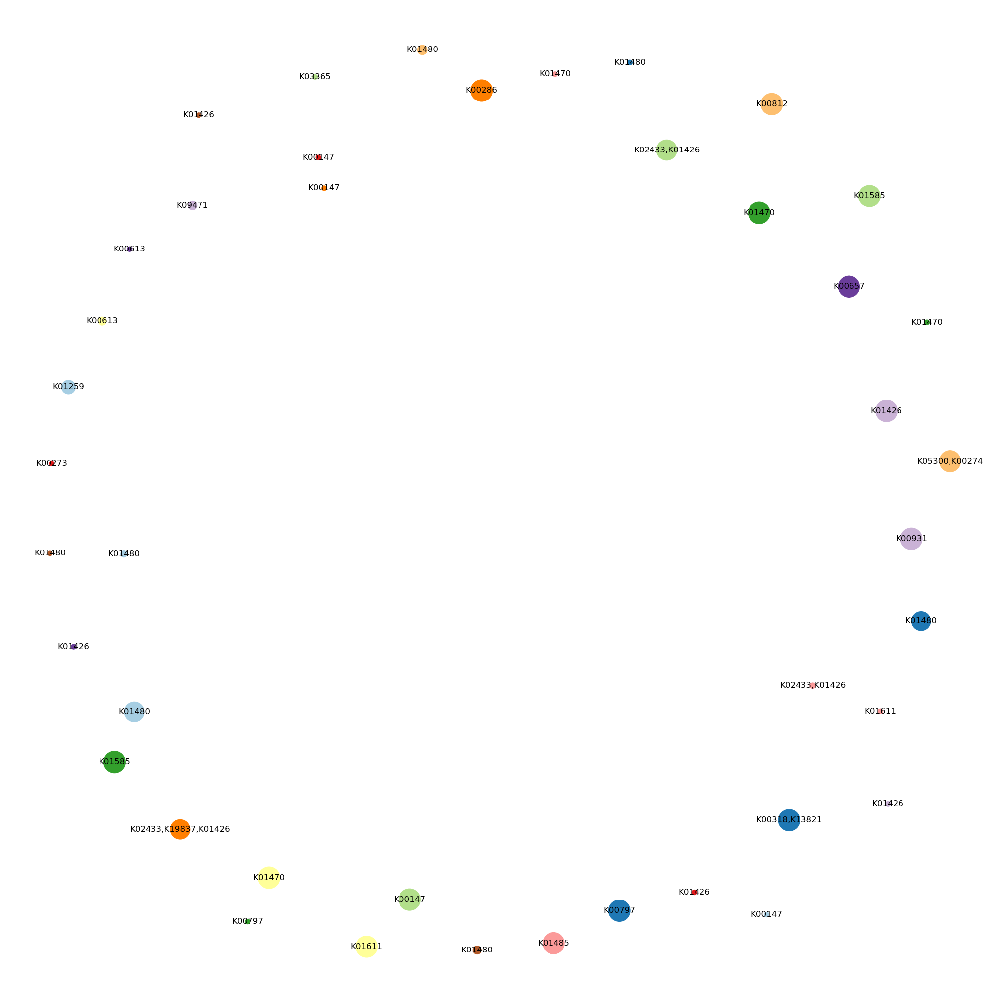

In [50]:
AP_G = nx.Graph()
AP_G.add_nodes_from(AP_node_t) 
#AP_G.add_nodes_from(AP_node_tnei) 
AP_weight_min = min(list(AP_edge_t.values()) + list(AP_edge_ex.values())) #list(AP_edge_tnei.values())
AP_weight_max = max(list(AP_edge_t.values()) + list(AP_edge_ex.values())) #+ list(AP_edge_tnei.values())
AP_node_min = min([id_pro_len[i] for i in (AP_node_t + AP_node_tC)]) #+ AP_node_tnei
AP_node_max = max([id_pro_len[i] for i in (AP_node_t + AP_node_tC)]) #+ AP_node_tnei
#AP_node_max = min(162, max([id_pro_len[i] for i in (AP_node_t + AP_node_tnei + AP_node_tC)]))
for edge, w in AP_edge_origin.items():
    AP_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl='o') 
for edge, w in AP_edge_pre.items():
    AP_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'e') 
#for edge, w in AP_edge_ex.items():
    #AP_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'C') 
#for edge, w in AP_edge_tnei.items():
    #AP_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'n') 
    
nx.set_node_attributes(AP_G, id_AP_dict_G, 'fun_name')
nx.set_node_attributes(AP_G, id_C, 'C')
nx.set_node_attributes(AP_G, id_pro_len, 'pro_len')
#nx.set_node_attributes(AP_G, id_type, 'C_type')
node_labels = nx.get_node_attributes(AP_G, 'fun_name')
print('number of nodes: ', AP_G.number_of_nodes())
print('number of edges: ', AP_G.number_of_edges())

eorigin=[(u,v) for (u,v,d) in AP_G.edges(data=True) if d['cl'] == 'o']
eex=[(u,v) for (u,v,d) in AP_G.edges(data=True) if d['cl'] == 'e']
#eC=[(u,v) for (u,v,d) in AP_G.edges(data=True) if d['cl'] == 'C']
#enei=[(u,v) for (u,v,d) in AP_G.edges(data=True) if d['cl'] == 'n']

AP_G_connected_node = list()
for c in nx.connected_components(AP_G):
    nodeSet = AP_G.subgraph(c).nodes()
    AP_G_connected_node.append(nodeSet)
print('number of subgraAP: ', len(AP_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(AP_C_t)) 
node_color = [color_palette[AP_C_t.index(node[1]['C'])] for node in AP_G.nodes()(data=True)]
node_size = [50 + 950*(node[1]['pro_len'] - AP_node_min)/(AP_node_max - AP_node_min)  for node in AP_G.nodes()(data=True)]
pos = nx.spring_layout(AP_G, k=0.2) #,iterations=50
#pos = nx.kamada_kawai_layout(AP_G)
width_normal = [1 + 5*(float(abs(d['weight'])) - AP_weight_min)/(AP_weight_max -AP_weight_min) for (u,v,d) in AP_G.edges()(data=True)]
nx.draw(AP_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        edgelist=eorigin,
        node_color=node_color,
        width=width_normal
       )
#nx.draw_networkx_edge_labels(AP_pred_G, pos, label_pos=0.5,  rotate=False, font_size=8)
#nx.draw_networkx_edges(AP_G,pos,edgelist=eex,style = ':',
#                      width= width_normal, alpha=1
#                      )
#nx.draw_networkx_edges(AP_G,pos,edgelist=eC,style = '--',
#                      width= width_normal, alpha=1
#                      )
#nx.draw_networkx_edges(AP_G,pos,edgelist=enei,style = '--',
#                      width= width_normal, alpha=0.8
#                      )

number of nodes:  119
number of edges:  515
number of PPI C:  26
number of subgraAP:  1


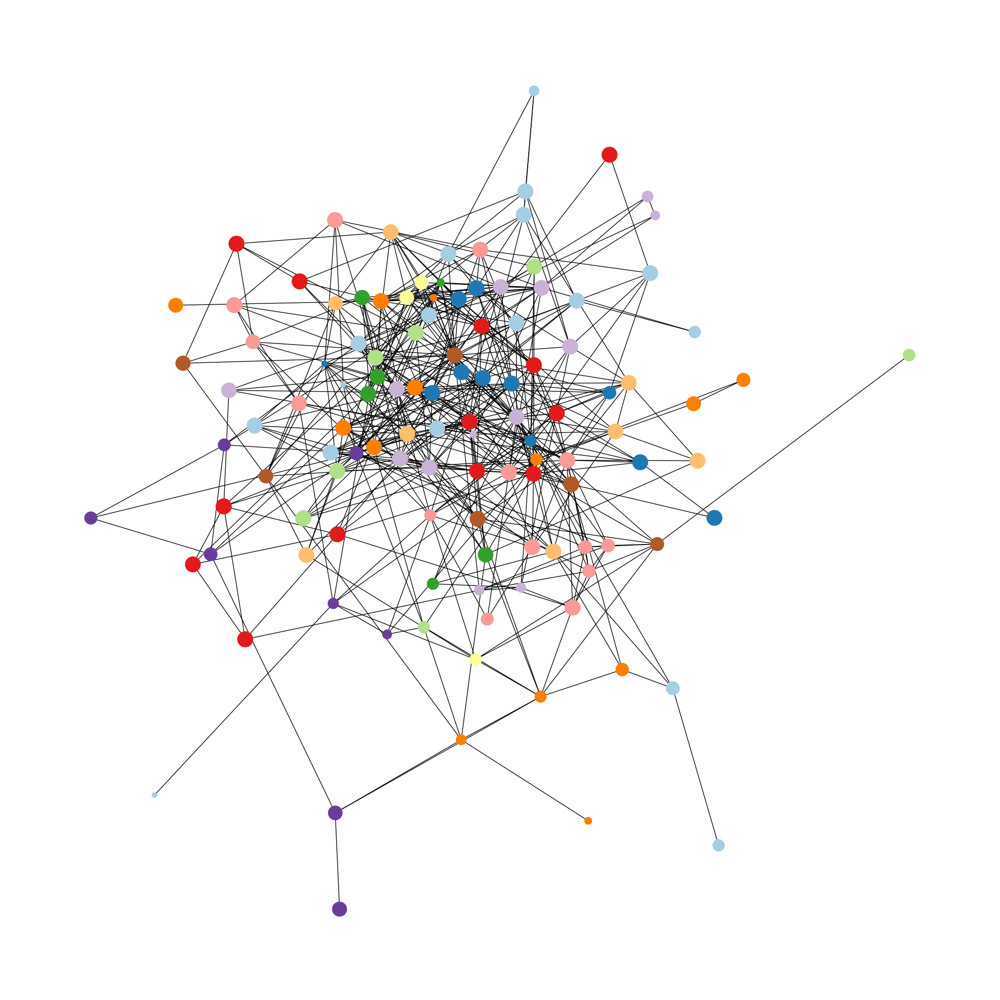

In [51]:
PPI_id_AP_df = PPI_id_df[(PPI_id_df['C_1'].isin(AP_C_t)) & (PPI_id_df['C_2'].isin(AP_C_t))].reset_index(drop=True)
AP_C_PPI_edge_t = PPI_id_AP_df.set_index(['node1','node2']).to_dict()['weight']
AP_C_PPI_node = list(set([str(i) for i in PPI_id_AP_df['node1'].tolist()] + [str(i) for i in PPI_id_AP_df['node2'].tolist()]))
AP_C_PPI_t = list(set([id_C[i] for i in AP_C_PPI_node]))
AP_PPI_G = nx.Graph()
#AP_PPI_G.add_nodes_from(AP_C_PPI_node) 
AP_PPI_node_min = min([id_pro_len[i] for i in (AP_C_PPI_node)])
AP_PPI_node_max = max([id_pro_len[i] for i in (AP_C_PPI_node)]) 
for edge, w in AP_C_PPI_edge_t.items():
    AP_PPI_G.add_edge(str(edge[0]), str(edge[1]), weight = w)   
#nx.set_node_attributes(AP_PPI_G, label_dict, 'fun_name')
nx.set_node_attributes(AP_PPI_G, id_C, 'C')
nx.set_node_attributes(AP_PPI_G, id_pro_len, 'pro_len')
node_labels = nx.get_node_attributes(AP_PPI_G, 'fun_name')
print('number of nodes: ', AP_PPI_G.number_of_nodes())
print('number of edges: ', AP_PPI_G.number_of_edges())
print('number of PPI C: ', len(AP_C_PPI_t))


AP_PPI_G_connected_node = list()
for c in nx.connected_components(AP_PPI_G):
    nodeSet = AP_PPI_G.subgraph(c).nodes()
    AP_PPI_G_connected_node.append(nodeSet)
print('number of subgraAP: ', len(AP_PPI_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(AP_C_PPI_t)) 
node_color = [color_palette[AP_C_PPI_t.index(node[1]['C'])] for node in AP_PPI_G.nodes()(data=True)]
node_size = [50 + 450*(node[1]['pro_len'] - AP_PPI_node_min)/(AP_PPI_node_max - AP_PPI_node_min)  for node in AP_PPI_G.nodes()(data=True)]
pos = nx.spring_layout(AP_PPI_G, k=2) #,iterations=50
#pos = nx.kamada_kawai_layout(AP_PPI_G)
nx.draw(AP_PPI_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        node_color=node_color,
       )

### 细菌分泌系统 BBS

In [52]:
pro_BBS_dict = {}
with open('../function/BBS_mis.fasta') as f:
    for line in f:
        line = line.strip('\n')
        if line.startswith('>'):
            pro_BBS_dict[line[1:]] = pro_K[line[1:]]
id_BBS_dict = {}
for k, v in pro_BBS_dict.items():
    if pro_id[k] not in id_BBS_dict:
        id_BBS_dict[pro_id[k]] = []
    id_BBS_dict[pro_id[k]]  = list(set(v+id_BBS_dict[pro_id[k]]))
id_BBS_dict = {k:v if len(v) != 0 else ['BBS?'] for k, v in id_BBS_dict.items()}
BBS_id_origin = list(id_BBS_dict.keys())
C_BBS_dict = {}
C_BBS_value_dict = {}
C_BBS_count_dict = {}
for k, v in id_BBS_dict.items():
    if id_C[k] not in C_BBS_dict:
        C_BBS_dict[id_C[k]] = []
        C_BBS_value_dict[id_C[k]] = []
    C_BBS_dict[id_C[k]] = list(set(C_BBS_dict[id_C[k]] + v))
    C_BBS_value_dict[id_C[k]] = C_BBS_value_dict[id_C[k]] + v
C_BBS_count_dict = {k:dict(Counter(v)) for k, v in C_BBS_value_dict.items()}
print('BBS pro count: ', len(pro_BBS_dict))
print('BBS node count: ',len(id_BBS_dict))
print('BBS C count: ',len(C_BBS_dict))

BBS_pred_df = pd.read_csv('../function/BBS_pred.txt', sep='\t', header=None)
BBS_pred_df = BBS_pred_df[BBS_pred_df[1].isin(pro_BBS_dict)]
BBS_pred_df['id_1'] = BBS_pred_df[0].apply(lambda x:pro_id[x])
BBS_pred_df['id_2'] = BBS_pred_df[1].apply(lambda x:pro_id[x])
BBS_pred_df['func'] = BBS_pred_df[1].apply(lambda x: pro_BBS_dict[x])
BBS_pred_f_df = BBS_pred_df[~(BBS_pred_df['id_1'].isin(BBS_id_origin))].loc[:, ['id_1','id_2','func']].drop_duplicates(subset=['id_1','id_2'])
id_BBS_pred_dict = BBS_pred_f_df.set_index('id_1').to_dict()['func']
id_BBS_pred_dict = {k:v if len(v) != 0 else ['BBS?'] for k, v in id_BBS_pred_dict.items()}
#id_BBS_dict.update(id_BBS_pred_dict)

BBS_node_origin = BBS_id_origin
BBS_edge_origin = id_edge_df[(id_edge_df[0].isin(BBS_node_origin))&(id_edge_df[1].isin(BBS_node_origin))].set_index([0,1]).to_dict()[2]
BBS_node_ex = list(id_BBS_pred_dict.keys())
BBS_node_t = list(id_BBS_dict.keys()) + list(id_BBS_pred_dict.keys())
BBS_edge_t_df = id_edge_df[(id_edge_df[0].isin(BBS_node_t))&(id_edge_df[1].isin(BBS_node_t))]
BBS_edge_t = BBS_edge_t_df.set_index([0,1]).to_dict()[2]
BBS_edge_pre = BBS_edge_t_df[(BBS_edge_t_df[0].isin(BBS_node_ex))|(BBS_edge_t_df[1].isin(BBS_node_ex))].set_index([0,1]).to_dict()[2]

BBS_C = list(C_BBS_dict.keys())
BBS_node_oC= [j for i in BBS_C for j in C_id[i] if j not in BBS_node_origin]
BBS_node_tC = [j for i in BBS_C for j in C_id[i] if j not in BBS_node_t]
BBS_edge_df = id_edge_df[(id_edge_df[0].isin(BBS_node_origin+BBS_node_oC))&(id_edge_df[1].isin(BBS_node_origin+BBS_node_oC))]
BBS_edge = BBS_edge_df[(BBS_edge_df[0].isin(BBS_node_oC))|(BBS_edge_df[1].isin(BBS_node_oC))].set_index([0,1]).to_dict()[2]
BBS_edge_ex_df = id_edge_df[(id_edge_df[0].isin(BBS_node_t+BBS_node_tC))&(id_edge_df[1].isin(BBS_node_t+BBS_node_tC))]
BBS_edge_ex = BBS_edge_ex_df[(BBS_edge_ex_df[0].isin(BBS_node_tC))|(BBS_edge_ex_df[1].isin(BBS_node_tC))].set_index([0,1]).to_dict()[2]
BBS_C_t = list(set([id_C[i] for i in BBS_node_t]))
print('BBS ex C count: ',len(BBS_C_t))
print('origin node: ', len(BBS_node_origin))
print('total node: ', len(BBS_node_t))
print('origin edge: ', len(BBS_edge_origin))
print('extend edge: ', len(BBS_edge_pre))
print('total edge: ', len(BBS_edge_t_df))
print('origin C nei node: ', len(BBS_node_oC))
print('origin C nei edge: ', len(BBS_edge_df))
print('total C nei node: ', len(BBS_node_tC))
print('total C nei edge: ', len(BBS_edge_ex_df))

BBS_node_onei = list(set([nei for node in BBS_node_origin for nei in find_nei(proid_G, node)[0]]) - set(BBS_node_origin))
BBS_node_tnei = list(set([nei for node in BBS_node_t for nei in find_nei(proid_G, node)[0]]) - set(BBS_node_t))
BBS_edge_onei_df = id_edge_df[(id_edge_df[0].isin(BBS_node_origin+BBS_node_onei))&(id_edge_df[1].isin(BBS_node_origin+BBS_node_onei))]
#BBS_edge_onei = BBS_edge_onei_df[BBS_edge_onei_df[0].isin(BBS_node_onei) | BBS_edge_onei_df[1].isin(BBS_node_onei)].set_index([0,1]).to_dict()[2]
BBS_edge_tnei_df = id_edge_df[(id_edge_df[0].isin(BBS_node_t+BBS_node_tnei))&(id_edge_df[1].isin(BBS_node_t+BBS_node_tnei))]
#BBS_edge_tnei = BBS_edge_tnei_df[BBS_edge_tnei_df[0].isin(BBS_node_tnei) | BBS_edge_tnei_df[1].isin(BBS_node_tnei)].set_index([0,1]).to_dict()[2]
BBS_GC_t =list(set([id_C[i] for i in BBS_node_t+BBS_node_tnei]))
print('origin  nei node: ', len(BBS_node_onei))
print('origin  nei edge: ', len(BBS_edge_onei_df))
print('total  nei node: ', len(BBS_node_tnei))
print('total  nei edge: ', len(BBS_edge_tnei_df))

BBS_PPI_o_df = PPI_id_df[(PPI_id_df['node1'].isin(BBS_node_origin))&(PPI_id_df['node2'].isin(BBS_node_origin))]
BBS_PPI_t_df = PPI_id_df[(PPI_id_df['node1'].isin(BBS_node_t))&(PPI_id_df['node2'].isin(BBS_node_t))]
BBS_node_o_PPI = list(set(BBS_PPI_o_df['node1'].tolist() + BBS_PPI_o_df['node2'].tolist()))
BBS_node_t_PPI = list(set(BBS_PPI_t_df['node1'].tolist() + BBS_PPI_t_df['node2'].tolist()))
print('PPI orign node: ', len(BBS_node_o_PPI))
print('PPI total node: ', len(BBS_node_t_PPI))
print('PPI orign edge: ', len(BBS_PPI_o_df))
print('PPI total edge: ', len(BBS_PPI_t_df)) 
id_BBS_t_dict = {k:id_BBS_dict[k] if k in id_BBS_dict else id_BBS_pred_dict[k] for k in BBS_node_t}
id_BBS_dict_G = {k:','.join(v) + ' **' if int(k) in BBS_node_t_PPI  else ','.join(v) for k, v in id_BBS_t_dict.items()}

BBS pro count:  2028
BBS node count:  42
BBS C count:  41
BBS ex C count:  83
origin node:  42
total node:  85
origin edge:  4
extend edge:  30
total edge:  34
origin C nei node:  246
origin C nei edge:  148
total C nei node:  246
total C nei edge:  179
origin  nei node:  243
origin  nei edge:  482
total  nei node:  281
total  nei edge:  639
PPI orign node:  13
PPI total node:  18
PPI orign edge:  73
PPI total edge:  78


number of nodes:  85
number of edges:  34
number of subgraBBS:  55


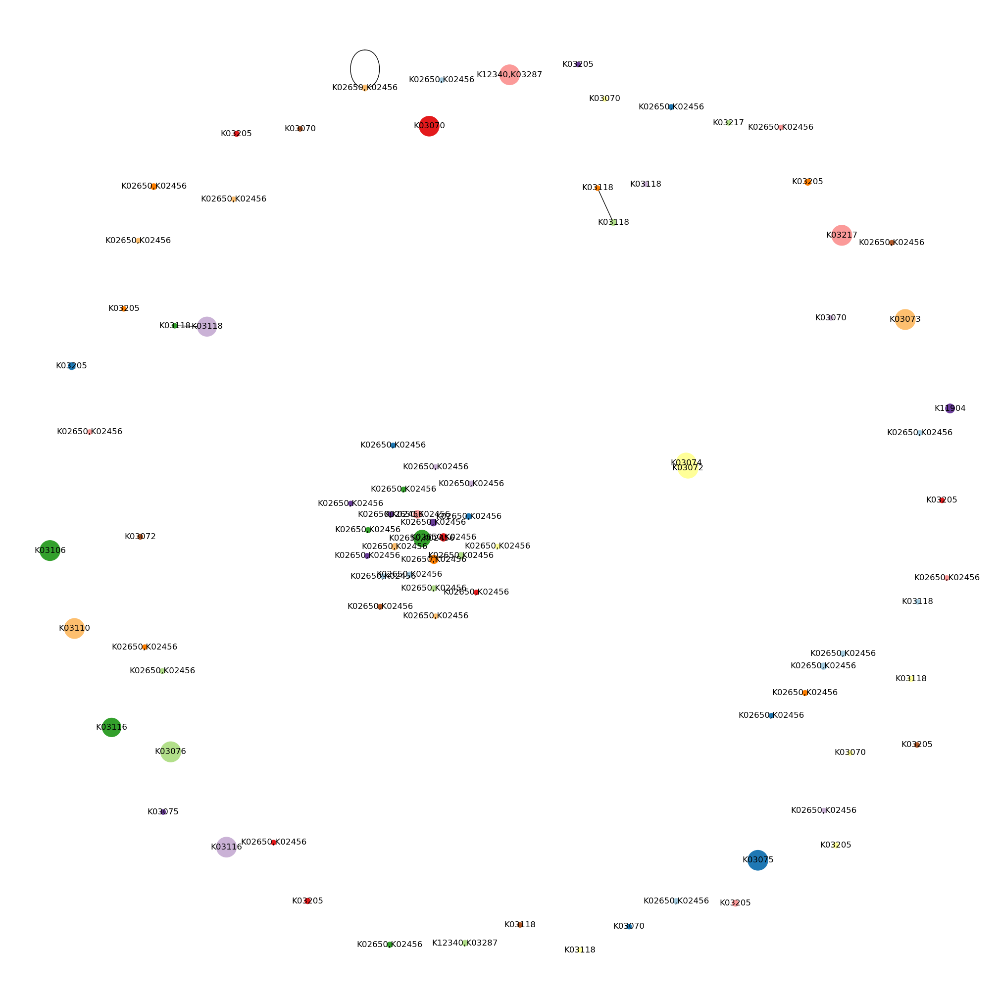

In [53]:
BBS_G = nx.Graph()
BBS_G.add_nodes_from(BBS_node_t) 
#BBS_G.add_nodes_from(BBS_node_tnei) 
BBS_weight_min = min(list(BBS_edge_t.values()) + list(BBS_edge_ex.values())) #list(BBS_edge_tnei.values())
BBS_weight_max = max(list(BBS_edge_t.values()) + list(BBS_edge_ex.values())) #+ list(BBS_edge_tnei.values())
BBS_node_min = min([id_pro_len[i] for i in (BBS_node_t + BBS_node_tC)]) #+ BBS_node_tnei
BBS_node_max = max([id_pro_len[i] for i in (BBS_node_t + BBS_node_tC)]) #+ BBS_node_tnei
#BBS_node_max = min(162, max([id_pro_len[i] for i in (BBS_node_t + BBS_node_tnei + BBS_node_tC)]))
for edge, w in BBS_edge_origin.items():
    BBS_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl='o') 
for edge, w in BBS_edge_pre.items():
    BBS_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'e') 
#for edge, w in BBS_edge_ex.items():
    #BBS_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'C') 
#for edge, w in BBS_edge_tnei.items():
#    BBS_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'n') 
    
nx.set_node_attributes(BBS_G, id_BBS_dict_G, 'fun_name')
nx.set_node_attributes(BBS_G, id_C, 'C')
nx.set_node_attributes(BBS_G, id_pro_len, 'pro_len')
#nx.set_node_attributes(BBS_G, id_type, 'C_type')
node_labels = nx.get_node_attributes(BBS_G, 'fun_name')
print('number of nodes: ', BBS_G.number_of_nodes())
print('number of edges: ', BBS_G.number_of_edges())

eorigin=[(u,v) for (u,v,d) in BBS_G.edges(data=True) if d['cl'] == 'o']
eex=[(u,v) for (u,v,d) in BBS_G.edges(data=True) if d['cl'] == 'e']
eC=[(u,v) for (u,v,d) in BBS_G.edges(data=True) if d['cl'] == 'C']
enei=[(u,v) for (u,v,d) in BBS_G.edges(data=True) if d['cl'] == 'n']

BBS_G_connected_node = list()
for c in nx.connected_components(BBS_G):
    nodeSet = BBS_G.subgraph(c).nodes()
    BBS_G_connected_node.append(nodeSet)
print('number of subgraBBS: ', len(BBS_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(BBS_C_t)) 
node_color = [color_palette[BBS_C_t.index(node[1]['C'])] for node in BBS_G.nodes()(data=True)]
node_size = [50 + 950*(node[1]['pro_len'] - BBS_node_min)/(BBS_node_max - BBS_node_min)  for node in BBS_G.nodes()(data=True)]
pos = nx.spring_layout(BBS_G, k=0.2) #,iterations=50
#pos = nx.kamada_kawai_layout(BBS_G)
width_normal = [1 + 5*(float(abs(d['weight'])) - BBS_weight_min)/(BBS_weight_max -BBS_weight_min) for (u,v,d) in BBS_G.edges()(data=True)]
nx.draw(BBS_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        edgelist=eorigin,
        node_color=node_color,
        width=width_normal
       )
#nx.draw_networkx_edge_labels(BBS_pred_G, pos, label_pos=0.5,  rotate=False, font_size=8)
#nx.draw_networkx_edges(BBS_G,pos,edgelist=eex,style = ':',
#                      width= width_normal, alpha=1
 #                     )
#nx.draw_networkx_edges(BBS_G,pos,edgelist=eC,style = '--',
#                      width= width_normal, alpha=1
 #                     )
#nx.draw_networkx_edges(BBS_G,pos,edgelist=enei,style = '--',
#                      width= width_normal, alpha=0.8
#                      )

number of nodes:  106
number of edges:  621
number of PPI C:  25
number of subgraBBS:  1


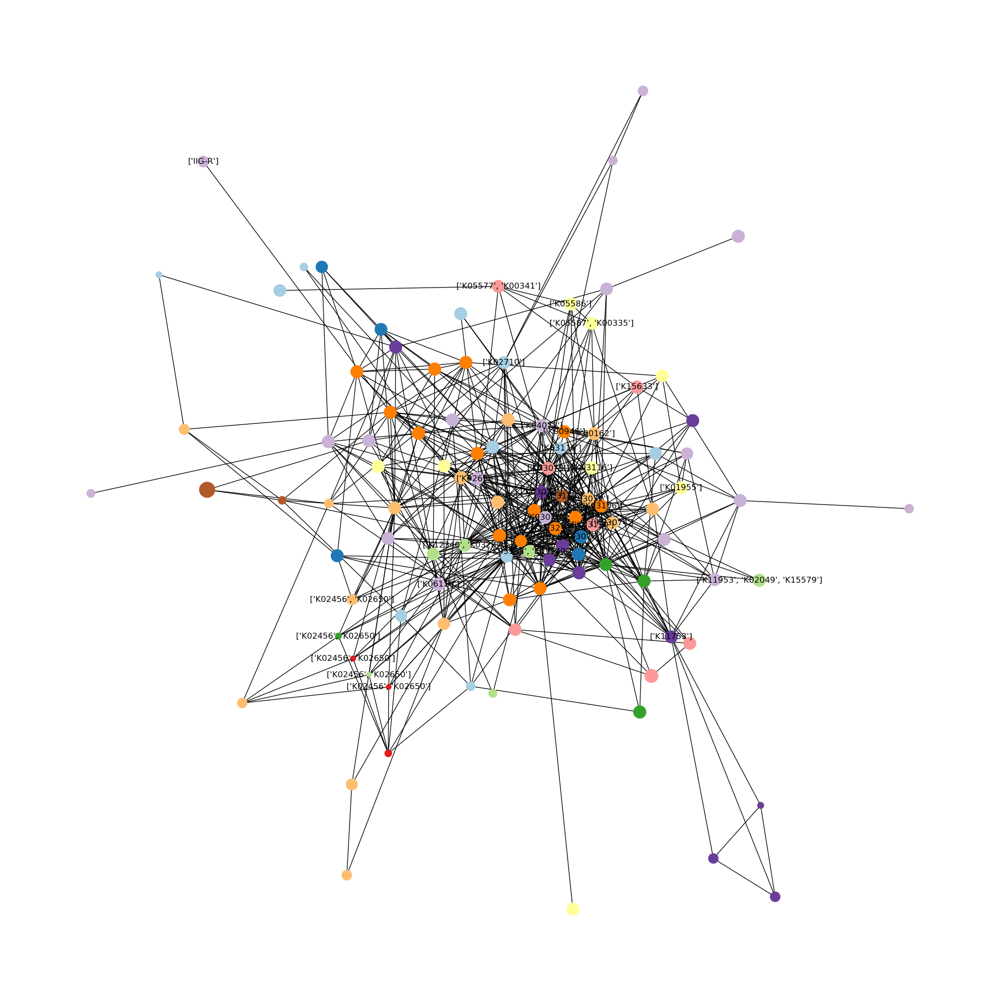

In [54]:
PPI_id_BBS_df = PPI_id_df[(PPI_id_df['C_1'].isin(BBS_C_t)) & (PPI_id_df['C_2'].isin(BBS_C_t))].reset_index(drop=True)
BBS_C_PPI_edge_t = PPI_id_BBS_df.set_index(['node1','node2']).to_dict()['weight']
BBS_C_PPI_node = list(set([str(i) for i in PPI_id_BBS_df['node1'].tolist()] + [str(i) for i in PPI_id_BBS_df['node2'].tolist()]))
BBS_C_PPI_t = list(set([id_C[i] for i in BBS_C_PPI_node]))
BBS_PPI_G = nx.Graph()
#BBS_PPI_G.add_nodes_from(BBS_C_PPI_node) 
BBS_PPI_node_min = min([id_pro_len[i] for i in (BBS_C_PPI_node)])
BBS_PPI_node_max = max([id_pro_len[i] for i in (BBS_C_PPI_node)]) 
for edge, w in BBS_C_PPI_edge_t.items():
    BBS_PPI_G.add_edge(str(edge[0]), str(edge[1]), weight = w)   
nx.set_node_attributes(BBS_PPI_G, label_dict, 'fun_name')
nx.set_node_attributes(BBS_PPI_G, id_C, 'C')
nx.set_node_attributes(BBS_PPI_G, id_pro_len, 'pro_len')
node_labels = nx.get_node_attributes(BBS_PPI_G, 'fun_name')
print('number of nodes: ', BBS_PPI_G.number_of_nodes())
print('number of edges: ', BBS_PPI_G.number_of_edges())
print('number of PPI C: ', len(BBS_C_PPI_t))


BBS_PPI_G_connected_node = list()
for c in nx.connected_components(BBS_PPI_G):
    nodeSet = BBS_PPI_G.subgraph(c).nodes()
    BBS_PPI_G_connected_node.append(nodeSet)
print('number of subgraBBS: ', len(BBS_PPI_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(BBS_C_PPI_t)) 
node_color = [color_palette[BBS_C_PPI_t.index(node[1]['C'])] for node in BBS_PPI_G.nodes()(data=True)]
node_size = [50 + 450*(node[1]['pro_len'] - BBS_PPI_node_min)/(BBS_PPI_node_max - BBS_PPI_node_min)  for node in BBS_PPI_G.nodes()(data=True)]
pos = nx.spring_layout(BBS_PPI_G, k=2) #,iterations=50
#pos = nx.kamada_kawai_layout(BBS_PPI_G)
nx.draw(BBS_PPI_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        node_color=node_color,
       )

### 胞外多糖 EPS

In [118]:
pro_EPS_dict = {}
with open('../function/EPS_mis.fasta') as f:
    for line in f:
        line = line.strip('\n')
        if line.startswith('>'):
            pro_EPS_dict[line[1:]] = pro_K[line[1:]]
id_EPS_dict = {}
for k, v in pro_EPS_dict.items():
    if pro_id[k] not in id_EPS_dict:
        id_EPS_dict[pro_id[k]] = []
    id_EPS_dict[pro_id[k]]  = list(set(v+id_EPS_dict[pro_id[k]]))
id_EPS_dict = {k:v if len(v) != 0 else ['EPS?'] for k, v in id_EPS_dict.items()}
EPS_id_origin = list(id_EPS_dict.keys())
C_EPS_dict = {}
C_EPS_value_dict = {}
C_EPS_count_dict = {}
for k, v in id_EPS_dict.items():
    if id_C[k] not in C_EPS_dict:
        C_EPS_dict[id_C[k]] = []
        C_EPS_value_dict[id_C[k]] = []
    C_EPS_dict[id_C[k]] = list(set(C_EPS_dict[id_C[k]] + v))
    C_EPS_value_dict[id_C[k]] = C_EPS_value_dict[id_C[k]] + v
C_EPS_count_dict = {k:dict(Counter(v)) for k, v in C_EPS_value_dict.items()}
print('EPS pro count: ', len(pro_EPS_dict))
print('EPS node count: ',len(id_EPS_dict))
print('EPS C count: ',len(C_EPS_dict))

EPS_pred_df = pd.read_csv('../function/EPS_pred.txt', sep='\t', header=None)
EPS_pred_df = EPS_pred_df[EPS_pred_df[1].isin(pro_EPS_dict)]
EPS_pred_df['id_1'] = EPS_pred_df[0].apply(lambda x:pro_id[x])
EPS_pred_df['id_2'] = EPS_pred_df[1].apply(lambda x:pro_id[x])
EPS_pred_df['func'] = EPS_pred_df[1].apply(lambda x: pro_EPS_dict[x])
EPS_pred_f_df = EPS_pred_df[~(EPS_pred_df['id_1'].isin(EPS_id_origin))].loc[:, ['id_1','id_2','func']].drop_duplicates(subset=['id_1','id_2'])
id_EPS_pred_dict = EPS_pred_f_df.set_index('id_1').to_dict()['func']
id_EPS_pred_dict = {k:v if len(v) != 0 else ['EPS?'] for k, v in id_EPS_pred_dict.items()}
#id_EPS_dict.update(id_EPS_pred_dict)

EPS_node_origin = EPS_id_origin
EPS_edge_origin = id_edge_df[(id_edge_df[0].isin(EPS_node_origin))&(id_edge_df[1].isin(EPS_node_origin))].set_index([0,1]).to_dict()[2]
EPS_node_ex = list(id_EPS_pred_dict.keys())
EPS_node_t = list(id_EPS_dict.keys()) + list(id_EPS_pred_dict.keys())
EPS_edge_t_df = id_edge_df[(id_edge_df[0].isin(EPS_node_t))&(id_edge_df[1].isin(EPS_node_t))]
EPS_edge_t = EPS_edge_t_df.set_index([0,1]).to_dict()[2]
EPS_edge_pre = EPS_edge_t_df[(EPS_edge_t_df[0].isin(EPS_node_ex))|(EPS_edge_t_df[1].isin(EPS_node_ex))].set_index([0,1]).to_dict()[2]

EPS_C = list(C_EPS_dict.keys())
EPS_node_oC= [j for i in EPS_C for j in C_id[i] if j not in EPS_node_origin]
EPS_node_tC = [j for i in EPS_C for j in C_id[i] if j not in EPS_node_t]
EPS_edge_df = id_edge_df[(id_edge_df[0].isin(EPS_node_origin+EPS_node_oC))&(id_edge_df[1].isin(EPS_node_origin+EPS_node_oC))]
EPS_edge = EPS_edge_df[(EPS_edge_df[0].isin(EPS_node_oC))|(EPS_edge_df[1].isin(EPS_node_oC))].set_index([0,1]).to_dict()[2]
EPS_edge_ex_df = id_edge_df[(id_edge_df[0].isin(EPS_node_t+EPS_node_tC))&(id_edge_df[1].isin(EPS_node_t+EPS_node_tC))]
EPS_edge_ex = EPS_edge_ex_df[(EPS_edge_ex_df[0].isin(EPS_node_tC))|(EPS_edge_ex_df[1].isin(EPS_node_tC))].set_index([0,1]).to_dict()[2]
EPS_C_t = list(set([id_C[i] for i in EPS_node_t]))
print('EPS ex C count: ',len(EPS_C_t))
print('origin node: ', len(EPS_node_origin))
print('total node: ', len(EPS_node_t))
print('origin edge: ', len(EPS_edge_origin))
print('extend edge: ', len(EPS_edge_pre))
print('total edge: ', len(EPS_edge_t_df))
print('origin C nei node: ', len(EPS_node_oC))
print('origin C nei edge: ', len(EPS_edge_df))
print('total C nei node: ', len(EPS_node_tC))
print('total C nei edge: ', len(EPS_edge_ex_df))

EPS_node_onei = list(set([nei for node in EPS_node_origin for nei in find_nei(proid_G, node)[0]]) - set(EPS_node_origin))
EPS_node_tnei = list(set([nei for node in EPS_node_t for nei in find_nei(proid_G, node)[0]]) - set(EPS_node_t))
EPS_edge_onei_df = id_edge_df[(id_edge_df[0].isin(EPS_node_origin+EPS_node_onei))&(id_edge_df[1].isin(EPS_node_origin+EPS_node_onei))]
#EPS_edge_onei = EPS_edge_onei_df[EPS_edge_onei_df[0].isin(EPS_node_onei) | EPS_edge_onei_df[1].isin(EPS_node_onei)].set_index([0,1]).to_dict()[2]
EPS_edge_tnei_df = id_edge_df[(id_edge_df[0].isin(EPS_node_t+EPS_node_tnei))&(id_edge_df[1].isin(EPS_node_t+EPS_node_tnei))]
#EPS_edge_tnei = EPS_edge_tnei_df[EPS_edge_tnei_df[0].isin(EPS_node_tnei) | EPS_edge_tnei_df[1].isin(EPS_node_tnei)].set_index([0,1]).to_dict()[2]
EPS_GC_t =list(set([id_C[i] for i in EPS_node_t+EPS_node_tnei]))
print('origin  nei node: ', len(EPS_node_onei))
print('origin  nei edge: ', len(EPS_edge_onei_df))
print('total  nei node: ', len(EPS_node_tnei))
print('total  nei edge: ', len(EPS_edge_tnei_df))

EPS_PPI_o_df = PPI_id_df[(PPI_id_df['node1'].isin(EPS_node_origin))&(PPI_id_df['node2'].isin(EPS_node_origin))]
EPS_PPI_t_df = PPI_id_df[(PPI_id_df['node1'].isin(EPS_node_t))&(PPI_id_df['node2'].isin(EPS_node_t))]
EPS_node_o_PPI = list(set(EPS_PPI_o_df['node1'].tolist() + EPS_PPI_o_df['node2'].tolist()))
EPS_node_t_PPI = list(set(EPS_PPI_t_df['node1'].tolist() + EPS_PPI_t_df['node2'].tolist()))
print('PPI orign node: ', len(EPS_node_o_PPI))
print('PPI total node: ', len(EPS_node_t_PPI))
print('PPI orign edge: ', len(EPS_PPI_o_df))
print('PPI total edge: ', len(EPS_PPI_t_df)) 
id_EPS_t_dict = {k:id_EPS_dict[k] if k in id_EPS_dict else id_EPS_pred_dict[k] for k in EPS_node_t}
id_EPS_dict_G = {k:','.join(v) + ' **' if int(k) in EPS_node_t_PPI  else ','.join(v) for k, v in id_EPS_t_dict.items()}

EPS pro count:  1616
EPS node count:  36
EPS C count:  34
EPS ex C count:  61
origin node:  36
total node:  65
origin edge:  0
extend edge:  6
total edge:  6
origin C nei node:  381
origin C nei edge:  228
total C nei node:  380
total C nei edge:  245
origin  nei node:  212
origin  nei edge:  432
total  nei node:  269
total  nei edge:  611
PPI orign node:  11
PPI total node:  12
PPI orign edge:  16
PPI total edge:  18


number of nodes:  65
number of edges:  6
number of subgraEPS:  59


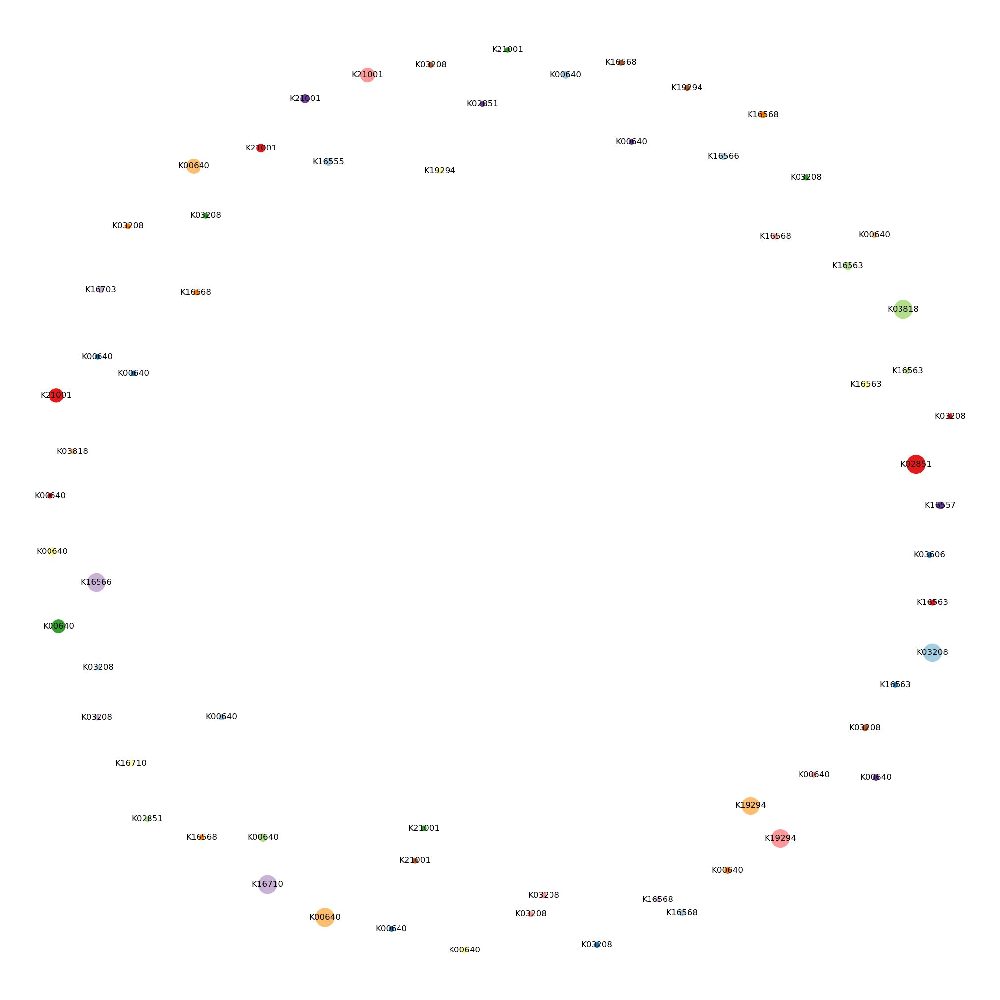

In [119]:
EPS_G = nx.Graph()
EPS_G.add_nodes_from(EPS_node_t) 
#EPS_G.add_nodes_from(EPS_node_tnei) 
EPS_weight_min = min(list(EPS_edge_t.values()) + list(EPS_edge_ex.values())) #list(EPS_edge_tnei.values())
EPS_weight_max = max(list(EPS_edge_t.values()) + list(EPS_edge_ex.values())) #+ list(EPS_edge_tnei.values())
EPS_node_min = min([id_pro_len[i] for i in (EPS_node_t + EPS_node_tC)]) #+ EPS_node_tnei
EPS_node_max = max([id_pro_len[i] for i in (EPS_node_t + EPS_node_tC)]) #+ EPS_node_tnei
#EPS_node_max = min(162, max([id_pro_len[i] for i in (EPS_node_t + EPS_node_tnei + EPS_node_tC)]))
for edge, w in EPS_edge_origin.items():
    EPS_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl='o') 
for edge, w in EPS_edge_pre.items():
    EPS_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'e') 
#for edge, w in EPS_edge_ex.items():
    #EPS_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'C') 
#for edge, w in EPS_edge_tnei.items():
#    EPS_G.add_edge(str(edge[0]), str(edge[1]), weight = w, cl= 'n') 
    
nx.set_node_attributes(EPS_G, id_EPS_dict_G, 'fun_name')
nx.set_node_attributes(EPS_G, id_C, 'C')
nx.set_node_attributes(EPS_G, id_pro_len, 'pro_len')
#nx.set_node_attributes(EPS_G, id_type, 'C_type')
node_labels = nx.get_node_attributes(EPS_G, 'fun_name')
print('number of nodes: ', EPS_G.number_of_nodes())
print('number of edges: ', EPS_G.number_of_edges())

eorigin=[(u,v) for (u,v,d) in EPS_G.edges(data=True) if d['cl'] == 'o']
eex=[(u,v) for (u,v,d) in EPS_G.edges(data=True) if d['cl'] == 'e']
eC=[(u,v) for (u,v,d) in EPS_G.edges(data=True) if d['cl'] == 'C']
enei=[(u,v) for (u,v,d) in EPS_G.edges(data=True) if d['cl'] == 'n']

EPS_G_connected_node = list()
for c in nx.connected_components(EPS_G):
    nodeSet = EPS_G.subgraph(c).nodes()
    EPS_G_connected_node.append(nodeSet)
print('number of subgraEPS: ', len(EPS_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(EPS_C_t)) 
node_color = [color_palette[EPS_C_t.index(node[1]['C'])] for node in EPS_G.nodes()(data=True)]
node_size = [50 + 950*(node[1]['pro_len'] - EPS_node_min)/(EPS_node_max - EPS_node_min)  for node in EPS_G.nodes()(data=True)]
pos = nx.spring_layout(EPS_G, k=0.2) #,iterations=50
#pos = nx.kamada_kawai_layout(EPS_G)
width_normal = [1 + 5*(float(abs(d['weight'])) - EPS_weight_min)/(EPS_weight_max -EPS_weight_min) for (u,v,d) in EPS_G.edges()(data=True)]
nx.draw(EPS_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        edgelist=eorigin,
        node_color=node_color,
        width=width_normal
       )
#nx.draw_networkx_edge_labels(EPS_pred_G, pos, label_pos=0.5,  rotate=False, font_size=8)
#nx.draw_networkx_edges(EPS_G,pos,edgelist=eex,style = ':',
#                      width= width_normal, alpha=1
 #                     )
#nx.draw_networkx_edges(EPS_G,pos,edgelist=eC,style = '--',
#                      width= width_normal, alpha=1
 #                     )
#nx.draw_networkx_edges(EPS_G,pos,edgelist=enei,style = '--',
#                      width= width_normal, alpha=0.8
#                      )

number of nodes:  120
number of edges:  541
number of PPI C:  23
number of subgraEPS:  2


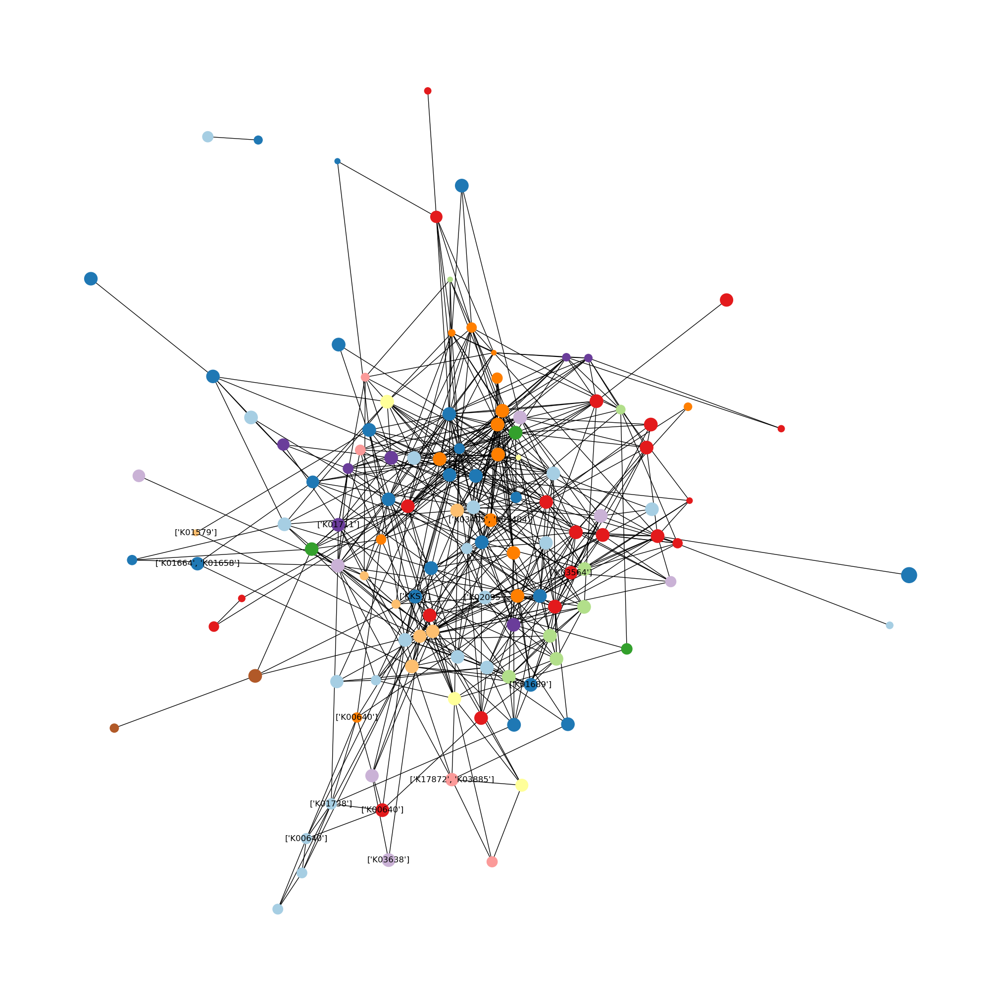

In [120]:
PPI_id_EPS_df = PPI_id_df[(PPI_id_df['C_1'].isin(EPS_C_t)) & (PPI_id_df['C_2'].isin(EPS_C_t))].reset_index(drop=True)
EPS_C_PPI_edge_t = PPI_id_EPS_df.set_index(['node1','node2']).to_dict()['weight']
EPS_C_PPI_node = list(set([str(i) for i in PPI_id_EPS_df['node1'].tolist()] + [str(i) for i in PPI_id_EPS_df['node2'].tolist()]))
EPS_C_PPI_t = list(set([id_C[i] for i in EPS_C_PPI_node]))
EPS_PPI_G = nx.Graph()
#EPS_PPI_G.add_nodes_from(EPS_C_PPI_node) 
EPS_PPI_node_min = min([id_pro_len[i] for i in (EPS_C_PPI_node)])
EPS_PPI_node_max = max([id_pro_len[i] for i in (EPS_C_PPI_node)]) 
for edge, w in EPS_C_PPI_edge_t.items():
    EPS_PPI_G.add_edge(str(edge[0]), str(edge[1]), weight = w)   
nx.set_node_attributes(EPS_PPI_G, label_dict, 'fun_name')
nx.set_node_attributes(EPS_PPI_G, id_C, 'C')
nx.set_node_attributes(EPS_PPI_G, id_pro_len, 'pro_len')
node_labels = nx.get_node_attributes(EPS_PPI_G, 'fun_name')
print('number of nodes: ', EPS_PPI_G.number_of_nodes())
print('number of edges: ', EPS_PPI_G.number_of_edges())
print('number of PPI C: ', len(EPS_C_PPI_t))


EPS_PPI_G_connected_node = list()
for c in nx.connected_components(EPS_PPI_G):
    nodeSet = EPS_PPI_G.subgraph(c).nodes()
    EPS_PPI_G_connected_node.append(nodeSet)
print('number of subgraEPS: ', len(EPS_PPI_G_connected_node))
  
plt.figure(figsize= (20, 20))  
color_palette = sns.color_palette('Paired', n_colors = len(EPS_C_PPI_t)) 
node_color = [color_palette[EPS_C_PPI_t.index(node[1]['C'])] for node in EPS_PPI_G.nodes()(data=True)]
node_size = [50 + 450*(node[1]['pro_len'] - EPS_PPI_node_min)/(EPS_PPI_node_max - EPS_PPI_node_min)  for node in EPS_PPI_G.nodes()(data=True)]
pos = nx.spring_layout(EPS_PPI_G, k=2) #,iterations=50
#pos = nx.kamada_kawai_layout(EPS_PPI_G)
nx.draw(EPS_PPI_G, pos, 
        labels=node_labels,
        #with_labels = True, 
        node_size=node_size,
        node_color=node_color,
       )

In [55]:
C_fun_df = pd.read_csv('C_fun_detail.txt', sep='\t')
C_fun_df

,0,K,ko,M,C_info,K_info,ko_info,M_info,K_num,ko_num,M_num,scale,sec_label,sec_label_info,sec_label_num,fun_gene_num,fun_gene_per,type
0,0,K01533 K07147 K07491 K17686 K02341 K09989 K070...,ko04016 ko03430 ko04978 ko03440 ko00270 ko0303...,M00338 M00609 M00017 M00021 M00035 M00368 M00034,DNA polymerase III subunit delta'***ethyl tert...,copB|P-type Cu2+ transporter [EC:7.2.2.9]***ms...,MAPK signaling pathway - plant***Mismatch repa...,"Cysteine biosynthesis, homocysteine + serine =...",9,8,7,22,"17,18,19,2,29,3,36,4,46,47,6,8,9","Replication and repair,Membrane transport,Sign...",32,8,0.363636,mmp
1,1,K02242,NaN,NaN,ComF family protein***orotate phosphoribosyltr...,comFC|competence protein ComFC,NaN,NaN,1,0,0,2,17,Replication and repair,2,1,0.500000,2sp
2,2,K02722 K06223 K03798,ko03430 ko00195,M00157 M00161 M00162 M00163,DNA adenine methylase family protein***ATP-dep...,psbX|photosystem II PsbX protein***dam|DNA ade...,Mismatch repair***Photosynthesis,"F-type ATPase, prokaryotes and chloroplasts***...",3,2,4,5,"17,3","Replication and repair,Energy metabolism",4,3,0.600000,mmp
3,3,K10822 K19171 K07091 K17892 K11720 K09763 K097...,ko02010,NaN,Similar to tr|P73566|P73566***Ferredoxin-thior...,E7.4.2.2|nonpolar-amino-acid-transporting ATPa...,ABC transporters,NaN,8,1,0,18,"16,18,19,24,3,46,8,9","Folding, sorting and degradation,Membrane tran...",20,6,0.333333,mmp
4,4,K07492 K02650 K07171 K02710 K07486 K01703 K009...,ko03018 ko00010 ko02020 ko00195 ko04066 ko0068...,M00002 M00040 M00024 M00003 M00344 M00570 M001...,mRNA interferase PemK***Enolase (2-phosphoglyc...,K07492|putative transposase***pilA|type IV pil...,RNA degradation***Glycolysis / Gluconeogenesis...,"Glycolysis, core module involving three-carbon...",15,11,35,85,"11,12,15,16,18,19,2,21,24,3,36,39,4,46,5,6,8,9","Biosynthesis of other secondary metabolites,Xe...",46,14,0.164706,mmp
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18064,18064,NaN,NaN,NaN,TIGR04255 family protein,NaN,NaN,NaN,0,0,0,1,6,Amino acid metabolism,1,0,0.000000,1nn
18065,18065,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,1,6,Amino acid metabolism,1,0,0.000000,1nn
18066,18066,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,1,6,Amino acid metabolism,1,0,0.000000,1nn
18067,18067,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,1,2,Carbohydrate metabolism,1,0,0.000000,1nn


In [121]:
C_type = C_fun_df.set_index(['0'])['type'].to_dict()
id_type = {id: C_type[int(C)] for id, C in id_C.items()}
fun_type = ['XM', 'FAM', 'GLY', 'PPP', 'SUM', 'TEVIT', 'MM', 'CCM', 'ROS', 'P', 'AAT', 'AAG', 'AP', 'BBS', 'EPS']
values= ['1nn', '1np', '1sn', '1sp', '1mn', '1mp',
                 '2nn', '2np', '2sn', '2sp', '2mn', '2mp',
                 'mnn', 'mnp', 'msn', 'msp', 'mmn', 'mmp',
                ]
type_matrix = np.zeros((len(fun_type), len(values)))
for k,v in Counter([C_type[int(i)] for i in XM_C]).items():
    type_matrix[0][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in FAM_C]).items():
    type_matrix[1][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in GLY_C]).items():
    type_matrix[2][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in PPP_C]).items():
    type_matrix[3][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in SUM_C]).items():
    type_matrix[4][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in TEVIT_C]).items():
    type_matrix[5][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in MM_C]).items():
    type_matrix[6][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in CCM_C]).items():
    type_matrix[7][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in ROS_C]).items():
    type_matrix[8][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in P_C]).items():
    type_matrix[9][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in AAT_C]).items():
    type_matrix[10][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in AAG_C]).items():
    type_matrix[11][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in AP_C]).items():
    type_matrix[12][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in BBS_C]).items():
    type_matrix[13][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in EPS_C]).items():
    type_matrix[14][values.index(k)] = int(v)
type_df = pd.DataFrame(type_matrix, columns=values, index=fun_type)
type_df['1n'] = type_df['1np']  + type_df['1nn']
type_df['1s'] = type_df['1sp'] +  type_df['1sn']
type_df['1m'] = type_df['1mp'] +  type_df['1mn']
type_df['2n'] = type_df['2np']  + type_df['2nn']
type_df['2s'] = type_df['2sp'] +  type_df['2sn']
type_df['2m'] = type_df['2mp'] +  type_df['2mn']
type_df['mn'] = type_df['mnp']  + type_df['mnn']
type_df['ms'] = type_df['msp'] +  type_df['msn']
type_df['mm'] = type_df['mmp'] +  type_df['mmn']
type_df['1'] = type_df['1np'] + type_df['1sp'] + type_df['1mp'] + type_df['1nn'] + type_df['1sn'] + type_df['1mn']
type_df['2'] = type_df['2np'] + type_df['2sp'] + type_df['2mp'] + type_df['2nn'] + type_df['2sn'] + type_df['2mn']
type_df['m'] = type_df['mnp'] + type_df['msp'] + type_df['mmp'] + type_df['mnn'] + type_df['msn'] + type_df['mmn']
type_df['C_n'] = type_df['1n'] + type_df['2n'] + type_df['mn']
type_df['C_s'] = type_df['1s'] + type_df['2s'] + type_df['ms']
type_df['C_m'] = type_df['1m'] + type_df['2m'] + type_df['mm']
type_df['percent'] = type_df['C_s']/(type_df['C_m']+type_df['C_s'])

In [122]:
type_old_df = pd.read_csv('type_old.csv', sep='\t')
type_old_df = type_old_df.set_index('Unnamed: 0')
type_all_df = pd.concat([type_old_df, type_df])
type_all_df['1_p'] = type_all_df['1np'] + type_all_df['1sp'] + type_all_df['1mp']
type_all_df['2_p'] = type_all_df['2np'] + type_all_df['2sp'] + type_all_df['2mp']
type_all_df['m_p'] = type_all_df['mnp'] + type_all_df['msp'] + type_all_df['mmp']
type_all_df['P'] = type_all_df['1_p'] + type_all_df['2_p'] + type_all_df['m_p']
type_all_df['t'] = type_all_df['C_n'] + type_all_df['C_s'] + type_all_df['C_m']
type_all_df['P_percent'] = type_all_df['P']/(type_all_df['t'])
type_all_df['1_percent'] = type_all_df['1']/(type_all_df['t'])
type_all_df['f_pattern'] = type_all_df['percent'].apply(lambda x: 'con' if x < 0.4 else ('ind' if x > 0.55 else 'b'))
type_all_df['p_pattern'] = type_all_df['P_percent'].apply(lambda x: 'in' if x < 0.4 else ('out' if x > 0.55 else 'b'))
type_all_df['c_pattern'] = type_all_df['1_percent'].apply(lambda x: 'mul' if x < 0.13 else ('sin' if x > 0.26 else 'b'))
type_all_df                                                    

,1np,1sp,1mp,2np,2sp,2mp,mnp,msp,mmp,1nn,1sn,1mn,2nn,2sn,2mn,mnn,msn,mmn,1n,1s,1m,2n,2s,2m,mn,ms,mm,1,2,m,C_n,C_s,C_m,percent,1_p,2_p,m_p,P,t,P_percent,1_percent,f_pattern,p_pattern,c_pattern
gvp,0.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,3.0,2.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,4.0,3.0,3.0,2.0,0.0,10.0,6.0,3.0,3.0,0.500000,0.0,0.0,7.0,7.0,12.0,0.583333,0.166667,b,out,b
HM,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,22.0,7.0,7.0,0.0,3.0,3.0,2.0,0.0,3.0,3.0,7.0,7.0,0.0,3.0,4.0,3.0,0.0,4.0,25.0,14.0,10.0,29.0,10.0,15.0,28.0,0.348837,0.0,2.0,23.0,25.0,53.0,0.471698,0.264151,con,b,sin
KKS,0.0,2.0,0.0,0.0,1.0,0.0,0.0,2.0,14.0,0.0,6.0,0.0,0.0,1.0,0.0,0.0,2.0,3.0,0.0,8.0,0.0,0.0,2.0,0.0,0.0,4.0,17.0,8.0,2.0,21.0,0.0,14.0,17.0,0.451613,2.0,1.0,16.0,19.0,31.0,0.612903,0.258065,b,out,b
CF,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,17.0,0.0,6.0,1.0,0.0,3.0,0.0,0.0,0.0,1.0,0.0,6.0,1.0,0.0,4.0,0.0,0.0,1.0,18.0,7.0,4.0,19.0,0.0,11.0,19.0,0.366667,0.0,1.0,18.0,19.0,30.0,0.633333,0.233333,con,out,b
OP,0.0,0.0,0.0,0.0,0.0,1.0,0.0,5.0,29.0,0.0,6.0,0.0,0.0,2.0,0.0,0.0,1.0,1.0,0.0,6.0,0.0,0.0,2.0,1.0,0.0,6.0,30.0,6.0,3.0,36.0,0.0,14.0,31.0,0.311111,0.0,1.0,34.0,35.0,45.0,0.777778,0.133333,con,out,b
TCA,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,11.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,1.0,0.0,0.0,1.0,11.0,2.0,1.0,12.0,0.0,4.0,11.0,0.266667,0.0,1.0,12.0,13.0,15.0,0.866667,0.133333,con,out,b
PH,0.0,2.0,0.0,0.0,1.0,3.0,0.0,6.0,65.0,0.0,11.0,4.0,0.0,5.0,6.0,0.0,3.0,13.0,0.0,13.0,4.0,0.0,6.0,9.0,0.0,9.0,78.0,17.0,15.0,87.0,0.0,28.0,91.0,0.235294,2.0,4.0,71.0,77.0,119.0,0.647059,0.142857,con,out,b
N,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,17.0,0.0,4.0,0.0,0.0,2.0,0.0,0.0,0.0,1.0,0.0,5.0,0.0,0.0,3.0,0.0,0.0,1.0,18.0,5.0,3.0,19.0,0.0,9.0,18.0,0.333333,1.0,1.0,18.0,20.0,27.0,0.740741,0.185185,con,out,b
S,0.0,0.0,1.0,0.0,0.0,2.0,0.0,1.0,22.0,0.0,5.0,4.0,0.0,1.0,0.0,0.0,2.0,3.0,0.0,5.0,5.0,0.0,1.0,2.0,0.0,3.0,25.0,10.0,3.0,28.0,0.0,9.0,32.0,0.219512,1.0,2.0,23.0,26.0,41.0,0.634146,0.243902,con,out,b
cas,0.0,0.0,0.0,1.0,0.0,1.0,1.0,3.0,14.0,10.0,28.0,1.0,4.0,7.0,0.0,3.0,14.0,11.0,10.0,28.0,1.0,5.0,7.0,1.0,4.0,17.0,25.0,39.0,13.0,46.0,19.0,52.0,27.0,0.658228,0.0,2.0,18.0,20.0,98.0,0.204082,0.397959,ind,in,sin


In [58]:
type_all_clu_df = type_all_df.loc[:, ['percent', 'P_percent','1_percent']]
k = 3   #聚类的类别
iteration = 500  #聚类最大循环次数
type_all_clu_zs_df = 1.0*(type_all_clu_df-type_all_clu_df.mean())/type_all_clu_df.std()   #数据标准化
model = KMeans(n_clusters = k, max_iter = iteration, random_state = 1234) #分类为k，并发数为4
model.fit(type_all_clu_zs_df)
r1 = pd.Series(model.labels_).value_counts()  #统计各类别数目
r2 = pd.DataFrame(model.cluster_centers_)  #找出聚类中心
r = pd.concat([type_all_clu_df, pd.Series(model.labels_,index =type_all_clu_df.index)],axis =1)
r.columns = list(type_all_clu_df.columns) + ['pattern_clu']
r

,percent,P_percent,1_percent,pattern_clu
gvp,0.500000,0.583333,0.166667,1
HM,0.348837,0.471698,0.264151,1
KKS,0.451613,0.612903,0.258065,1
CF,0.366667,0.633333,0.233333,1
OP,0.311111,0.777778,0.133333,2
TCA,0.266667,0.866667,0.133333,2
PH,0.235294,0.647059,0.142857,2
N,0.333333,0.740741,0.185185,2
S,0.219512,0.634146,0.243902,1
cas,0.658228,0.204082,0.397959,0


In [123]:
label_dict = {}
with open('label_dict.old.txt') as f:
    for line in f:
        line = line.strip('\n')
        label_dict[line.split('\t')[0]] = line.split('\t')[1].split(',')

In [124]:
label_list = [id_XM_t_dict, id_FAM_t_dict,id_GLY_t_dict,id_PPP_t_dict,
              id_SUM_t_dict,id_TEVIT_t_dict,id_MM_t_dict,id_CCM_t_dict,
              id_ROS_t_dict,id_P_t_dict,id_AAT_t_dict,id_AAG_t_dict,
              id_AP_t_dict,id_BBS_t_dict, id_EPS_t_dict]
for i in label_list:
    for k, v in i.items():
        if k not in label_dict:
            label_dict[k] = []
        label_dict[k] += v
label_dict = {k:list(set(v)) for k, v in label_dict.items()}

In [125]:
w_f = open('label_dict.t.txt', 'w+')
for k, v in label_dict.items():
    w_f.write(k + '\t' + ','.join(v) + '\n')
w_f.close()

In [126]:
C_type = C_fun_df.set_index(['0'])['type'].to_dict()
id_type = {id: C_type[int(C)] for id, C in id_C.items()}
fun_type = ['XM', 'FAM', 'GLY', 'PPP', 'SUM', 'TEVIT', 'MM', 'CCM', 'ROS', 'P', 'AAT',  'AAG', 'AP', 'BBS', 'EPS']
values= ['1nn', '1np', '1sn', '1sp', '1mn', '1mp',
                 '2nn', '2np', '2sn', '2sp', '2mn', '2mp',
                 'mnn', 'mnp', 'msn', 'msp', 'mmn', 'mmp',
                ]
type_t_matrix = np.zeros((len(fun_type), len(values)))
for k,v in Counter([C_type[int(i)] for i in XM_C_t]).items():
    type_t_matrix[0][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in FAM_C_t]).items():
    type_t_matrix[1][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in GLY_C_t]).items():
    type_t_matrix[2][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in PPP_C_t]).items():
    type_t_matrix[3][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in SUM_C_t]).items():
    type_t_matrix[4][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in TEVIT_C_t]).items():
    type_t_matrix[5][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in MM_C_t]).items():
    type_t_matrix[6][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in CCM_C_t]).items():
    type_t_matrix[7][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in ROS_C_t]).items():
    type_t_matrix[8][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in P_C_t]).items():
    type_t_matrix[9][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in AAT_C_t]).items():
    type_t_matrix[10][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in AAG_C_t]).items():
    type_t_matrix[11][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in AP_C_t]).items():
    type_t_matrix[12][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in BBS_C_t]).items():
    type_t_matrix[13][values.index(k)] = int(v)
for k,v in Counter([C_type[int(i)] for i in EPS_C_t]).items():
    type_t_matrix[13][values.index(k)] = int(v)
type_t_df = pd.DataFrame(type_t_matrix, columns=values, index=fun_type)
type_t_df['1n'] = type_t_df['1np']  + type_t_df['1nn']
type_t_df['1s'] = type_t_df['1sp'] +  type_t_df['1sn']
type_t_df['1m'] = type_t_df['1mp'] +  type_t_df['1mn']
type_t_df['2n'] = type_t_df['2np']  + type_t_df['2nn']
type_t_df['2s'] = type_t_df['2sp'] +  type_t_df['2sn']
type_t_df['2m'] = type_t_df['2mp'] +  type_t_df['2mn']
type_t_df['mn'] = type_t_df['mnp']  + type_t_df['mnn']
type_t_df['ms'] = type_t_df['msp'] +  type_t_df['msn']
type_t_df['mm'] = type_t_df['mmp'] +  type_t_df['mmn']
type_t_df['1'] = type_t_df['1np'] + type_t_df['1sp'] + type_t_df['1mp'] + type_t_df['1nn'] + type_t_df['1sn'] + type_t_df['1mn']
type_t_df['2'] = type_t_df['2np'] + type_t_df['2sp'] + type_t_df['2mp'] + type_t_df['2nn'] + type_t_df['2sn'] + type_t_df['2mn']
type_t_df['m'] = type_t_df['mnp'] + type_t_df['msp'] + type_t_df['mmp'] + type_t_df['mnn'] + type_t_df['msn'] + type_t_df['mmn']
type_t_df['C_n'] = type_t_df['1n'] + type_t_df['2n'] + type_t_df['mn']
type_t_df['C_s'] = type_t_df['1s'] + type_t_df['2s'] + type_t_df['ms']
type_t_df['C_m'] = type_t_df['1m'] + type_t_df['2m'] + type_t_df['mm']
type_t_df['1_p'] = type_t_df['1np'] + type_t_df['1sp'] + type_t_df['1mp']
type_t_df['2_p'] = type_t_df['2np'] + type_t_df['2sp'] + type_t_df['2mp']
type_t_df['m_p'] = type_t_df['mnp'] + type_t_df['msp'] + type_t_df['mmp']
type_t_df['P'] = type_t_df['1_p'] + type_t_df['2_p'] + type_t_df['m_p']
type_t_df['t'] = type_t_df['C_n'] + type_t_df['C_s'] + type_t_df['C_m']
type_t_df['percent'] = type_t_df['C_s']/(type_t_df['C_m']+type_t_df['C_s'])

In [127]:
type_old_t_df = pd.read_csv('type_old_t.csv', sep='\t')
type_old_t_df = type_old_t_df.set_index('Unnamed: 0')
type_all_t_df = pd.concat([type_old_t_df, type_t_df])
type_all_t_df['pattern'] = type_all_t_df['percent'].apply(lambda x: 'c' if x < 0.3 else ('i' if x > 0.5 else 'b'))
type_all_t_df      

,1np,1sp,1mp,2np,2sp,2mp,mnp,msp,mmp,1nn,1sn,1mn,2nn,2sn,2mn,mnn,msn,mmn,1n,1s,1m,2n,2s,2m,mn,ms,mm,1,2,m,C_n,C_s,C_m,percent,1_p,2_p,m_p,P,t,pattern
gvp,0.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,3.0,2.0,0.0,0.0,0.0,0.0,0.0,4.0,1.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,5.0,4.0,3.0,2.0,0.0,12.0,7.0,4.0,3.0,0.571429,NaN,NaN,NaN,NaN,NaN,i
HM,0.0,0.0,0.0,0.0,1.0,3.0,0.0,1.0,28.0,12.0,8.0,1.0,4.0,4.0,3.0,0.0,3.0,3.0,12.0,8.0,1.0,4.0,5.0,6.0,0.0,4.0,31.0,21.0,15.0,35.0,16.0,17.0,38.0,0.309091,NaN,NaN,NaN,NaN,NaN,b
KKS,0.0,2.0,0.0,0.0,1.0,0.0,0.0,3.0,15.0,2.0,6.0,0.0,0.0,3.0,0.0,0.0,2.0,4.0,2.0,8.0,0.0,0.0,4.0,0.0,0.0,5.0,19.0,10.0,4.0,24.0,2.0,17.0,19.0,0.472222,NaN,NaN,NaN,NaN,NaN,b
CF,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,17.0,3.0,6.0,1.0,1.0,3.0,0.0,1.0,0.0,2.0,3.0,6.0,1.0,1.0,4.0,0.0,1.0,1.0,19.0,10.0,5.0,21.0,5.0,11.0,20.0,0.354839,NaN,NaN,NaN,NaN,NaN,b
OP,0.0,0.0,0.0,0.0,0.0,1.0,0.0,5.0,32.0,5.0,6.0,0.0,1.0,3.0,0.0,0.0,1.0,1.0,5.0,6.0,0.0,1.0,3.0,1.0,0.0,6.0,33.0,11.0,5.0,39.0,6.0,15.0,34.0,0.306122,NaN,NaN,NaN,NaN,NaN,b
TCA,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,11.0,1.0,2.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,2.0,0.0,0.0,1.0,0.0,1.0,1.0,12.0,3.0,1.0,14.0,2.0,4.0,12.0,0.250000,NaN,NaN,NaN,NaN,NaN,c
PH,0.0,2.0,0.0,1.0,1.0,3.0,0.0,7.0,72.0,18.0,11.0,4.0,3.0,7.0,6.0,7.0,5.0,15.0,18.0,13.0,4.0,4.0,8.0,9.0,7.0,12.0,87.0,35.0,21.0,106.0,29.0,33.0,100.0,0.248120,NaN,NaN,NaN,NaN,NaN,c
N,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,18.0,6.0,4.0,0.0,1.0,2.0,0.0,2.0,1.0,1.0,6.0,5.0,0.0,1.0,3.0,0.0,2.0,2.0,19.0,11.0,4.0,23.0,9.0,10.0,19.0,0.344828,NaN,NaN,NaN,NaN,NaN,b
S,0.0,0.0,1.0,0.0,0.0,2.0,0.0,1.0,26.0,6.0,5.0,4.0,5.0,1.0,0.0,2.0,4.0,4.0,6.0,5.0,5.0,5.0,1.0,2.0,2.0,5.0,30.0,16.0,8.0,37.0,13.0,11.0,37.0,0.229167,NaN,NaN,NaN,NaN,NaN,c
cas,0.0,0.0,0.0,1.0,0.0,1.0,1.0,3.0,16.0,12.0,29.0,2.0,5.0,7.0,0.0,4.0,14.0,11.0,12.0,29.0,2.0,6.0,7.0,1.0,5.0,17.0,27.0,43.0,14.0,49.0,23.0,53.0,30.0,0.638554,NaN,NaN,NaN,NaN,NaN,i


In [128]:
type_all_t_df['pattern'].value_counts()

pattern
b    18
c     6
i     3
Name: count, dtype: int64

In [130]:
def network_type(G, fun):
    G_lcc = max(nx.connected_components(G), key=len)
    G = G.subgraph(G_lcc).copy()
    
    avg_shortest_path_length = nx.average_shortest_path_length(G)
    clustering_coefficient = nx.average_clustering(G)
    degree_sequence = sorted([d for n, d in G.degree()], reverse=True)
    
    #if avg_shortest_path_length < 2 * np.log(len(G)) / np.log(np.mean(degree_sequence)):
    if avg_shortest_path_length < 2 * np.log(len(G)) / np.log(np.mean(degree_sequence)) and np.mean(degree_sequence) > 10:
        print(fun, "SW")
    elif np.var(degree_sequence) / np.mean(degree_sequence) > 1:
        print(fun, "BA")
    else:
        print(fun, "RN")

In [131]:
fun_type = ['XM', 'FAM', 'GLY', 'PPP', 'SUM', 'TEVIT', 'MM', 'CCM', 'ROS', 'P', 'AAT', 'AAG', 'AP', 'BBS', 'EPS']
for i in fun_type:
    network_type(globals()[i+ '_PPI_G'], i)

XM BA
FAM SW
GLY SW
PPP SW
SUM SW
TEVIT SW
MM SW
CCM BA
ROS BA
P SW
AAT BA
AAG SW
AP BA
BBS SW
EPS BA


In [116]:
def motif_count(fun, G_map):
    #g = gt.Graph(directed=False)
    edge_list = []
    with open(fun + '_PPI_edge.txt') as f:
        for line in f:
            line = line.strip('\n')
            edge_list.append((line.split('\t')[0],line.split('\t')[1]))
    g= Graph(edge_list, hashed=True,hash_type="string",directed=False)
    
    motifs_3 = graph_tool.clustering.motifs(g, 3, motif_list = G_map[:2], return_maps=False)
    motifs_4 = graph_tool.clustering.motifs(g, 4, motif_list = G_map[2:8],return_maps=False)
    motifs_5 = graph_tool.clustering.motifs(g, 5, motif_list = G_map[8:], return_maps=False)
    count = motifs_3[1] + motifs_4[1] + motifs_5[1]
    g_map = motifs_3[0] + motifs_4[0] + motifs_5[0]
    return  count, g_map

In [114]:
edge_list = []
with open('TCA_PPI_edge.txt') as f:
    for line in f:
        line = line.strip('\n')
        edge_list.append((line.split('\t')[0],line.split('\t')[1]))
g= Graph(edge_list, hashed=True,hash_type="string",directed=False)
motifs_3 = graph_tool.clustering.motifs(g, 3,  return_maps=False)
motifs_4 = graph_tool.clustering.motifs(g, 4,  return_maps=False)
motifs_5 = graph_tool.clustering.motifs(g, 5,  return_maps=False)
G_map = motifs_3[0] + motifs_4[0] + motifs_5[0]

In [115]:
G_map

[<Graph object, undirected, with 3 vertices and 2 edges, at 0x7fce36af9ac0>,
 <Graph object, undirected, with 3 vertices and 3 edges, at 0x7fce36af9340>,
 <Graph object, undirected, with 4 vertices and 3 edges, at 0x7fce36af9f10>,
 <Graph object, undirected, with 4 vertices and 3 edges, at 0x7fce36ac75b0>,
 <Graph object, undirected, with 4 vertices and 4 edges, at 0x7fce36ac7970>,
 <Graph object, undirected, with 4 vertices and 4 edges, at 0x7fce36ab7370>,
 <Graph object, undirected, with 4 vertices and 5 edges, at 0x7fce36ac9430>,
 <Graph object, undirected, with 4 vertices and 6 edges, at 0x7fce36ab71f0>,
 <Graph object, undirected, with 5 vertices and 4 edges, at 0x7fce36b208b0>,
 <Graph object, undirected, with 5 vertices and 4 edges, at 0x7fce36ade070>,
 <Graph object, undirected, with 5 vertices and 4 edges, at 0x7fce360f9d00>,
 <Graph object, undirected, with 5 vertices and 5 edges, at 0x7fce36af25b0>,
 <Graph object, undirected, with 5 vertices and 5 edges, at 0x7fce36ade7f0>,

In [135]:
EPS_count,EPS_map = motif_count('EPS')

In [138]:
print('EPS\t'  + '\t'.join([str(i) for i in EPS_count]))

EPS	4462	611	10669	31611	11432	850	2012	417	16315	198865	195559	30531	63872	70303	19121	3129	19238	21956	5390	5489	481	7748	1623	5259	1080	3410	400	915	196


In [99]:
# 从文件中读取边数据
def read_edges_from_file(filename):
    edges = []
    with open(filename, 'r') as file:
        lines = file.readlines()
        for line in lines:
            u, v = line.strip().split('\t')
            edges.append((int(u), int(v)))
    return edges

# 构建graph-tool图
def build_gt_graph(edges):
    G = gt.Graph(directed=False)
    G.add_edge_list(edges)
    return G

# 计算3-5节点motif计数
def compute_motif_counts(G, k):
    motif_counts, motifs = graph_tool.clustering.motifs(G, k, return_maps=True)[1],graph_tool.clustering.motifs(G, k, return_maps=True)[0]
    motif_count_dict = {graph_draw(motif): count for motif, count in zip(motifs, motif_counts)}
    return motif_count_dict

# 将motif计数写入文件
def write_motif_counts_to_file(filename, all_motif_counts):
    # 合并所有图的motif计数字典，以具有相同的键
    merged_counts = {}
    for motif_counts in all_motif_counts:
        for motif, count in motif_counts.items():
            if motif not in merged_counts:
                merged_counts[motif] = [0] * len(all_motif_counts)
            merged_counts[motif] = count

    # 按照motif标准形式的顺序将计数写入文件
    sorted_motifs = sorted(merged_counts.keys())
    with open(filename, 'w') as file:
        for motif_counts in all_motif_counts:
            counts_str = ",".join(str(motif_counts.get(motif, 0)) for motif in sorted_motifs)
            file.write(f"{counts_str}\n")

In [134]:
fun_type = ['XM', 'FAM', 'GLY', 'PPP', 'SUM', 'TEVIT', 'MM', 'CCM', 'ROS', 'P', 'AAT', 'AAG', 'AP', 'BBS', 'EPS']
for i in fun_type[14:]:
    #g = gt.Graph(directed=False)
    w_f = open(i + '_PPI_edge.txt', 'w+')
    for edge in globals()[i+ '_PPI_G'].edges():
        w_f.write(edge[0] + '\t' + edge[1] + '\n')
    w_f.close()

In [2]:
# 从文件中读取网络和motif计数数据
def read_network_motif_counts(filename):
    data = pd.read_csv(filename, header=None, sep='\t')
    data.index = data[0]
    data = data.drop(columns=[0])
    return data

# 对motif计数进行归一化处理
def normalize_motif_counts(data):
    return data.div(data.sum(axis=1), axis=0)

# 绘制折线图
def plot_motif_counts(data):
    plt.figure(figsize=(10, 6))
    color_palette = plt.cm.get_cmap('tab20', len(data.index))  # 获取颜色方案

    for i, network in enumerate(data.index):
        plt.plot(data.columns, data.loc[network], label=network, marker='o', color=color_palette(i))

    plt.xlabel('Motif Type')
    plt.ylabel('Normalized Motif Count')
    #plt.title('Motif Counts for Different Networks')
    plt.legend(bbox_to_anchor=(1.01, 1), loc=0, borderaxespad=0)
    #plt.grid()
    plt.show()

/tmp/ipykernel_97444/3980538788.py:15: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_palette = plt.cm.get_cmap('tab20', len(data.index))  # 获取颜色方案


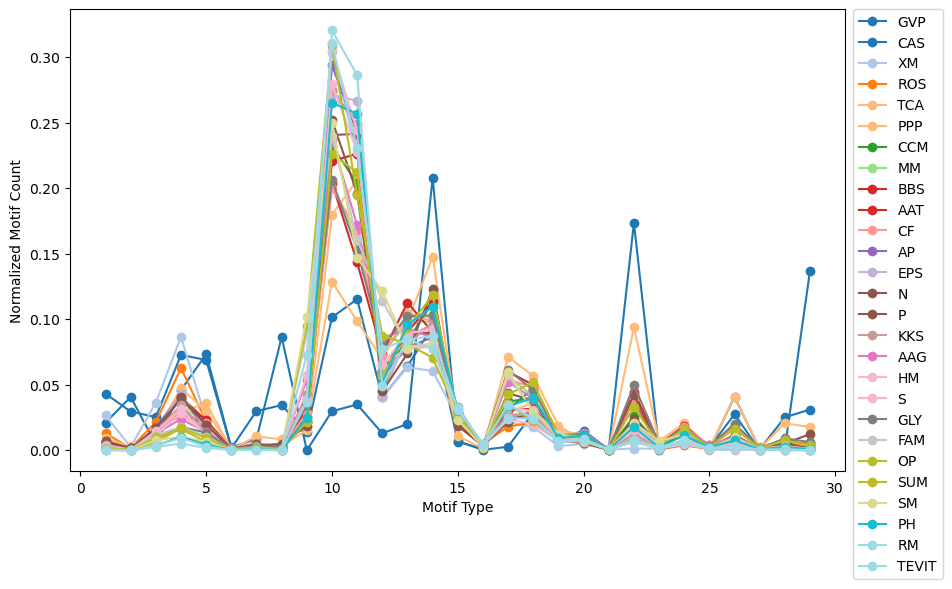

In [4]:
fun_rank = ['GVP', 'CAS', 'XM', 'ROS', 'TCA', 'PPP', 'CCM', 'MM', 'BBS', 'AAT', 'CF', 'AP', 'EPS', 'N', 'P', 'KKS', 'AAG', 'HM', 'S', 'GLY', 'FAM', 'OP', 'SUM', 'SM', 'PH', 'RM', 'TEVIT']
data = read_network_motif_counts('PPI.count.txt')
data = data.loc[fun_rank, :]
normalized_data = normalize_motif_counts(data)
plot_motif_counts(normalized_data)

In [22]:
data = read_network_motif_counts('PPI.count.txt')
data = data.loc[fun_rank, :]
data

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29
0,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
gvp,122,235,27,266,423,13,50,499,0,172,202,75,116,1201,40,2,16,166,49,86,4,1002,3,28,12,159,0,11,792
cas,247,169,145,416,394,9,171,197,80,580,659,231,367,541,38,6,180,269,77,37,0,238,5,90,6,233,5,144,178
XM,448,42,613,1458,388,33,54,3,675,5121,3801,683,1068,1018,413,60,361,296,55,83,10,23,21,73,9,3,10,1,0
ROS,1269,156,2099,6087,2151,151,233,67,2101,26610,24157,4453,8664,8617,2395,501,1743,2086,700,758,51,1059,65,366,110,255,24,40,18
TCA,1915,548,2918,9670,6189,269,1029,719,3114,36797,42188,10337,20053,30227,4034,763,5968,7426,3115,2431,70,8936,241,1688,359,1837,151,845,766
PPP,2608,1173,5121,11076,13416,275,3975,3147,6683,48268,36919,26183,39170,37869,4080,552,26763,21268,7077,2600,97,35165,2675,7736,576,15187,535,7760,6656
CCM,3073,675,7049,18355,9770,527,2195,888,11287,104461,91632,27200,37445,50705,10487,1739,16799,17885,5509,3713,210,11760,1667,5197,901,5095,478,1847,971
MM,4398,1075,12464,26921,18857,1119,4479,2028,26337,168687,134335,61519,81579,82025,23757,2913,47079,34418,9977,11081,812,33462,3992,13962,2611,14934,1153,4863,3489
BBS,6485,1590,21602,44802,33327,1908,8334,3499,50198,332973,233977,120390,183785,147151,46341,5108,97937,81309,19064,19941,1886,72088,7374,30530,5291,31031,3153,13021,6126


In [165]:
id_funtype = {k:[] for k in id_pro.keys()}
fun_type = ['XM', 'FAM', 'GLY', 'PPP', 'SUM', 'TEVIT', 'MM', 'CCM', 'ROS', 'P', 'AAT', 'AAG', 'AP', 'BBS', 'EPS']
for fun in fun_type:
    dict_name = 'id_' + fun + '_dict'
    for id in globals()[dict_name].keys():
        id_funtype[id].append(fun)

In [168]:
w_f = open('id_funtype.txt', 'w+')
for k, v in id_funtype.items():
    w_f.write(k + '\t' + ','.join(v) + '\n')
w_f.close()

In [169]:
for fun in fun_type:
    df_name = 'PPI_id_' + fun  + '_df'
    globals()[df_name].to_csv(df_name, sep='\t', index=None)

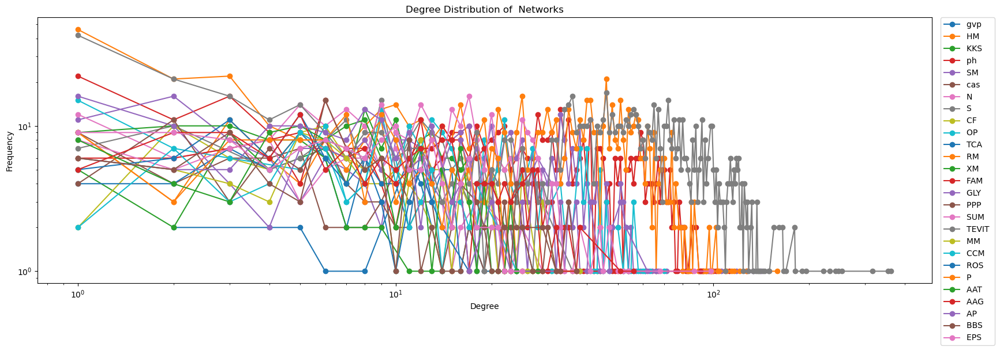

In [178]:
fun_list = ['gvp', 'HM', 'KKS', 'ph', 'SM', 'cas', 'N', 'S', 'CF', 'OP', 'TCA', 'RM', 'XM', 'FAM', 'GLY', 'PPP', 'SUM', 'TEVIT', 'MM', 'CCM', 'ROS', 'P', 'AAT', 'AAG', 'AP', 'BBS', 'EPS']
plt.figure(figsize=(20, 6))
for fun in fun_list:
    file = 'PPI_id_' + fun + '_df'
    # 读取网络数据，每行表示一条边，节点之间用空格分隔
    G = nx.Graph()
    with open(file) as f:
        for line in f:
            if line.startswith('node'):
                continue
            G.add_edge(line.split('\t')[0], line.split('\t')[1])

    # 计算度分布
    degree_sequence = sorted([d for n, d in G.degree()], reverse=True)
    degree_count = {}
    for degree in degree_sequence:
        if degree not in degree_count:
            degree_count[degree] = 0
        degree_count[degree] += 1
    
    # 绘制度分布曲线
    plt.plot(list(degree_count.keys()), list(degree_count.values()), marker='o', linestyle='-', label=f'{fun} ')

# 设置图例、标题和坐标轴标签
plt.legend(bbox_to_anchor=(1.01, 1), loc=0, borderaxespad=0)
plt.title("Degree Distribution of  Networks")
plt.xlabel("Degree")
plt.ylabel("Frequency")
plt.xscale('log')
plt.yscale('log')
# 显示图形
plt.show()

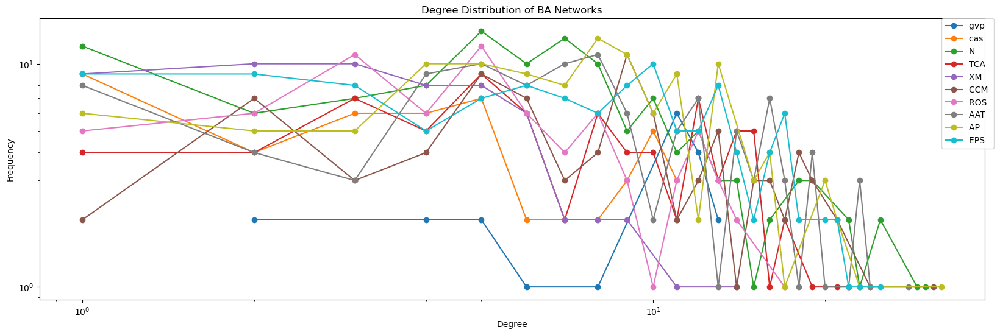

In [179]:
fun_list = ['gvp', 'cas', 'N', 'TCA',  'XM',  'CCM', 'ROS', 'AAT', 'AP', 'EPS']
plt.figure(figsize=(20, 6))
for fun in fun_list:
    file = 'PPI_id_' + fun + '_df'
    # 读取网络数据，每行表示一条边，节点之间用空格分隔
    G = nx.Graph()
    with open(file) as f:
        for line in f:
            if line.startswith('node'):
                continue
            G.add_edge(line.split('\t')[0], line.split('\t')[1])

    # 计算度分布
    degree_sequence = sorted([d for n, d in G.degree()], reverse=True)
    degree_count = {}
    for degree in degree_sequence:
        if degree not in degree_count:
            degree_count[degree] = 0
        degree_count[degree] += 1
    
    # 绘制度分布曲线
    plt.plot(list(degree_count.keys()), list(degree_count.values()), marker='o', linestyle='-', label=f'{fun} ')

# 设置图例、标题和坐标轴标签
plt.legend(bbox_to_anchor=(1.01, 1), loc=0, borderaxespad=0)
plt.title("Degree Distribution of BA Networks")
plt.xlabel("Degree")
plt.ylabel("Frequency")
plt.xscale('log')
plt.yscale('log')
# 显示图形
plt.show()

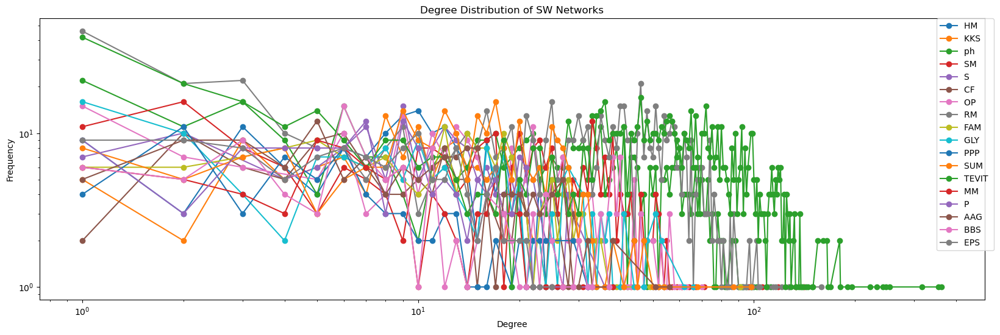

In [180]:
fun_list = ['HM', 'KKS', 'ph', 'SM', 'S', 'CF', 'OP',  'RM', 'FAM', 'GLY', 'PPP', 'SUM', 'TEVIT', 'MM',  'P',  'AAG', 'BBS', 'EPS']
plt.figure(figsize=(20, 6))
for fun in fun_list:
    file = 'PPI_id_' + fun + '_df'
    # 读取网络数据，每行表示一条边，节点之间用空格分隔
    G = nx.Graph()
    with open(file) as f:
        for line in f:
            if line.startswith('node'):
                continue
            G.add_edge(line.split('\t')[0], line.split('\t')[1])

    # 计算度分布
    degree_sequence = sorted([d for n, d in G.degree()], reverse=True)
    degree_count = {}
    for degree in degree_sequence:
        if degree not in degree_count:
            degree_count[degree] = 0
        degree_count[degree] += 1
    
    # 绘制度分布曲线
    plt.plot(list(degree_count.keys()), list(degree_count.values()), marker='o', linestyle='-', label=f'{fun} ')

# 设置图例、标题和坐标轴标签
plt.legend(bbox_to_anchor=(1.01, 1), loc=0, borderaxespad=0)
plt.title("Degree Distribution of SW Networks")
plt.xlabel("Degree")
plt.ylabel("Frequency")
plt.xscale('log')
plt.yscale('log')
# 显示图形
plt.show()